## Import packages

In [ ]:
import os
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import copy
import sys

## Cell name

In [ ]:
# cell_name = 'CL075_230228'
# run_num = ['1', '2', '3']

# cell_name = 'CL079_230324'
# run_num = ['1', '2', '3']

cell_name = 'CL090_230515'
run_num = ['4', '5', '6']

## Read fluorescence dFF structure data

In [ ]:
root_path = "/content/drive/MyDrive/Fluorescence_Data/FluoData4Fitting_Average"

path_ = os.path.join(root_path, cell_name, cell_name + 'red_dFFStructuresrun' + run_num[0] + '.mat')
mat_data = scipy.io.loadmat(path_)
fluo_dFF_runx = mat_data['Master_dFF']
fluo_dFF_runx = fluo_dFF_runx[:, :-1] # delete the last column (49th)
# print(type(fluo_dFF_runx))
# print(fluo_dFF_runx.shape)
# print(fluo_dFF_runx[0,0].shape)

conca_dFF_run4 = np.empty((0,fluo_dFF_runx[0,0].shape[2]))
index_record = []
action = True
while action:
    action = False
    for index, value in np.ndenumerate(fluo_dFF_runx):
        value = np.squeeze(value)
        # print(value.shape)
        # print(value[-31:, :].shape)
        if fluo_dFF_runx.shape[0] == 0:
            fluo_dFF_runx = np.concatenate((fluo_dFF_runx, value), axis=0)
            index_record = index_record + [index]
            action = True
            break
        if np.array_equal(fluo_dFF_runx[:31, :], value[-31:, :]):
            conca_dFF_run4 = np.concatenate((value[:-31, :], fluo_dFF_runx), axis=0)
            index_record = [index] + index_record
            action = True
            break
        if np.array_equal(fluo_dFF_runx[-31:, :], value[:31, :]):
            fluo_dFF_runx = np.concatenate((fluo_dFF_runx, value[31:, :]), axis=0)
            index_record = index_record + [index]
            action = True
            break
print(fluo_dFF_runx.shape)

# arr[:31, :]
# arr[-31:, :]
# [0:31, :]
# [62:93, :]
# data_squeeze = np.squeeze(fluo_dFF_runx[0,0])
# print(data_squeeze.shape)
# empty_array = np.concatenate((empty_array, array1, array2), axis=0)

(1, 48)


## Read pupil data

In [ ]:
root_path = "/content/drive/MyDrive/Fluorescence_Data/FluoData4Fitting_Average"

### Read pupil F

In [ ]:
# fucntion for calculate pre 2s mean, stimulation 2s mean, and post 2s mean
def calculate_means_by_ranges(arr): # input shape is (93, 1, 10)
    range1_mean = np.mean(arr[0:31], axis=0)
    range2_mean = np.mean(arr[31:62], axis=0)
    range3_mean = np.mean(arr[62:93], axis=0)

    # Transpose
    range1_mean = np.transpose(range1_mean)
    range2_mean = np.transpose(range2_mean)
    range3_mean = np.transpose(range3_mean)

    # Combine means into a 10x3 array
    combined_means = np.concatenate((range1_mean, range2_mean, range3_mean), axis=1)

    return combined_means

#### sum/mean along conditions

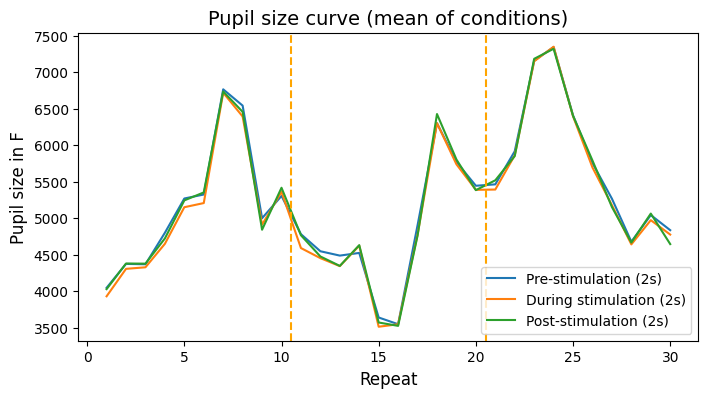

In [ ]:
### read dFF values for pupil size for each run (round)

## run a

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[0] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run4 = mat_data['Master_f']
pupil_area_run4 = pupil_area_run4[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run4):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run4
    pupil_area_run4[index] = value # change original pupil_area_run4
# print(pupil_area_run4.shape)
# print(type(pupil_area_run4))
# print(type(pupil_area_run4[0,1]))
# print(pupil_area_run4[0,1].shape)

# sum and average red data to see the decay
sum_mat_pupil_run4 = np.zeros((pupil_area_run4.shape[0], 1), dtype=np.ndarray)
mean_mat_pupil_run4 = np.zeros((pupil_area_run4.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run4.shape[0]):
    sum = np.zeros((pupil_area_run4[0,0].shape[0], 1))
    for j in range(pupil_area_run4.shape[1]):
        sum = sum + pupil_area_run4[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run4[i, 0] = sum
    mean_mat_pupil_run4[i, 0] = sum / pupil_area_run4.shape[1]


## run b

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[1] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run5 = mat_data['Master_f']
pupil_area_run5 = pupil_area_run5[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run5):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run5
    pupil_area_run5[index] = value # change original pupil_area_run5
# print(pupil_area_run5.shape)
# print(type(pupil_area_run5))
# print(type(pupil_area_run5[0,1]))
# print(pupil_area_run5[0,1].shape)

# sum and average red data to see the decay
sum_mat_pupil_run5 = np.zeros((pupil_area_run5.shape[0], 1), dtype=np.ndarray)
mean_mat_pupil_run5 = np.zeros((pupil_area_run5.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run5.shape[0]):
    sum = np.zeros((pupil_area_run5[0,0].shape[0], 1))
    for j in range(pupil_area_run5.shape[1]):
        sum = sum + pupil_area_run5[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run5[i, 0] = sum
    mean_mat_pupil_run5[i, 0] = sum / pupil_area_run5.shape[1]


## run c

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[2] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run6 = mat_data['Master_f']
pupil_area_run6 = pupil_area_run6[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run6):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run6
    pupil_area_run6[index] = value # change original pupil_area_run6
# print(pupil_area_run6.shape)
# print(type(pupil_area_run6))
# print(type(pupil_area_run6[0,1]))
# print(pupil_area_run6[0,1].shape)

# sum and average red data to see the decay
sum_mat_pupil_run6 = np.zeros((pupil_area_run6.shape[0], 1), dtype=np.ndarray)
mean_mat_pupil_run6 = np.zeros((pupil_area_run6.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run6.shape[0]):
    sum = np.zeros((pupil_area_run6[0,0].shape[0], 1))
    for j in range(pupil_area_run6.shape[1]):
        sum = sum + pupil_area_run6[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run6[i, 0] = sum
    mean_mat_pupil_run6[i, 0] = sum / pupil_area_run6.shape[1]


# print(sum_mat_pupil_run4)
# print(sum_mat_pupil_run5)
# print(sum_mat_pupil_run6)
sum_mat_pupil = np.concatenate((sum_mat_pupil_run4[0,0], sum_mat_pupil_run5[0,0], sum_mat_pupil_run6[0,0]), axis=0)
mean_mat_pupil = np.concatenate((mean_mat_pupil_run4[0,0], mean_mat_pupil_run5[0,0], mean_mat_pupil_run6[0,0]), axis=0)
# print(sum_mat_pupil.T)
# print(mean_mat_pupil.T)


# plot
data = mean_mat_pupil
x = np.arange(1, 31)
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust the figure size as desired
ax.plot(x,data[:, 0], label='Pre-stimulation (2s)')
ax.plot(x,data[:, 1], label='During stimulation (2s)')
ax.plot(x,data[:, 2], label='Post-stimulation (2s)')
ax.legend(fontsize='medium')
ax.set_xlabel('Repeat', fontsize=12)  # Adjust the label size as desired
ax.set_ylabel('Pupil size in F', fontsize=12)  # Adjust the label size as desired
ax.axvline(x=10.5, color='orange', linestyle='--')
ax.axvline(x=20.5, color='orange', linestyle='--')
# ax.text(5, 7200, 'Round 4', ha='center', va='center', fontsize=12) # need to change coordinates specificly
# ax.text(15.5, 7200, 'Round 5', ha='center', va='center', fontsize=12)
# ax.text(25.5, 7200, 'Round 6', ha='center', va='center', fontsize=12)
ax.set_title('Pupil size curve (mean of conditions)', fontsize=14)  # Adjust the title size as desired
ax.tick_params(axis='both', labelsize=10)  # Adjust the tick size as desired
plt.show()


#### sum/mean along repeats

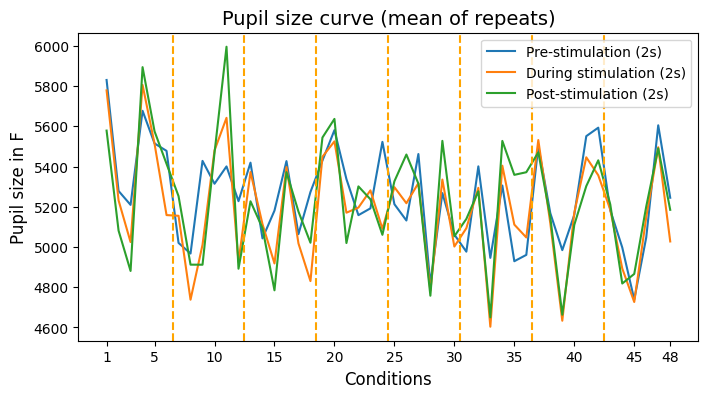

In [ ]:
### read dFF values for pupil size for each run (round)

## run 4

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[0] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run4 = mat_data['Master_f']
pupil_area_run4 = pupil_area_run4[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run4):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run4
    pupil_area_run4[index] = value # change original pupil_area_run4
# print(pupil_area_run4.shape)
# print(type(pupil_area_run4))
# print(type(pupil_area_run4[0,1]))
# print(pupil_area_run4[0,1].shape)

## run 5

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[1] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run5 = mat_data['Master_f']
pupil_area_run5 = pupil_area_run5[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run5):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run5
    pupil_area_run5[index] = value # change original pupil_area_run5
# print(pupil_area_run5.shape)
# print(type(pupil_area_run5))
# print(type(pupil_area_run5[0,1]))
# print(pupil_area_run5[0,1].shape)

## run 6

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[2] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run6 = mat_data['Master_f']
pupil_area_run6 = pupil_area_run6[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run6):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run6
    pupil_area_run6[index] = value # change original pupil_area_run6
# print(pupil_area_run6.shape)
# print(type(pupil_area_run6))
# print(type(pupil_area_run6[0,1]))
# print(pupil_area_run6[0,1].shape)

# stack/concatenate all conditions

# satstackck elements in pupil_area_run4 along the 0th axis
concatenated_run4 = np.stack(pupil_area_run4[0,:], axis=2)
# stack elements in pupil_area_run5 along the 0th axis
concatenated_run5 = np.stack(pupil_area_run5[0,:], axis=2)
# stack elements in pupil_area_run6 along the 0th axis
concatenated_run6 = np.stack(pupil_area_run6[0,:], axis=2)
# Concatenate the results from all three runs along the 1st axis
result = np.concatenate((concatenated_run4, concatenated_run5, concatenated_run6), axis=0)
# print(concatenated_run4.shape)
# print(result.shape)


# plot
data = np.mean(result, axis=0)
x = np.arange(1, 49)
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust the figure size as desired
ax.plot(x,data[0, :], label='Pre-stimulation (2s)')
ax.plot(x,data[1, :], label='During stimulation (2s)')
ax.plot(x,data[2, :], label='Post-stimulation (2s)')
ax.legend(fontsize='medium')
ax.set_xlabel('Conditions', fontsize=12)  # Adjust the label size as desired
ax.set_ylabel('Pupil size in F', fontsize=12)  # Adjust the label size as desired
ax.axvline(x=6.5, color='orange', linestyle='--')
ax.axvline(x=12.5, color='orange', linestyle='--')
ax.axvline(x=18.5, color='orange', linestyle='--')
ax.axvline(x=24.5, color='orange', linestyle='--')
ax.axvline(x=30.5, color='orange', linestyle='--')
ax.axvline(x=36.5, color='orange', linestyle='--')
ax.axvline(x=42.5, color='orange', linestyle='--')
ax.set_title('Pupil size curve (mean of repeats)', fontsize=14)  # Adjust the title size as desired
ax.tick_params(axis='both', labelsize=10)  # Adjust the tick size as desired
# Customize x-axis ticks
tick_positions = [1,5,10,15,20,25,30,35,40,45,48]
plt.xticks(tick_positions)
plt.show()


#### mean for each (condition, repeat)

In [ ]:
### read dFF values for pupil size for each run (round)

## run 4

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[0] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run4 = mat_data['Master_f']
pupil_area_run4 = pupil_area_run4[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run4):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run4
    pupil_area_run4[index] = value # change original pupil_area_run4
# print(pupil_area_run4.shape)
# print(type(pupil_area_run4))
# print(type(pupil_area_run4[0,1]))
# print(pupil_area_run4[0,1].shape)
fine_mean_mat_pupil_run4 = copy.deepcopy(pupil_area_run4)

## run 5

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[1] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run5 = mat_data['Master_f']
pupil_area_run5 = pupil_area_run5[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run5):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run5
    pupil_area_run5[index] = value # change original pupil_area_run5
# print(pupil_area_run5.shape)
# print(type(pupil_area_run5))
# print(type(pupil_area_run5[0,1]))
# print(pupil_area_run5[0,1].shape)
fine_mean_mat_pupil_run5 = copy.deepcopy(pupil_area_run5)

## run 6

# read and calculate the pre 2s mean, stimulation 2s mean, and post 2s mean
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[2] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run6 = mat_data['Master_f']
pupil_area_run6 = pupil_area_run6[:, :-1] # delete the last column (49th)
for index, value in np.ndenumerate(pupil_area_run6):
    value = calculate_means_by_ranges(value) # here, value is a copy, so changing value will not change pupil_area_run6
    pupil_area_run6[index] = value # change original pupil_area_run6
# print(pupil_area_run6.shape)
# print(type(pupil_area_run6))
# print(type(pupil_area_run6[0,1]))
# print(pupil_area_run6[0,1].shape)
fine_mean_mat_pupil_run6 = copy.deepcopy(pupil_area_run6)

# concatenate
fine_mean_mat_pupil = np.concatenate((fine_mean_mat_pupil_run4,
                    fine_mean_mat_pupil_run5,
                    fine_mean_mat_pupil_run6),
                    axis = 0)
print(fine_mean_mat_pupil.shape)
print(fine_mean_mat_pupil[0,1].shape)

(3, 48)
(10, 3)


### Read pupil dFF

<class 'numpy.ndarray'>
(10, 1)
<class 'numpy.ndarray'>
(10, 1)
<class 'numpy.ndarray'>
(10, 1)
[[-1.05138376 -0.13521511  0.22459265 -1.30045993 -0.88000986 -0.73014825
  -0.23684986 -0.75100413 -0.24845973  0.99998111 -1.71898365 -0.59187931
  -0.79403246  1.68797097 -1.13479677  1.79954027 -0.81404467  0.29317292
   0.05337399 -0.22734424 -0.60822942 -0.07015685  0.01182725  0.10699081
   0.14049484 -0.31848347 -0.430526    0.32631886 -0.39290653  0.08752607]]


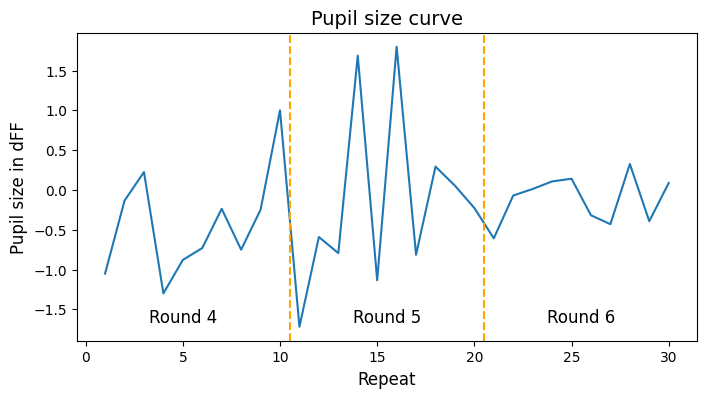

In [ ]:
### read dFF values for pupil size for each run (round)

# run 4
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[0] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run4 = mat_data['Master_dFF_mean']
pupil_area_run4 = pupil_area_run4[:, :-1]
print(type(pupil_area_run4[0,1]))
print(pupil_area_run4[0,1].shape)
# sum red data to see the decay
sum_mat_pupil_run4 = np.zeros((pupil_area_run4.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run4.shape[0]):
    sum = np.zeros((pupil_area_run4[0,0].shape[0], 1))
    for j in range(pupil_area_run4.shape[1]):
        sum = sum + pupil_area_run4[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run4[i, 0] = sum

# run 5
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[1] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run5 = mat_data['Master_dFF_mean']
pupil_area_run5 = pupil_area_run5[:, :-1]
print(type(pupil_area_run5[0,1]))
print(pupil_area_run5[0,1].shape)
# sum red data to see the decay
sum_mat_pupil_run5 = np.zeros((pupil_area_run5.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run5.shape[0]):
    sum = np.zeros((pupil_area_run5[0,0].shape[0], 1))
    for j in range(pupil_area_run5.shape[1]):
        sum = sum + pupil_area_run5[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run5[i, 0] = sum

# run 6
path_ = os.path.join(root_path, cell_name, cell_name + 'green_PupilArea_Run' + run_num[2] + '.mat')
mat_data = scipy.io.loadmat(path_)
pupil_area_run6 = mat_data['Master_dFF_mean']
pupil_area_run6 = pupil_area_run6[:, :-1]
print(type(pupil_area_run6[0,1]))
print(pupil_area_run6[0,1].shape)
# sum red data to see the decay
sum_mat_pupil_run6 = np.zeros((pupil_area_run6.shape[0], 1), dtype=np.ndarray)
for i in range(pupil_area_run6.shape[0]):
    sum = np.zeros((pupil_area_run6[0,0].shape[0], 1))
    for j in range(pupil_area_run6.shape[1]):
        sum = sum + pupil_area_run6[i,j]
    # print(np.sum(sum))
    sum_mat_pupil_run6[i, 0] = sum


# print(sum_mat_pupil_run4)
# print(sum_mat_pupil_run5)
# print(sum_mat_pupil_run6)
sum_mat_pupil = np.concatenate((sum_mat_pupil_run4[0,0], sum_mat_pupil_run5[0,0], sum_mat_pupil_run6[0,0]), axis=0)
print(sum_mat_pupil.T)


data = sum_mat_pupil
x = np.arange(1, 31)
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust the figure size as desired
ax.plot(x, data)
ax.set_xlabel('Repeat', fontsize=12)  # Adjust the label size as desired
ax.set_ylabel('Pupil size in dFF', fontsize=12)  # Adjust the label size as desired
ax.axvline(x=10.5, color='orange', linestyle='--')
ax.axvline(x=20.5, color='orange', linestyle='--')
ax.text(5, -1.6, 'Round 4', ha='center', va='center', fontsize=12)
ax.text(15.5, -1.6, 'Round 5', ha='center', va='center', fontsize=12)
ax.text(25.5, -1.6, 'Round 6', ha='center', va='center', fontsize=12)
ax.set_title('Pupil size curve', fontsize=14)  # Adjust the title size as desired
ax.tick_params(axis='both', labelsize=10)  # Adjust the tick size as desired
plt.show()


## Read fluorescence dFF mean data into dicts

In [ ]:
root_path = "/content/drive/MyDrive/Fluorescence_Data/FluoData4Fitting_Average"

# Get a list of all the subdirectories: subfolders are viewed as cell names
cell_names = [f for f in os.listdir(root_path) if os.path.isdir(os.path.join(root_path, f))]
# for cell in cell_names:
#     print(cell)

# Create a dictionary with default values
default_value = 0
cell_data_dict = {cell: default_value for cell in cell_names}
# print(cell_data_dict)

file_suffixes = ['green_Axon.mat', 'green_dFFMeanValues.mat', 'red_dFFMeanValues.mat']

for cell in cell_names:
    print(cell)
    file_names = [cell + suffix for suffix in file_suffixes]

    path_ = file_names[0] # green_Axon.mat
    path_ = os.path.join(root_path, cell, path_)
    mat_data = scipy.io.loadmat(path_)
    axons = mat_data['Axons'] # array containing nested arrays/sub-arrays
    # Squeeze the outer array
    axons = np.squeeze(axons, axis=0)
    for i in range(len(axons)):
        # Squeeze the inner array and convert the data type to 'int'
        axons[i] = np.squeeze(axons[i].astype(int), axis=0)
    # final axons' length is the number of groups with
    # each elements being a nested array of components

    path_ = file_names[1] # green_dFFMeanValues.mat
    path_ = os.path.join(root_path, cell, path_)
    mat_data = scipy.io.loadmat(path_)
    dFFMeanValues_green = mat_data['dFFMeanValues'] # 3 by 49

    path_ = file_names[2] # red_dFFMeanValues.mat
    path_ = os.path.join(root_path, cell, path_)
    mat_data = scipy.io.loadmat(path_)
    dFFMeanValues_red = mat_data['dFFMeanValues'] # 3 by 49

    cell_data_dict[cell] = {'axons': axons,
                'green_dFFMeanValues': dFFMeanValues_green,
                'red_dFFMeanValues': dFFMeanValues_red}

# # Print keys and types
# for key, value in cell_data_dict.items():
#     print("-- * * * * * --")
#     print(key, type(value))
#     for key_, value_ in value.items():
#         print(key_, type(value_))
# print("-- * * * * * --")

CL090_230515
CL090_230518
CL083_230413
CL075_230303
CL075_230228
CL079_230324


## Decay restoration of red and trend visualization (including setting whether considering pupil size in regression)

In the following chunks, the code


```
# at most one of the following options is True
mean_pupil_size_along_conditions_multiply = False # mean
mean_pupil_size_each_condition_each_repeat_multiply = True # fine
```

are used for setting how to considering pupile size in regression.

In [ ]:
# at most one of the following options is True
mean_pupil_size_along_conditions_multiply = False # mean
mean_pupil_size_each_condition_each_repeat_multiply = True # fine

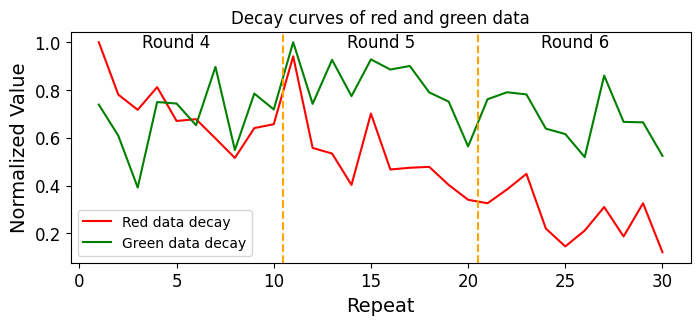

round 0, exponent in the exp func is -0.07472499699077181
round 1, exponent in the exp func is -0.12987990032231914
round 2, exponent in the exp func is -0.05409199709646579
red_recover_factor.shape: (3, 1)


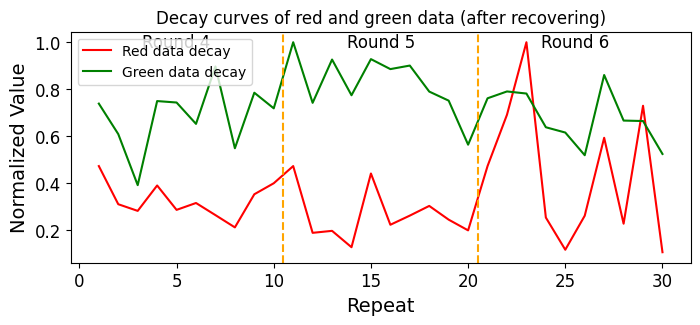

stacked_green.shape is (1440, 281) (compare with 48*3*10=1440)
group_satcked_green.shape, data_axons.shape are: (1440, 23) (23,)
stacked_red.shape is (1440, 1) (compare with 48*3*10=1440)
np.max(group_satcked_green), np.min(group_satcked_green) are: 23.665895684845708 -6.580518409021957
np.max(stacked_red), np.min(stacked_red) are: 1.1687414763592152 -0.46077202173483056


In [ ]:
cell_data = copy.deepcopy(cell_data_dict[cell_name])
# cell_data = copy.deepcopy(cell_data_dict['CL075_230303'])
# cell_data = cell_data_dict['CL090_230515']
# cell_data = cell_data_dict['CL075_230303']

# # the following 4 lines of code used for checking if cell_data and
# # cell_data_dict changed after running the code of this chunk; compare
# # with the printing at the end
# print(cell_data['red_dFFMeanValues'][1,1][0,-1])
# print(cell_data['green_dFFMeanValues'][1,1][0,-1])
# print(cell_data_dict['CL090_230515']['red_dFFMeanValues'][1,1][0,-1])
# print(cell_data_dict['CL090_230515']['green_dFFMeanValues'][1,1][0,-1])


delete_small_group = True # delete groups (axons) with less than 3 components

data_green = cell_data['green_dFFMeanValues'][:,:-1] # exclude 49th column
data_red = cell_data['red_dFFMeanValues'][:,:-1] # exclude 49th column
# data_red = cell_data['red_dFFMeanValues'][:,:-1].copy() # exclude 49th column
# the .copy() method is for a NumPy array. Using .copy() on a NumPy array,
# it creates a new copied array but it is a separate and independent object.
# Modifying the copied array will not affect the original array.
# # here uses .copy() to avoid cell_data and cell_data['red_dFFMeanValues'] be changed in
# # the later code line data_red[i,j] = red_recover_factor[i,0] * data_red[i,j], or we can use
# # cell_data = copy.deepcopy(cell_data_dict['CL090_230515']) to guarantee cell_data['red_dFFMeanValues']
# # will not be changed (cell_data will be changed).
# # copy.deepcopy will recursively copy all nested objects; copy.copy cannot do this.
data_axons = cell_data['axons']

# sum red data to see the decay
sum_mat_red = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
for i in range(data_red.shape[0]):
    sum = np.zeros((data_red[0,0].shape[0], 1))
    for j in range(data_red.shape[1]):
        sum = sum + data_red[i,j]
    # print(np.sum(sum))
    sum_mat_red[i, 0] = sum
# print("sum_mat_red:", sum_mat_red)

# Normalization of red
sum_mat_red_n = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
max_value = -np.inf
for i in range(sum_mat_red.shape[0]):
    for j in range(sum_mat_red.shape[1]):
        max_value = max(max_value, np.max(np.abs(sum_mat_red[i, j])))
for i in range(sum_mat_red.shape[0]):
    for j in range(sum_mat_red.shape[1]):
        element = sum_mat_red[i, j]
        sum_mat_red_n[i, j] = element / max_value
# print(sum_mat_red_n.shape)

# vstack sum_mat_red_n
stacked_sum_mat_red_n = np.empty((0, sum_mat_red_n[0,0].shape[1]))
# Enumerate the elements in the np array and vstack them
for index, value in np.ndenumerate(sum_mat_red_n):
    stacked_sum_mat_red_n = np.vstack((stacked_sum_mat_red_n, value))
stacked_sum_mat_red_n = np.squeeze(stacked_sum_mat_red_n)
# print(stacked_sum_mat_red_n.shape)


# sum green data to see the decay
sum_mat_green = np.zeros((data_green.shape[0], 1), dtype=np.ndarray)
for i in range(data_green.shape[0]):
    sum = np.zeros((data_green[0,0].shape[0], 1))
    for j in range(data_green.shape[1]):
        sum = sum + np.sum(data_green[i,j], axis=1, keepdims=True)
    # print(np.sum(sum))
    sum_mat_green[i, 0] = sum
# print(sum_mat_green)

# Normalization of green
sum_mat_green_n = np.zeros((data_green.shape[0], 1), dtype=np.ndarray)
max_value = -np.inf
for i in range(sum_mat_green.shape[0]):
    for j in range(sum_mat_green.shape[1]):
        max_value = max(max_value, np.max(np.abs(sum_mat_green[i, j])))
for i in range(sum_mat_green.shape[0]):
    for j in range(sum_mat_green.shape[1]):
        element = sum_mat_green[i, j]
        sum_mat_green_n[i, j] = element / max_value
# print(sum_mat_green_n.shape)

# vstack sum_mat_green_n
stacked_sum_mat_green_n = np.empty((0, sum_mat_green_n[0,0].shape[1]))
# Enumerate the elements in the np array and vstack them
for index, value in np.ndenumerate(sum_mat_green_n):
    stacked_sum_mat_green_n = np.vstack((stacked_sum_mat_green_n, value))
stacked_sum_mat_green_n = np.squeeze(stacked_sum_mat_green_n)
# print(stacked_sum_mat_green_n.shape)


# plot stacked_sum_mat_red_n and stacked_sum_mat_green_n
x = np.arange(1, stacked_sum_mat_green_n.shape[0] + 1)
fig, ax = plt.subplots(figsize=(8, 3))  # Adjust the figure size as desired
ax.plot(x, stacked_sum_mat_red_n, color='red', label='Red data decay')
ax.plot(x, stacked_sum_mat_green_n, color='green', label='Green data decay')
ax.axvline(x=10.5, color='orange', linestyle='--')
ax.axvline(x=20.5, color='orange', linestyle='--')
ax.text(5, 1, 'Round 4', ha='center', va='center', fontsize=12)
ax.text(15.5, 1, 'Round 5', ha='center', va='center', fontsize=12)
ax.text(25.5, 1, 'Round 6', ha='center', va='center', fontsize=12)
ax.set_title('Decay curves of red and green data')
ax.tick_params(axis='both', labelsize=12)  # Adjust the tick size as desired
ax.set_xlabel('Repeat', fontsize=14)  # Adjust the label size as desired
ax.set_ylabel('Normalized Value', fontsize=14)  # Adjust the label size as desired
ax.legend()
plt.show()


# Define the exponential function for regression of decay
def exponential_func(x, lambda_):
    return np.exp(lambda_ * x)
red_recover_factor = sum_mat_red_n.copy()
for i in range(sum_mat_red_n.shape[0]):
    for j in range(sum_mat_red_n.shape[1]): # sum_mat_red_n.shape[1] = 1
        y = sum_mat_red_n[i, j].copy()
        y = np.squeeze(y)
        multiplier = 1 / y[0]
        y = y * multiplier
        x = np.arange(10)
        popt, pcov = curve_fit(exponential_func, x, y)
        lambda_ = popt[0]
        print(f"round {i}, exponent in the exp func is {lambda_}")
        y_fit = exponential_func(x, lambda_)
        y = y.reshape(-1, 1)
        y_fit = y_fit.reshape(-1, 1)
        red_recover_factor[i, j] = (y / y_fit) * multiplier
print("red_recover_factor.shape:", red_recover_factor.shape)

for i in range(data_red.shape[0]):
    for j in range(data_red.shape[1]):
        data_red[i,j] = red_recover_factor[i,0] * data_red[i,j]

# sum red data to see the decay
sum_mat_red = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
for i in range(data_red.shape[0]):
    sum = np.zeros((data_red[0,0].shape[0], 1))
    for j in range(data_red.shape[1]):
        sum = sum + data_red[i,j]
    # print(np.sum(sum))
    sum_mat_red[i, 0] = sum
# print(sum_mat_red)

# Normalization of red
sum_mat_red_n = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
max_value = -np.inf
for i in range(sum_mat_red.shape[0]):
    for j in range(sum_mat_red.shape[1]):
        max_value = max(max_value, np.max(np.abs(sum_mat_red[i, j])))
for i in range(sum_mat_red.shape[0]):
    for j in range(sum_mat_red.shape[1]):
        element = sum_mat_red[i, j]
        sum_mat_red_n[i, j] = element / max_value
# print("sum_mat_red_n.shape:", sum_mat_red_n.shape)
# print("sum_mat_red_n[0,0].shape:", sum_mat_red_n[0,0].shape)

# vstack sum_mat_red_n
stacked_sum_mat_red_n = np.empty((0, sum_mat_red_n[0,0].shape[1]))
# Enumerate the elements in the np array and vstack them
for index, value in np.ndenumerate(sum_mat_red_n):
    stacked_sum_mat_red_n = np.vstack((stacked_sum_mat_red_n, value))
stacked_sum_mat_red_n = np.squeeze(stacked_sum_mat_red_n)
# print(stacked_sum_mat_red_n.shape)


# plot stacked_sum_mat_red_n and stacked_sum_mat_green_n
x = np.arange(1, stacked_sum_mat_green_n.shape[0] + 1)
fig, ax = plt.subplots(figsize=(8, 3))  # Adjust the figure size as desired
ax.plot(x, stacked_sum_mat_red_n, color='red', label='Red data decay')
ax.plot(x, stacked_sum_mat_green_n, color='green', label='Green data decay')
ax.axvline(x=10.5, color='orange', linestyle='--')
ax.axvline(x=20.5, color='orange', linestyle='--')
ax.text(5, 1, 'Round 4', ha='center', va='center', fontsize=12)
ax.text(15.5, 1, 'Round 5', ha='center', va='center', fontsize=12)
ax.text(25.5, 1, 'Round 6', ha='center', va='center', fontsize=12)
ax.set_title('Decay curves of red and green data (after recovering)')
ax.tick_params(axis='both', labelsize=12)  # Adjust the tick size as desired
ax.set_xlabel('Repeat', fontsize=14)  # Adjust the label size as desired
ax.set_ylabel('Normalized Value', fontsize=14)  # Adjust the label size as desired
ax.legend()
plt.show()


if mean_pupil_size_along_conditions_multiply:
    for i in range(data_green.shape[0]):
        if i == 0:
            mul_mat = mean_mat_pupil[:10,[1]] / np.mean(mean_mat_pupil)
        if i == 1:
            mul_mat = mean_mat_pupil[10:20,[1]] / np.mean(mean_mat_pupil)
        if i == 2:
            mul_mat = mean_mat_pupil[20:30,[1]] / np.mean(mean_mat_pupil)
        for j in range(data_green.shape[1]):
            data_green[i,j] = data_green[i,j] * mul_mat
if mean_pupil_size_each_condition_each_repeat_multiply:
    for i in range(data_green.shape[0]):
        for j in range(data_green.shape[1]):
            data_green[i,j] = data_green[i,j] * fine_mean_mat_pupil[i,j][:,[1]] / np.mean(mean_mat_pupil)


### the following is stacking opearion to make green and red data both 2-D
### so that thery are prepared for later regression

# print(data_axons)
# print(type(data_axons),len(data_axons))
if delete_small_group:
    data_axons = np.array([axons_ for axons_ in data_axons if len(axons_) >= 3], dtype=object)
# print(data_axons)
# print(type(data_axons),len(data_axons))

# vstack green data
stacked_green = np.empty((0, data_green[0,0].shape[1]))
# Enumerate the elements in the np array and vstack them
for index, value in np.ndenumerate(data_green):
    stacked_green = np.vstack((stacked_green, value))
print(f"stacked_green.shape is {stacked_green.shape} (compare with 48*3*10={48*3*10})")

# group columns of green data
group_num = data_axons.shape[0]
group_satcked_green = np.zeros((stacked_green.shape[0], group_num))
for i, cols in enumerate(data_axons):
    group_satcked_green[:, i] = np.sum(stacked_green[:, cols-1], axis=1)
print("group_satcked_green.shape, data_axons.shape are:", group_satcked_green.shape, data_axons.shape)

# vstack red data
stacked_red = np.empty((0, data_red[0,0].shape[1]))
# Enumerate the elements in the np array and vstack them
for index, value in np.ndenumerate(data_red):
    stacked_red = np.vstack((stacked_red, value))
print(f"stacked_red.shape is {stacked_red.shape} (compare with 48*3*10={48*3*10})")

print("np.max(group_satcked_green), np.min(group_satcked_green) are:", np.max(group_satcked_green), np.min(group_satcked_green))
print("np.max(stacked_red), np.min(stacked_red) are:", np.max(stacked_red), np.min(stacked_red))

# # the following 4 lines of code used for checking if cell_data and
# # cell_data_dict changed after running the code of this chunk; compare
# # with the beginning printing
# print(cell_data['red_dFFMeanValues'][1,1][0,-1])
# print(cell_data['green_dFFMeanValues'][1,1][0,-1])
# print(cell_data_dict['CL090_230515']['red_dFFMeanValues'][1,1][0,-1])
# print(cell_data_dict['CL090_230515']['green_dFFMeanValues'][1,1][0,-1])


## Set for no decay restoration

In [ ]:
# if wants to use the decay_restoration = False situation, reset data_red and data_green
decay_restoration = True
if decay_restoration == False: # if decay_restoration = False situation, reset data_red and data_green
    print("decay_restoration is False")
    cell_data = copy.deepcopy(cell_data_dict[cell_name])
    data_green = cell_data['green_dFFMeanValues'][:,:-1] # exclude 49th column
    data_red = cell_data['red_dFFMeanValues'][:,:-1] # exclude 49th column
    data_axons = cell_data['axons']

    ### the following is stacking opearion to make green and red data both 2-D
    ### so that thery are prepared for later regression

    # print(data_axons)
    # print(type(data_axons),len(data_axons))
    if delete_small_group:
        data_axons = np.array([axons_ for axons_ in data_axons if len(axons_) >= 3], dtype=object)
    # print(data_axons)
    # print(type(data_axons),len(data_axons))

    # vstack green data
    stacked_green = np.empty((0, data_green[0,0].shape[1]))
    # Enumerate the elements in the np array and vstack them
    for index, value in np.ndenumerate(data_green):
        stacked_green = np.vstack((stacked_green, value))
    print(f"stacked_green.shape is {stacked_green.shape} (compare with 48*3*10={48*3*10})")

    # group columns of green data
    group_num = data_axons.shape[0]
    group_satcked_green = np.zeros((stacked_green.shape[0], group_num))
    for i, cols in enumerate(data_axons):
        group_satcked_green[:, i] = np.sum(stacked_green[:, cols-1], axis=1)
    print("group_satcked_green.shape, data_axons.shape are:", group_satcked_green.shape, data_axons.shape)

    # vstack red data
    stacked_red = np.empty((0, data_red[0,0].shape[1]))
    # Enumerate the elements in the np array and vstack them
    for index, value in np.ndenumerate(data_red):
        stacked_red = np.vstack((stacked_red, value))
    print(f"stacked_red.shape is {stacked_red.shape} (compare with 48*3*10={48*3*10})")

    print("np.max(group_satcked_green), np.min(group_satcked_green) are:", np.max(group_satcked_green), np.min(group_satcked_green))
    print("np.max(stacked_red), np.min(stacked_red) are:", np.max(stacked_red), np.min(stacked_red))

## Analysis for pupil and fluorescence

### Prepare data

In [ ]:
cell_data = copy.deepcopy(cell_data_dict[cell_name])
# cell_data = copy.deepcopy(cell_data_dict['CL075_230303'])
# cell_data = cell_data_dict['CL090_230515']
# cell_data = cell_data_dict['CL075_230303']

data_green = cell_data['green_dFFMeanValues'][:,:-1] # exclude 49th column
data_red = cell_data['red_dFFMeanValues'][:,:-1] # exclude 49th column

data_axons = cell_data['axons']
delete_small_group = True # delete groups (axons) with less than 3 components
if delete_small_group:
    data_axons = np.array([axons_ for axons_ in data_axons if len(axons_) >= 3], dtype=object)

decay_restoration = True
if decay_restoration:
    # sum red data to see the decay
    sum_mat_red = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
    for i in range(data_red.shape[0]):
        sum = np.zeros((data_red[0,0].shape[0], 1))
        for j in range(data_red.shape[1]):
            sum = sum + data_red[i,j]
        # print(np.sum(sum))
        sum_mat_red[i, 0] = sum
    # print("sum_mat_red:", sum_mat_red)

    # Normalization of red
    sum_mat_red_n = np.zeros((data_red.shape[0], 1), dtype=np.ndarray)
    max_value = -np.inf
    for i in range(sum_mat_red.shape[0]):
        for j in range(sum_mat_red.shape[1]):
            max_value = max(max_value, np.max(np.abs(sum_mat_red[i, j])))
    for i in range(sum_mat_red.shape[0]):
        for j in range(sum_mat_red.shape[1]):
            element = sum_mat_red[i, j]
            sum_mat_red_n[i, j] = element / max_value
    # print(sum_mat_red_n.shape)

    # Define the exponential function for regression of decay
    def exponential_func(x, lambda_):
        return np.exp(lambda_ * x)
    red_recover_factor = sum_mat_red_n.copy()
    for i in range(sum_mat_red_n.shape[0]):
        for j in range(sum_mat_red_n.shape[1]): # sum_mat_red_n.shape[1] = 1
            y = sum_mat_red_n[i, j].copy()
            y = np.squeeze(y)
            multiplier = 1 / y[0]
            y = y * multiplier
            x = np.arange(10)
            popt, pcov = curve_fit(exponential_func, x, y)
            lambda_ = popt[0]
            print(f"round {i}, exponent in the exp func is {lambda_}")
            y_fit = exponential_func(x, lambda_)
            y = y.reshape(-1, 1)
            y_fit = y_fit.reshape(-1, 1)
            red_recover_factor[i, j] = (y / y_fit) * multiplier
    print("red_recover_factor.shape:", red_recover_factor.shape)

    for i in range(data_red.shape[0]):
        for j in range(data_red.shape[1]):
            data_red[i,j] = red_recover_factor[i,0] * data_red[i,j]

print("green:")
print(type(data_green))
print(data_green.shape)
print(data_green[1,1].shape)

print("red:")
print(type(data_red))
print(data_red.shape)
print(data_red[1,1].shape)

print("fine_mean_mat_pupil:")
print(fine_mean_mat_pupil.shape)
print(fine_mean_mat_pupil[0,1].shape)


data_green_mean = copy.deepcopy(data_green)
data_green_std = copy.deepcopy(data_green)

green_mean_vstack_array = np.empty((0, 1))
green_std_vstack_array = np.empty((0, 1))
red_vstack_array = np.empty((0, 1))
mean_pupil_vstack_array = np.empty((0, 1))

num_column = data_green.shape[1]
green_mean_vstack_array_condition = np.empty((0, num_column))
green_std_vstack_array_condition = np.empty((0, num_column))
red_vstack_array_condition = np.empty((0, num_column))
mean_pupil_vstack_array_condition = np.empty((0, num_column))

num_group = len(data_axons)
print("num_group:", num_group)
green_mean_vstack_array_condition_groups = [np.empty((0, num_column)) for _ in range(num_group)]
green_std_vstack_array_condition_groups = [np.empty((0, num_column)) for _ in range(num_group)]

for i in range(data_green.shape[0]):
    data_green_mean_condition = np.empty((data_green[0,0].shape[0], 0))
    data_green_std_condition = np.empty((data_green[0,0].shape[0], 0))
    data_red_condition = np.empty((data_red[0,0].shape[0], 0))
    fine_mean_mat_pupil_condition = np.empty((fine_mean_mat_pupil[0,0].shape[0], 0))

    data_green_mean_condition_groups = [np.empty((data_green[0,0].shape[0], 0)) for _ in range(num_group)]
    data_green_std_condition_groups = [np.empty((data_green[0,0].shape[0], 0)) for _ in range(num_group)]
    for j in range(data_green.shape[1]):
        data_green_mean[i,j] = np.mean(data_green[i,j], axis=1, keepdims=True)
        data_green_std[i,j] = np.std(data_green[i,j], axis=1, keepdims=True)
        green_mean_vstack_array = np.vstack((green_mean_vstack_array, data_green_mean[i,j]))
        green_std_vstack_array = np.vstack((green_std_vstack_array, data_green_std[i,j]))
        red_vstack_array = np.vstack((red_vstack_array, data_red[i,j]))
        mean_pupil_vstack_array = np.vstack((mean_pupil_vstack_array, fine_mean_mat_pupil[i,j][:,[1]]))

        data_green_mean_condition = np.hstack((data_green_mean_condition, data_green_mean[i,j]))
        data_green_std_condition = np.hstack((data_green_std_condition, data_green_std[i,j]))
        data_red_condition = np.hstack((data_red_condition, data_red[i,j]))
        fine_mean_mat_pupil_condition = np.hstack((fine_mean_mat_pupil_condition, fine_mean_mat_pupil[i,j][:,[1]]))

        for ii, cols in enumerate(data_axons):
            data_green_group_mean = np.mean(data_green[i,j][:, cols-1], axis=1, keepdims=True)
            data_green_group_std = np.std(data_green[i,j][:, cols-1], axis=1, keepdims=True)
            data_green_mean_condition_groups[ii] = np.hstack((data_green_mean_condition_groups[ii], data_green_group_mean))
            data_green_std_condition_groups[ii] = np.hstack((data_green_std_condition_groups[ii], data_green_group_std))

    green_mean_vstack_array_condition = np.vstack((green_mean_vstack_array_condition, data_green_mean_condition))
    green_std_vstack_array_condition = np.vstack((green_std_vstack_array_condition, data_green_std_condition))
    red_vstack_array_condition = np.vstack((red_vstack_array_condition, data_red_condition))
    mean_pupil_vstack_array_condition = np.vstack((mean_pupil_vstack_array_condition, fine_mean_mat_pupil_condition))

    for ii in range(num_group):
        green_mean_vstack_array_condition_groups[ii] = np.vstack((green_mean_vstack_array_condition_groups[ii],
                                                                  data_green_mean_condition_groups[ii]))
        green_std_vstack_array_condition_groups[ii] = np.vstack((green_std_vstack_array_condition_groups[ii],
                                                                 data_green_std_condition_groups[ii]))

## Overall Charactreistics of All Components Under All Conditions
## statistics without distinguishing components and conditions

print("green_mean_vstack_array:")
print(type(green_mean_vstack_array))
print(green_mean_vstack_array.shape)

print("green_std_vstack_array:")
print(type(green_std_vstack_array))
print(green_std_vstack_array.shape)

print("red_vstack_array:")
print(type(red_vstack_array))
print(red_vstack_array.shape)

print("mean_pupil_vstack_array:")
print(type(mean_pupil_vstack_array))
print(mean_pupil_vstack_array.shape)

pupil_fluorescence = np.hstack((mean_pupil_vstack_array, green_mean_vstack_array, green_std_vstack_array, red_vstack_array))

print("pupil_fluorescence:")
print(type(pupil_fluorescence))
print(pupil_fluorescence.shape)

## Charactreistics of All Components Across Different Conditions
## statistics distinguishing conditions but not components

print("green_mean_vstack_array_condition:")
print(type(green_mean_vstack_array_condition))
print(green_mean_vstack_array_condition.shape)

print("green_std_vstack_array_condition:")
print(type(green_std_vstack_array_condition))
print(green_std_vstack_array_condition.shape)

print("red_vstack_array_condition:")
print(type(red_vstack_array_condition))
print(red_vstack_array_condition.shape)

print("mean_pupil_vstack_array_condition:")
print(type(mean_pupil_vstack_array_condition))
print(mean_pupil_vstack_array_condition.shape)

pupil_fluorescence_condition = np.stack((mean_pupil_vstack_array_condition, green_mean_vstack_array_condition, green_std_vstack_array_condition,
                red_vstack_array_condition), axis=0)

print("pupil_fluorescence_condition:")
print(type(pupil_fluorescence_condition))
print(pupil_fluorescence_condition.shape)

## Charactreistics of Different Components Across Different Conditions
## statistics distinguishing conditions and components
## components are grouped with small groups (<3 components) neglected

data_list_to_be_stacked = [mean_pupil_vstack_array_condition, green_mean_vstack_array_condition, green_std_vstack_array_condition]
for i, (arr1, arr2) in enumerate(zip(green_mean_vstack_array_condition_groups, green_std_vstack_array_condition_groups)):
    data_list_to_be_stacked.append(arr1)
    data_list_to_be_stacked.append(arr2)
data_list_to_be_stacked.append(red_vstack_array_condition)

pupil_fluorescence_condition_groups = np.stack(data_list_to_be_stacked, axis=0)

print("pupil_fluorescence_condition_groups:")
print(type(pupil_fluorescence_condition_groups))
print(pupil_fluorescence_condition_groups.shape)

# print(green_mean_vstack_array_condition_groups[0].shape)
# print(data_axons)

round 0, exponent in the exp func is -0.07472499699077181
round 1, exponent in the exp func is -0.12987990032231914
round 2, exponent in the exp func is -0.05409199709646579
red_recover_factor.shape: (3, 1)
green:
<class 'numpy.ndarray'>
(3, 48)
(10, 281)
red:
<class 'numpy.ndarray'>
(3, 48)
(10, 1)
fine_mean_mat_pupil:
(3, 48)
(10, 3)
num_group: 23
green_mean_vstack_array:
<class 'numpy.ndarray'>
(1440, 1)
green_std_vstack_array:
<class 'numpy.ndarray'>
(1440, 1)
red_vstack_array:
<class 'numpy.ndarray'>
(1440, 1)
mean_pupil_vstack_array:
<class 'numpy.ndarray'>
(1440, 1)
pupil_fluorescence:
<class 'numpy.ndarray'>
(1440, 4)
green_mean_vstack_array_condition:
<class 'numpy.ndarray'>
(30, 48)
green_std_vstack_array_condition:
<class 'numpy.ndarray'>
(30, 48)
red_vstack_array_condition:
<class 'numpy.ndarray'>
(30, 48)
mean_pupil_vstack_array_condition:
<class 'numpy.ndarray'>
(30, 48)
pupil_fluorescence_condition:
<class 'numpy.ndarray'>
(4, 30, 48)
pupil_fluorescence_condition_groups:

### Plot graphs (condition not separately)

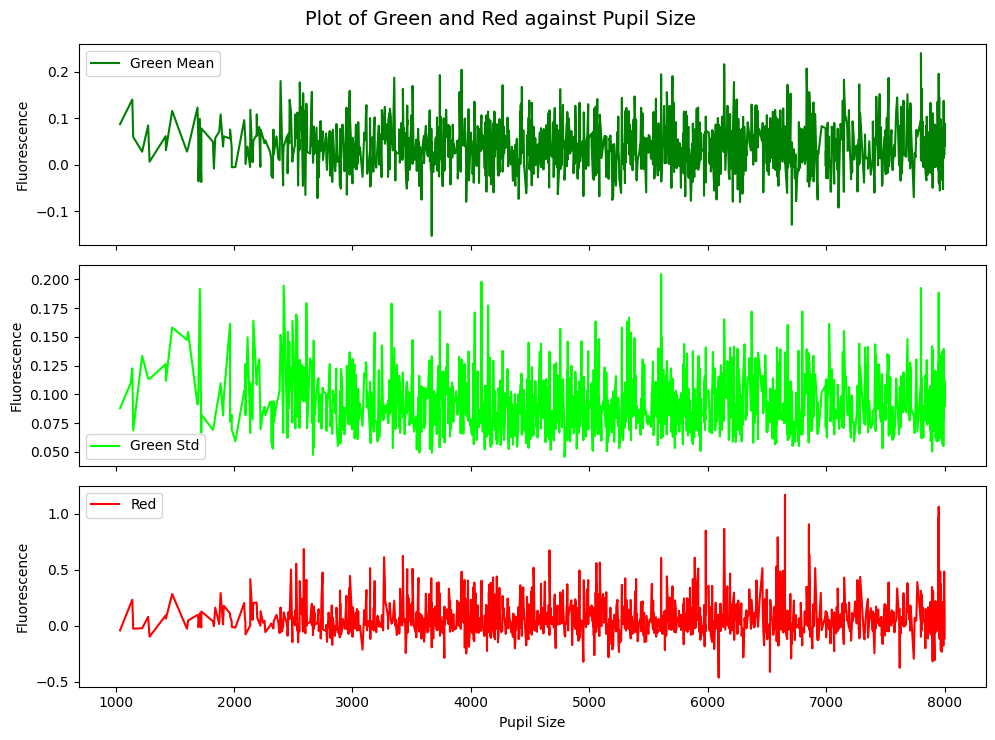

In [ ]:
# Get the indices that would sort the first column
sorted_indices = np.argsort(pupil_fluorescence[:, 0])

# Use the sorted indices to sort the entire array
sorted_pupil_fluorescence = pupil_fluorescence[sorted_indices]

# Separate the columns
p_size = sorted_pupil_fluorescence[:, 0]
green_m = sorted_pupil_fluorescence[:, 1]
green_s = sorted_pupil_fluorescence[:, 2]
red = sorted_pupil_fluorescence[:, 3]

# Set the figure size (width=10, height=6) and create subplots with 3 rows
fig, axes = plt.subplots(3, 1, figsize=(10, 7.5), sharex=True)

if decay_restoration:
    red_label = 'Red (bleach correction)'
else:
    red_label = 'Red'

# Plot the data on each subplot
axes[0].plot(p_size, green_m, label='Green Mean', color='green')
axes[1].plot(p_size, green_s, label='Green Std', color='lime')
axes[2].plot(p_size, red, label=red_label, color='red')

# Add labels, legends, and title to each subplot
axes[2].set_xlabel('Pupil Size')
for ax in axes:
    ax.set_ylabel('Fluorescence')
    ax.legend()
    ax.tick_params(axis='both', labelsize=10)  # Adjust tick size as desired
    # ax.set_title('Plot of Green and Red against Pupil Size', fontsize=14)  # Adjust title size as desired

# Add the title for the entire figure
fig.suptitle('Plot of Green and Red against Pupil Size', fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

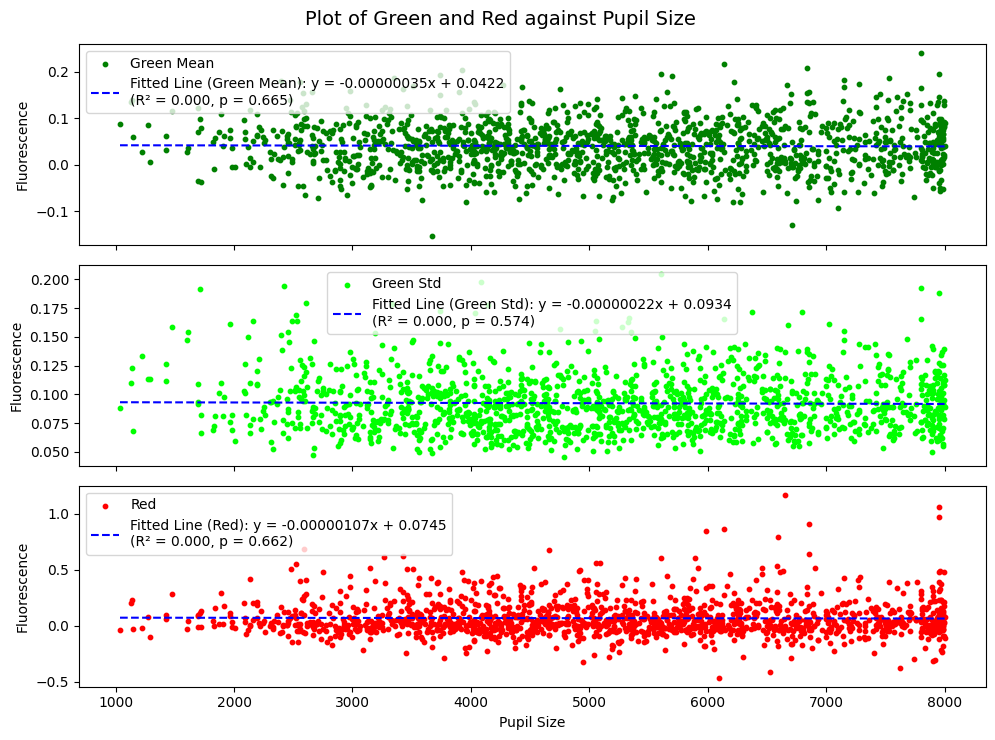

In [ ]:
# Set the figure size (width=10, height=6) and create subplots with 3 rows
fig, axes = plt.subplots(3, 1, figsize=(10, 7.5), sharex=True)

if decay_restoration:
    red_label = 'Red (bleach correction)'
else:
    red_label = 'Red'

# Size of the points for scatter plots
point_size = 10
# Scatter plots on each subplot
axes[0].scatter(p_size, green_m, label='Green Mean', color='green', s=point_size)
axes[1].scatter(p_size, green_s, label='Green Std', color='lime', s=point_size)
axes[2].scatter(p_size, red, label=red_label, color='red', s=point_size)

# Add linear fitted lines to each subplot
for ax, y_data, label in zip(axes, [green_m, green_s, red], ['Green Mean', 'Green Std', 'Red']):

    # Calculate R-squared and p-value
    from scipy.stats import linregress
    slope, intercept, r_value, p_value, _ = linregress(p_size, y_data)
    r_squared = r_value ** 2

    coeffs = np.polyfit(p_size, y_data, 1)
    fitted_line = np.polyval(coeffs, p_size)
    ax.plot(p_size, fitted_line, color='blue', linestyle='dashed',
            label=f'Fitted Line ({label}): y = {coeffs[0]:.8f}x + {coeffs[1]:.4f}\n(R² = {r_squared:.3f}, p = {p_value:.3f})')


# Add labels, legends, and title to each subplot
axes[2].set_xlabel('Pupil Size')
for ax in axes:
    ax.set_ylabel('Fluorescence')
    ax.legend()
    ax.tick_params(axis='both', labelsize=10)  # Adjust tick size as desired
    # ax.set_title('Plot of Green and Red against Pupil Size', fontsize=14)  # Adjust title size as desired

# Add the title for the entire figure
fig.suptitle('Plot of Green and Red against Pupil Size', fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

### Plot graphs (condition separately)

#### Set sf, tf, and ori

In [ ]:
# Create sf array
sf = np.tile([0.02, 0.08, 0.32], 16)

# Create tf array
tf = np.tile([1, 1, 1, 4, 4, 4], 8)

# Create orientation array
orientation = np.repeat(np.arange(0, 360, 45), 6)

print("sf:", sf)
print("tf:", tf)
print("orientation:", orientation)

sf: [0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08
 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02
 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32 0.02 0.08 0.32
 0.02 0.08 0.32 0.02 0.08 0.32]
tf: [1 1 1 4 4 4 1 1 1 4 4 4 1 1 1 4 4 4 1 1 1 4 4 4 1 1 1 4 4 4 1 1 1 4 4 4 1
 1 1 4 4 4 1 1 1 4 4 4]
orientation: [  0   0   0   0   0   0  45  45  45  45  45  45  90  90  90  90  90  90
 135 135 135 135 135 135 180 180 180 180 180 180 225 225 225 225 225 225
 270 270 270 270 270 270 315 315 315 315 315 315]


#### Statistics of all

(1 )Overall Charactreistics of All Components Under All Conditions

statistics without distinguishing components and conditions


(2) Charactreistics of All Components Across Different Conditions

statistics distinguishing conditions but not components

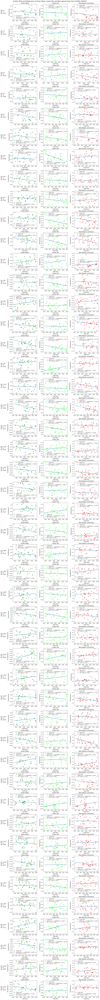

In [ ]:
point_size = 30  # Adjust the point size as desired

# Create a big figure with 48x3 subplots
fig, axes = plt.subplots(nrows=48, ncols=3, figsize=(15, 150), constrained_layout=True)  # Adjust the figure size as desired

data_types = ['Green Mean', 'Green Std', 'Red']
if decay_restoration:
    data_types = ['Green Mean', 'Green Std', 'Red (bleach correction)']
colors = ['green', 'lime', 'red']

# Create 48 rows of figures
for x in range(48):
    for i, y_data_idx in enumerate([1, 2, 3]):
        y_data = pupil_fluorescence_condition[y_data_idx, :, x]
        x_data = pupil_fluorescence_condition[0, :, x]
        if i == 0:
            x_data_min = np.min(x_data)
            x_data_max = np.max(x_data)
            y_data_min = np.min(y_data)
            y_data_max = np.max(y_data)
            x_text = x_data_min - 0.6 * (x_data_max - x_data_min)
            y_text = 0.5 * (y_data_max + y_data_min)

        # Scatter plots on each subplot
        axes[x, i].scatter(x_data, y_data, label='Scatter Plot', color=colors[i], s=point_size)

        # Calculate R-squared and p-value
        from scipy.stats import linregress
        slope, intercept, r_value, p_value, _ = linregress(x_data, y_data)
        r_squared = r_value ** 2

        # Add linear fitted line to each subplot
        coeffs = np.polyfit(x_data, y_data, 1)
        fitted_line = np.polyval(coeffs, x_data)
        axes[x, i].plot(x_data, fitted_line, color='#1f77b4', linestyle='solid',
                         label=f'Fitted Line: y = {coeffs[0]:.8f}x + {coeffs[1]:.4f}\n(R² = {r_squared:.2f}, p = {p_value:.2f})')

        # Customize the plot
        axes[x, i].set_xlabel('Pupil Size', fontsize=12)  # Adjust the label size as desired
        axes[x, i].set_ylabel('Fluorescence', fontsize=12)  # Adjust the label size as desired
        axes[x, i].set_title(data_types[i], fontsize=14)  # Adjust the title size as desired
        axes[x, i].legend(fontsize='medium')

    # Write the group information to the right of each row
    axes[x, 0].text(x_text, y_text, f'Ori: {orientation[x]}° \nTF: {tf[x]} \nSF: {sf[x]}', fontsize=14, va='center')  # Adjust the position and font size as desired

fig.suptitle(f'Scatter Plots and Fitted lines of Green Mean, Green Std, and Red against Pupil Size ({cell_name})', fontsize=16)
# plt.tight_layout()  # Adjust the spacing between subplots
# using plt.tight_layout() will let fig.suptitle overlap the plots, so use constrained_layout=True in plt.subplots instead.
# filename = f'Scatter_Plots_Green_Mean_Std_Red_against_Pupil_{cell_name}.pdf'
# plt.savefig(filename)
# filename = f'Scatter_Plots_Green_Mean_Std_Red_against_Pupil_{cell_name}.png'
# plt.savefig(filename)
plt.show()


#### Statistics of groups

(3) Overall Charactreistics of Different Components Across Different Conditions

statistics distinguishing conditions and components

components are grouped with small groups (<3 components) neglected

In [ ]:
point_size = 30  # Adjust the point size as desired

# Create a big figure with 48-row subplots
n_cols = pupil_fluorescence_condition_groups.shape[0] - 1
figsize_width = 15 / 3 * n_cols
fig, axes = plt.subplots(nrows=48, ncols=n_cols, figsize=(figsize_width, 150), constrained_layout=True)  # Adjust the figure size as desired

data_types = ['Green Mean (all)', 'Green Std (all)']
for i in range(num_group):
    data_types.append(f"Green Mean (group {i+1})")
    data_types.append(f"Green Std (group {i+1})")
if decay_restoration:
    data_types.append('Red (bleach correction)')
else:
    data_types.append('Red')

colors = ['green' if i % 2 == 0 else 'lime' for i in range(2 * (num_group + 1))]
colors.append('red')

# print(data_types)
# print(colors)

# Create 48 rows of figures
for x in range(48):
    for i, y_data_idx in enumerate([_ for _ in range(1, n_cols + 1)]):
        y_data = pupil_fluorescence_condition_groups[y_data_idx, :, x]
        x_data = pupil_fluorescence_condition_groups[0, :, x]
        if i == 0:
            x_data_min = np.min(x_data)
            x_data_max = np.max(x_data)
            y_data_min = np.min(y_data)
            y_data_max = np.max(y_data)
            x_text = x_data_min - 0.6 * (x_data_max - x_data_min)
            y_text = 0.5 * (y_data_max + y_data_min)

        # Scatter plots on each subplot
        axes[x, i].scatter(x_data, y_data, label='Scatter Plot', color=colors[i], s=point_size)

        # Calculate R-squared and p-value
        from scipy.stats import linregress
        slope, intercept, r_value, p_value, _ = linregress(x_data, y_data)
        r_squared = r_value ** 2

        # Add linear fitted line to each subplot
        coeffs = np.polyfit(x_data, y_data, 1)
        fitted_line = np.polyval(coeffs, x_data)
        axes[x, i].plot(x_data, fitted_line, color='#1f77b4', linestyle='solid',
                         label=f'Fitted Line: y = {coeffs[0]:.8f}x + {coeffs[1]:.4f}\n(R² = {r_squared:.2f}, p = {p_value:.2f})')

        # Customize the plot
        axes[x, i].set_xlabel('Pupil Size', fontsize=12)  # Adjust the label size as desired
        axes[x, i].set_ylabel('Fluorescence', fontsize=12)  # Adjust the label size as desired
        axes[x, i].set_title(data_types[i], fontsize=14)  # Adjust the title size as desired
        axes[x, i].legend(fontsize='medium')

    # Write the group information to the right of each row
    axes[x, 0].text(x_text, y_text, f'Ori: {orientation[x]}° \nTF: {tf[x]} \nSF: {sf[x]}', fontsize=14, va='center')  # Adjust the position and font size as desired

fig.suptitle(f'Scatter Plots and Fitted lines of Green Mean, Green Std, and Red against Pupil Size ({cell_name})', fontsize=16)
# plt.tight_layout()  # Adjust the spacing between subplots
# using plt.tight_layout() will let fig.suptitle overlap the plots, so use constrained_layout=True in plt.subplots instead.
filename = f'Scatter_Plots_Green_Mean_Std_Red_against_Pupil_in_groups_{cell_name}.pdf'
plt.savefig(filename)
# filename = f'Scatter_Plots_Green_Mean_Std_Red_against_Pupil_in_groups_{cell_name}.png'
# plt.savefig(filename)
plt.show()


## Regression

### Logistic regression

In [ ]:
import os
import numpy as np
import scipy.io
from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, mean_squared_error, r2_score
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
from IPython.display import clear_output
import random
import sys

In [ ]:
def plot_comparison(y_test, y_pred, subtitle = ''):
    # Sort y_pred and y_test based on y_test
    sorted_indices = np.argsort(y_test)
    sorted_y_pred = y_pred[sorted_indices]
    sorted_y_test = y_test[sorted_indices]
    # Plot sorted_y_pred and sorted_y_test
    plt.plot(sorted_y_pred, label='Sorted Predictions')
    plt.plot(sorted_y_test, label='Sorted Ground Truth')
    plt.xlabel('Index')
    plt.ylabel('Value')
    plt.title(f'Comparison of Sorted Predictions and Sorted Ground Truth \n ({subtitle})')
    plt.legend()
    plt.savefig(f'Comparison ({subtitle}).png', bbox_inches='tight')
    # bbox_inches='tight' will adjust the figure's bounding box to fit all the content, ensuring that
    # the complete words are visible in the saved figure. Otherwise, the saved figure may not show the
    # complete words, e.g., for x-label, or for the long title.
    # The default setting can sometimes result in cutoff or clipped text. It tries to include the entire
    # figure within the saved image, but there may be cases where the default behavior is not sufficient
    # to capture all the content. The default behavior assumes the figure content fits within the predefined
    # margins and padding.
    plt.show()

#### Divide train and val datasets

In [ ]:
# independent data
x = group_satcked_green

class_num = 480

# dependent data (labels/targets)
y = np.squeeze(stacked_red)
# print(np.max(y), np.min(y))

# Split the data into train and test sets
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.05, random_state=42)
# Calculate the minimum and maximum values
infinitesimal = np.finfo(float).eps
min_val = np.min(y) - infinitesimal # to guarantee to include min
max_val = np.max(y) + infinitesimal # to guarantee to include max
# Generate class_num+1 evenly spaced intervals
intervals = np.linspace(min_val, max_val, num=class_num+1) # num = class num + 1
# print(intervals)
# Digitize the array to get the indices of the intervals
y_train = np.digitize(y_train, intervals) - 1
y_test = np.digitize(y_test, intervals) - 1
print("x_train shape:", x_train.shape)
print("y_train shape:", y_train.shape)
print("x_test shape:", x_test.shape)
print("y_test shape:", y_test.shape)

# to see unique elements (see if we have all 0, 1,..., class_num-1 classes, better close to all)
unique_elements = np.unique(y_train)
print("Unique elements:", unique_elements)
print("Number of unique elements:", len(unique_elements))


x_train shape: (1368, 8)
y_train shape: (1368,)
x_test shape: (72, 8)
y_test shape: (72,)
Unique elements: [  0   9  16  25  26  31  41  44  46  47  48  50  53  54  55  56  57  58
  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 152 153 154 155 156 157 158 159 160 161 162 163 164 166 167 168
 169 170 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187
 188 189 191 192 193 194 195 196 197 199 200 201 202 205 206 207 208 210
 211 214 215 216 217 218 219 220 221 222 223 227 228 230 231 232 233 234
 235 240 242 244 247 255 256 257 259 261 263 265 267 268 271 273 274 277
 278 280 282 284 288 292 294 295 299 301 303 307 308 309 310 317 319 331
 334 339 341 346 

#### Fit and predict

'multinomial' (default option for multi-calss) achieves better performance than 'ovr'.

In [ ]:
# fit
model = linear_model.LogisticRegression(fit_intercept=True, max_iter=1000, multi_class='multinomial')
# model = linear_model.LogisticRegression(fit_intercept=True, max_iter=1000, multi_class='ovr')

fit_result = model.fit(x_train, y_train)
print(fit_result.intercept_.shape, fit_result.coef_.shape)
# print("Coefficients:", model.coef_[0,:])
# print("Intercept:", model.intercept_[0])
print('--- --- ---')

# predict
# Use the trained model to make predictions
y_pred = model.predict(x_test)
# Alternatively, you can get the predicted probabilities for each class
y_prob = model.predict_proba(x_test)

print('y_prob.shape:', y_prob.shape)
print(np.sum(y_prob, axis = 1))
# print(y_prob[0,:])

# Print the predicted class labels
print('y_pred:', y_pred)
print('y_test:', y_test)
print('y_pred shape:', y_pred.shape, 'y_test shape:', y_test.shape)
# Print the predicted probabilities
# print(y_prob)

(232,) (232, 8)
--- --- ---
y_prob.shape: (72, 232)
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
y_pred: [ 99 102 166 113 104 113 113  96  98 107 115 113  91 113 104 102 117 111
 154  96  99 113 107 191 117  84 100  96 123 101 101 113 110 117 101  96
 140 102 106 101 106 100 136 111  95 127 113 142 247 102  84 102  96  99
 104 113  96  99 100 108  94 222 104  96 113  99 102 317 111 102 107  96]
y_test: [ 86 153 192 155 108 141 128 117  64 102 105 217  76 131  83  82 135 135
 100 111  76 202 163 109 138  70 123  90 115 105  95 216 154 145  85  99
 151  97  39 103  76 116 174 120  90 126 208 153 268  88 104  98  68 108
 161 142 118  95 116 143  97 236 101  80 233 100  79 300 105 142  91  70]
y_pred shape: (72,) y_test shape: (72,)


#### Evaluate

##### Evaluate (normal)

In previous data division, I classify data into class_num (e.g., class_num = 160) intervals (histogram, by np.digitize). Here, evaluate the results with the same number of classes (e.g., class_num = 160).

Accuracy: 0.0
Mean squared error: 1391.1666666666667
Correlation coefficient: 0.6843142747095321
Coefficient of determination (R-squared score, R2 score): 0.4255529638018637


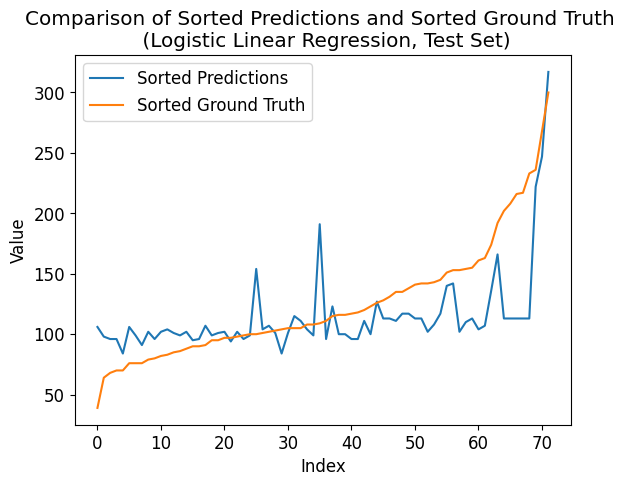

In [ ]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# cm = confusion_matrix(y_test, y_pred)
# print("Confusion Matrix:") # y_test doesn't include all classes, so confusion matrix is less than num_class by num_class
# print(cm)
# the columns represent the predicted labels (predictions)
# the rows represent the true labels (ground truth)
#                Predicted Class
#           |   Class 1   |   Class 2   |   Class 3   |
# -----------------------------------------------------
# True Class   |     TP1     |     FN1     |     FN1     |
# -----------------------------------------------------
# True Class   |     FP2     |     TP2     |     FN2     |
# -----------------------------------------------------
# True Class   |     FN3     |     FP3     |     TP3     |

mse = mean_squared_error(y_test, y_pred)
print("Mean squared error:", mse)

# Calculate the correlation coefficient
correlation = np.corrcoef(y_pred, y_test)[0, 1]
print("Correlation coefficient:", correlation)

r_squared = r2_score(y_test, y_pred)
print("Coefficient of determination (R-squared score, R2 score):", r_squared)


# Sort y_pred and y_test based on y_test
plot_comparison(y_test, y_pred, 'Logistic Linear Regression, Test Set')

Accuracy: 0.09210526315789473
Mean squared error: 1739.1220760233919
Correlation coefficient: 0.6637453859151013
Coefficient of determination (R-squared score, R2 score): 0.4042761207332183


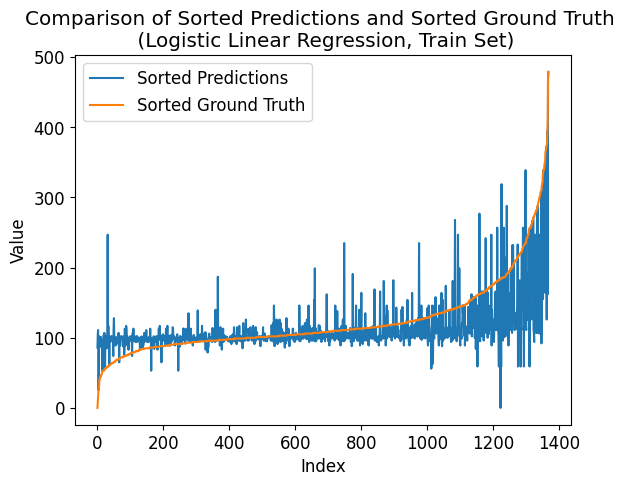

In [ ]:
# predict on train
# Use the trained model to make predictions
y_pred_ = model.predict(x_train)
# Alternatively, you can get the predicted probabilities for each class
y_prob_ = model.predict_proba(x_train)

accuracy = accuracy_score(y_train, y_pred_)
print("Accuracy:", accuracy)

# cm = confusion_matrix(y_train, y_pred_)
# print("Confusion Matrix:")
# print(cm)
# the columns represent the predicted labels (predictions)
# the rows represent the true labels (ground truth)
#                Predicted Class
#              |   Class 1   |   Class 2   |   Class 3   |
# -----------------------------------------------------
# True Class   |     TP1     |     FN1     |     FN1     |
# -----------------------------------------------------
# True Class   |     FP2     |     TP2     |     FN2     |
# -----------------------------------------------------
# True Class   |     FN3     |     FP3     |     TP3     |

mse = mean_squared_error(y_train, y_pred_)
print("Mean squared error:", mse)

# Calculate the correlation coefficient
correlation = np.corrcoef(y_pred_, y_train)[0, 1]
print("Correlation coefficient:", correlation)

r_squared = r2_score(y_train, y_pred_)
print("Coefficient of determination (R-squared score, R2 score):", r_squared)

plot_comparison(y_train, y_pred_, 'Logistic Linear Regression, Train Set')

##### Evaluate (reduced)

The model is based on classifying data into class_num (e.g., class_num = 160) intervals (histogram, by np.digitize). Here, evaluate the results a smaller number of classes (e.g., reduced_class_num = 16), that is, for the example of class_num = 160 and reduced_class_num = 16, classes 0, 1, ..., 15 become one class, i.e., 0; ...; classes 144, 145, ..., 159 become one class, i.e., 15.

In [ ]:
print("---- ---- ----")
# Define the boundaries for digitization
reduced_class_num = 16
intervals = np.arange(0, class_num + 1, class_num / reduced_class_num)
print(intervals)

y_train_digital = np.digitize(y_train, intervals) - 1
y_test_digital = np.digitize(y_test, intervals) - 1
y_pred_train_digital = np.digitize(y_pred_, intervals) - 1
y_pred_test_digital = np.digitize(y_pred, intervals) - 1
print(y_pred)
print(y_pred_test_digital)
mse = mean_squared_error(y_test_digital, y_pred_test_digital)
print("Mean squared error:", mse)
correlation = np.corrcoef(y_pred_test_digital, y_test_digital)[0, 1]
print("Correlation coefficient:", correlation)
r_squared = r2_score(y_test_digital, y_pred_test_digital)
print("Coefficient of determination (R-squared score, R2 score):", r_squared)
mse = mean_squared_error(y_train_digital, y_pred_train_digital)
print("Mean squared error:", mse)
correlation = np.corrcoef(y_pred_train_digital, y_train_digital)[0, 1]
print("Correlation coefficient:", correlation)
r_squared = r2_score(y_train_digital, y_pred_train_digital)
print("Coefficient of determination (R-squared score, R2 score):", r_squared)

---- ---- ----
[  0.  30.  60.  90. 120. 150. 180. 210. 240. 270. 300. 330. 360. 390.
 420. 450. 480.]
[ 99 102 166 113 104 113 113  96  98 107 115 113  91 113 104 102 117 111
 154  96  99 113 107 191 117  84 100  96 123 101 101 113 110 117 101  96
 140 102 106 101 106 100 136 111  95 127 113 142 247 102  84 102  96  99
 104 113  96  99 100 108  94 222 104  96 113  99 102 317 111 102 107  96]
[ 3  3  5  3  3  3  3  3  3  3  3  3  3  3  3  3  3  3  5  3  3  3  3  6
  3  2  3  3  4  3  3  3  3  3  3  3  4  3  3  3  3  3  4  3  3  4  3  4
  8  3  2  3  3  3  3  3  3  3  3  3  3  7  3  3  3  3  3 10  3  3  3  3]
Mean squared error: 1.8611111111111112
Correlation coefficient: 0.6044187652504551
Coefficient of determination (R-squared score, R2 score): 0.3066973268180512
Mean squared error: 2.1637426900584797
Correlation coefficient: 0.6209554649484783
Coefficient of determination (R-squared score, R2 score): 0.35021345672807513


Fixing the reduced class number, I enumerate the original class number to see what a original class number is better.

x_train shape: (1368, 8)
y_train shape: (1368,)
x_test shape: (72, 8)
y_test shape: (72,)
---- ---- ----
class_num = 16
Number of unique elements: 15
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16.]
test eval:
Mean squared error: 2.0
Correlation coefficient: 0.5808376515485556
Coefficient of determination (R-squared score, R2 score): 0.2549583213567117
train eval:
Mean squared error: 2.209795321637427
Correlation coefficient: 0.601976313921563
Coefficient of determination (R-squared score, R2 score): 0.33638354043546326


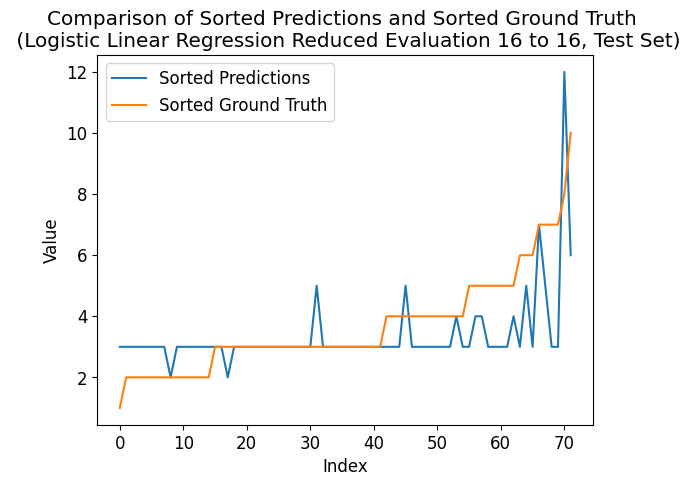

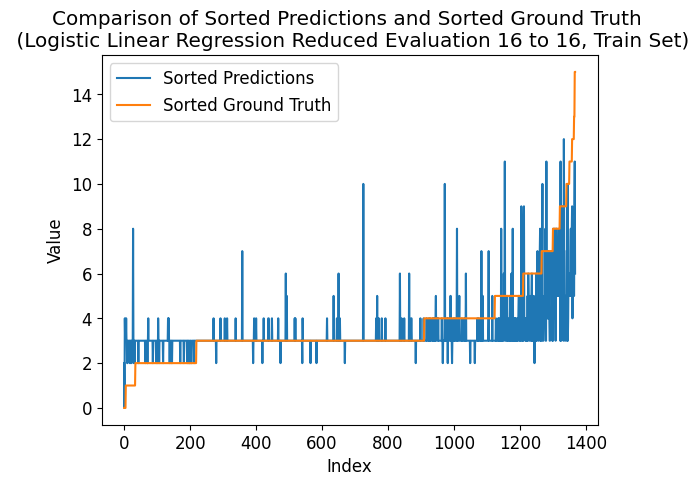

---- ---- ----
class_num = 32
Number of unique elements: 29
[ 0.  2.  4.  6.  8. 10. 12. 14. 16. 18. 20. 22. 24. 26. 28. 30. 32.]
test eval:
Mean squared error: 2.5
Correlation coefficient: 0.452951710385869
Coefficient of determination (R-squared score, R2 score): 0.06869790169588963
train eval:
Mean squared error: 2.365497076023392
Correlation coefficient: 0.570746519428657
Coefficient of determination (R-squared score, R2 score): 0.2896252520175848


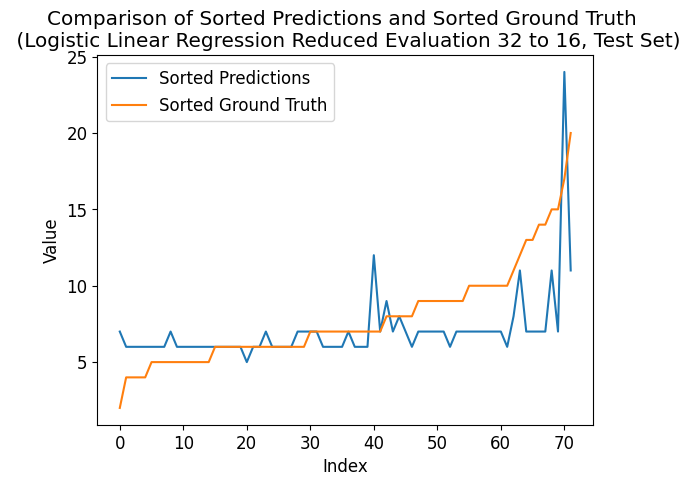

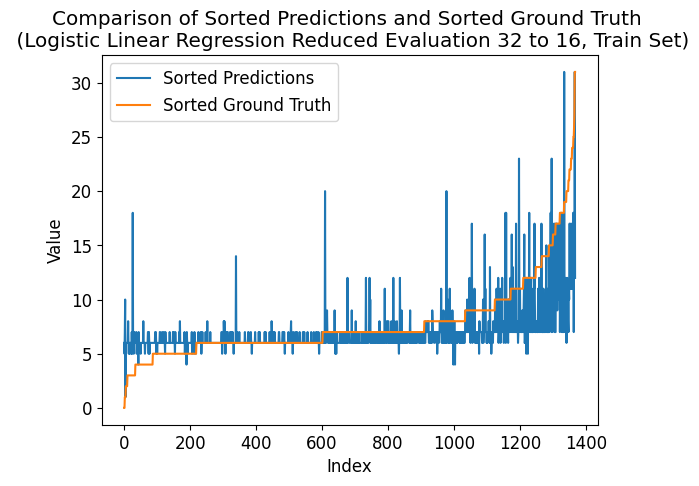

---- ---- ----
class_num = 48
Number of unique elements: 40
[ 0.  3.  6.  9. 12. 15. 18. 21. 24. 27. 30. 33. 36. 39. 42. 45. 48.]
test eval:
Mean squared error: 2.4444444444444446
Correlation coefficient: 0.44696234645826
Coefficient of determination (R-squared score, R2 score): 0.08939350388042533
train eval:
Mean squared error: 2.502923976608187
Correlation coefficient: 0.5445597165919429
Coefficient of determination (R-squared score, R2 score): 0.2483550256205842


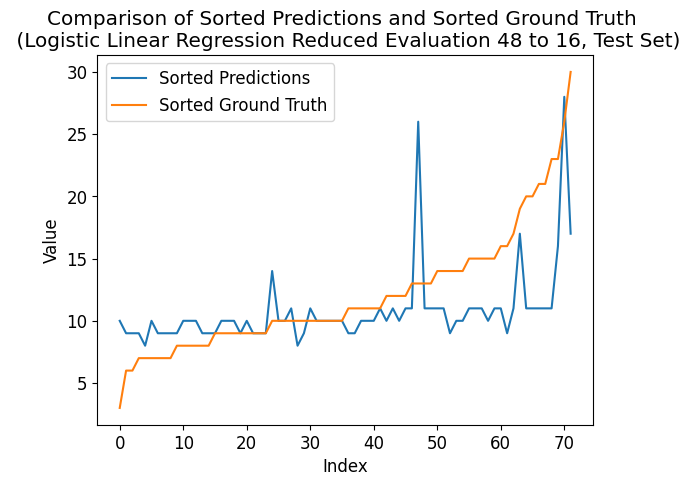

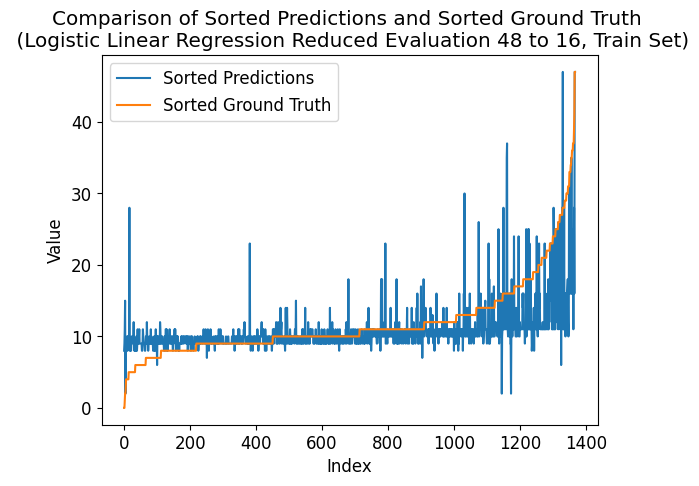

---- ---- ----
class_num = 64
Number of unique elements: 53
[ 0.  4.  8. 12. 16. 20. 24. 28. 32. 36. 40. 44. 48. 52. 56. 60. 64.]
test eval:
Mean squared error: 2.25
Correlation coefficient: 0.5210344768333426
Coefficient of determination (R-squared score, R2 score): 0.1618281115263006
train eval:
Mean squared error: 2.4166666666666665
Correlation coefficient: 0.5584757266071411
Coefficient of determination (R-squared score, R2 score): 0.2742586783591272


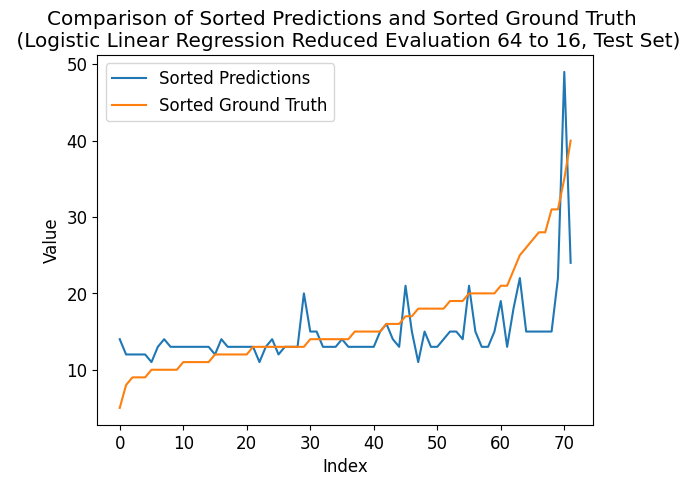

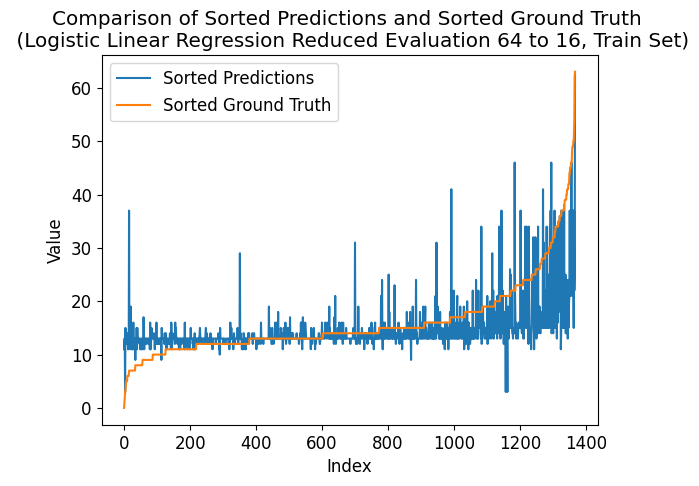

---- ---- ----
class_num = 80
Number of unique elements: 64
[ 0.  5. 10. 15. 20. 25. 30. 35. 40. 45. 50. 55. 60. 65. 70. 75. 80.]
test eval:
Mean squared error: 2.5694444444444446
Correlation coefficient: 0.4223793491454124
Coefficient of determination (R-squared score, R2 score): 0.04282839896521984
train eval:
Mean squared error: 2.4934210526315788
Correlation coefficient: 0.5420694715882178
Coefficient of determination (R-squared score, R2 score): 0.25120881787144067


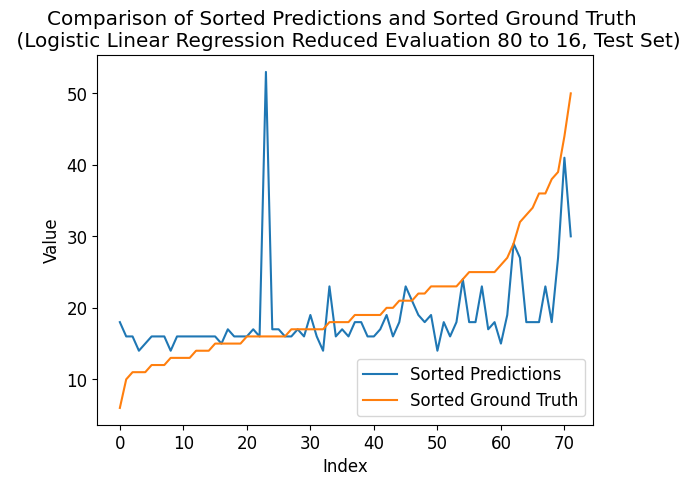

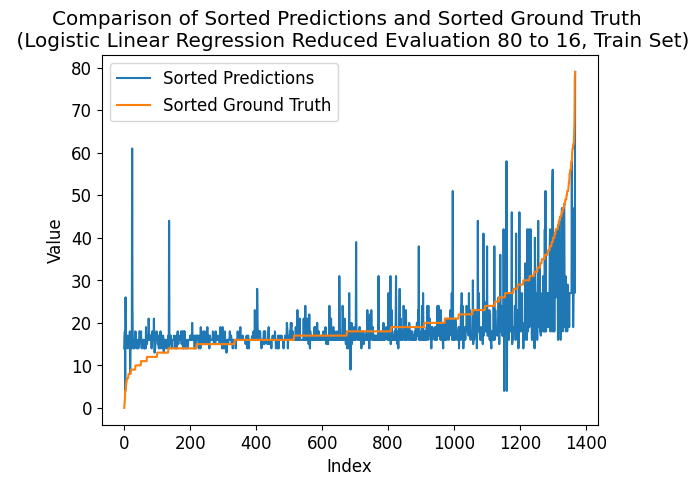

---- ---- ----
class_num = 96
Number of unique elements: 73
[ 0.  6. 12. 18. 24. 30. 36. 42. 48. 54. 60. 66. 72. 78. 84. 90. 96.]
test eval:
Mean squared error: 2.013888888888889
Correlation coefficient: 0.574200391756555
Coefficient of determination (R-squared score, R2 score): 0.24978442081057772
train eval:
Mean squared error: 2.3969298245614037
Correlation coefficient: 0.5652693896125474
Coefficient of determination (R-squared score, R2 score): 0.28018578534167515


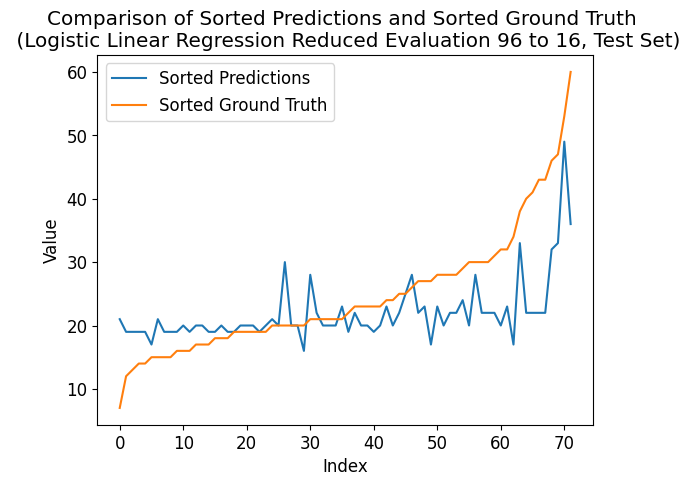

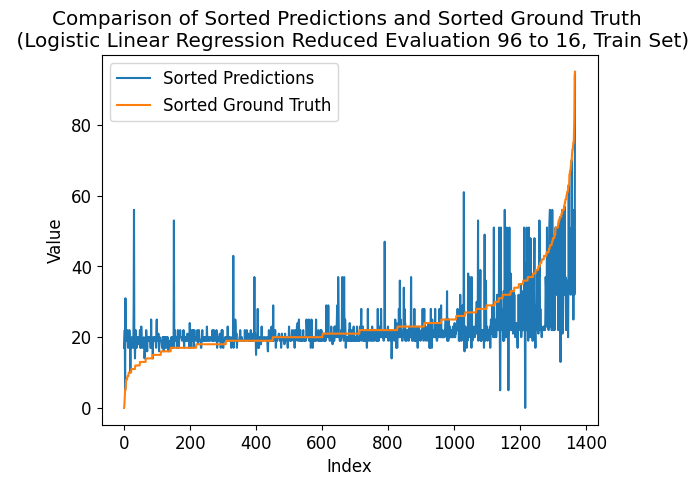

---- ---- ----
class_num = 112
Number of unique elements: 83


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[  0.   7.  14.  21.  28.  35.  42.  49.  56.  63.  70.  77.  84.  91.
  98. 105. 112.]
test eval:
Mean squared error: 2.1527777777777777
Correlation coefficient: 0.559468453615953
Coefficient of determination (R-squared score, R2 score): 0.19804541534923825
train eval:
Mean squared error: 2.445906432748538
Correlation coefficient: 0.5647315159636739
Coefficient of determination (R-squared score, R2 score): 0.2654777791257228


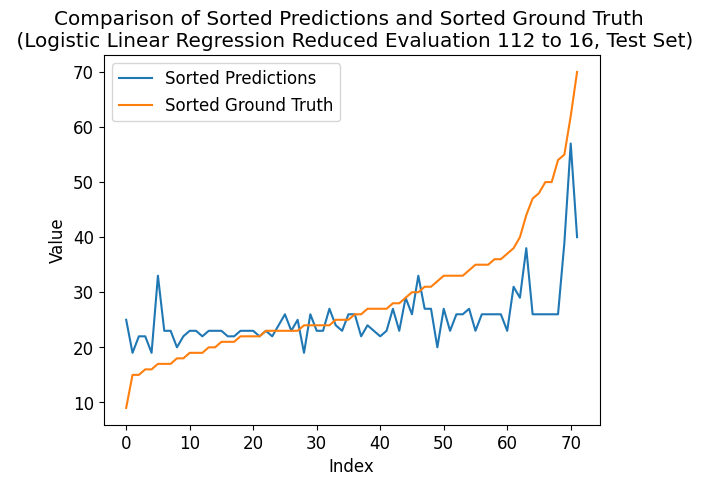

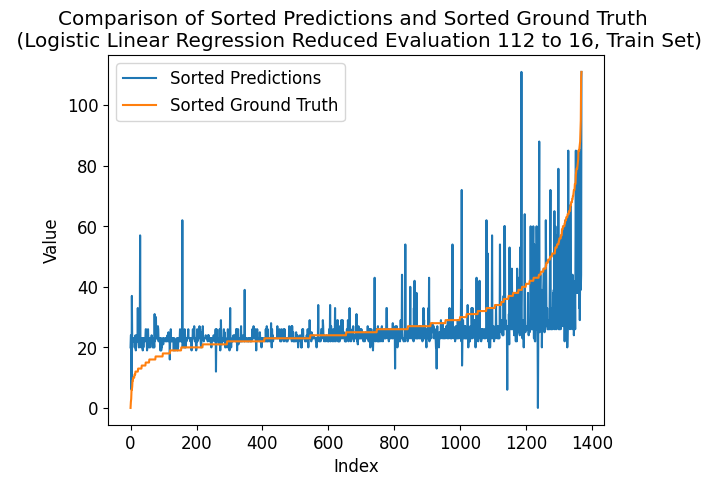

---- ---- ----
class_num = 128
Number of unique elements: 89
[  0.   8.  16.  24.  32.  40.  48.  56.  64.  72.  80.  88.  96. 104.
 112. 120. 128.]
test eval:
Mean squared error: 1.6388888888888888
Correlation coefficient: 0.6728130284811243
Coefficient of determination (R-squared score, R2 score): 0.3894797355561943
train eval:
Mean squared error: 2.3991228070175437
Correlation coefficient: 0.564618145292042
Coefficient of determination (R-squared score, R2 score): 0.2795272178991698


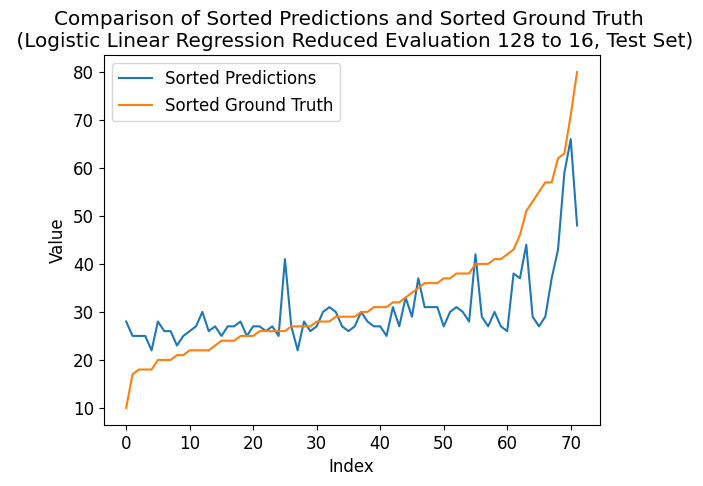

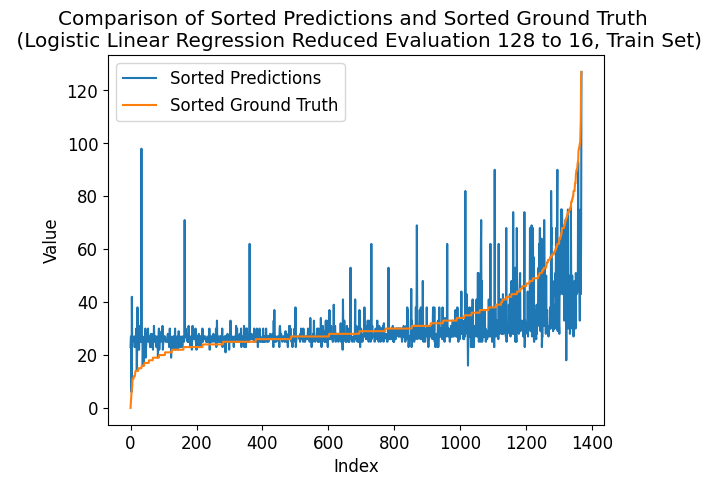

---- ---- ----
class_num = 144
Number of unique elements: 101
[  0.   9.  18.  27.  36.  45.  54.  63.  72.  81.  90.  99. 108. 117.
 126. 135. 144.]
test eval:
Mean squared error: 2.1666666666666665
Correlation coefficient: 0.556656457695954
Coefficient of determination (R-squared score, R2 score): 0.19287151480310427
train eval:
Mean squared error: 2.449561403508772
Correlation coefficient: 0.5531515352479683
Coefficient of determination (R-squared score, R2 score): 0.2643801667215472


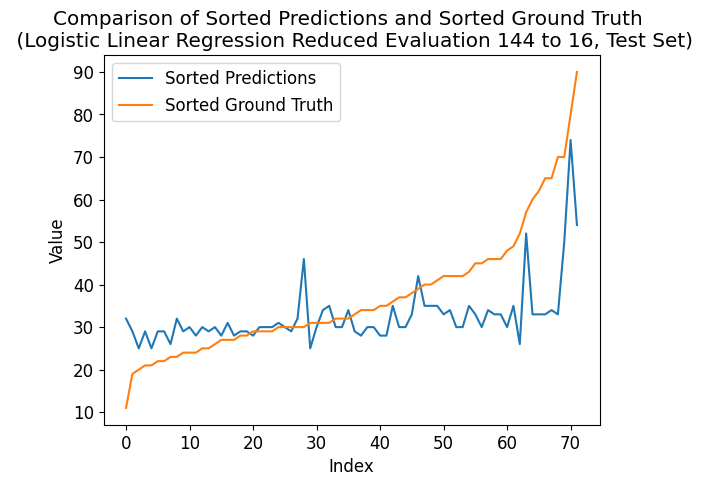

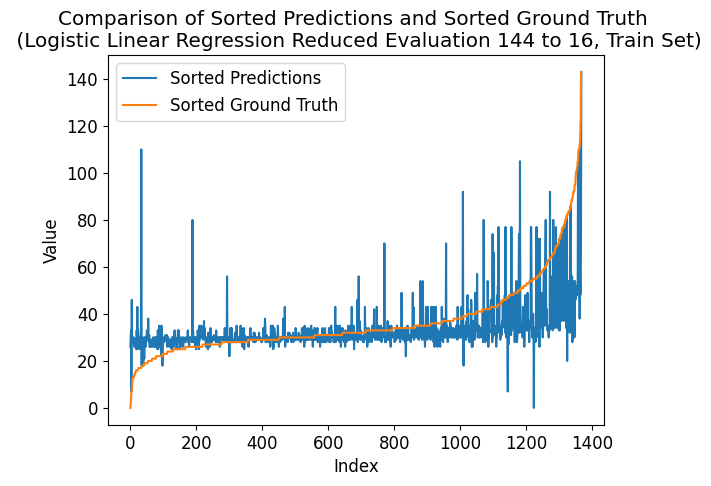

---- ---- ----
class_num = 160
Number of unique elements: 108
[  0.  10.  20.  30.  40.  50.  60.  70.  80.  90. 100. 110. 120. 130.
 140. 150. 160.]
test eval:
Mean squared error: 2.0972222222222223
Correlation coefficient: 0.5465982642615926
Coefficient of determination (R-squared score, R2 score): 0.21874101753377406
train eval:
Mean squared error: 2.439327485380117
Correlation coefficient: 0.5629090670841581
Coefficient of determination (R-squared score, R2 score): 0.2674534814532388


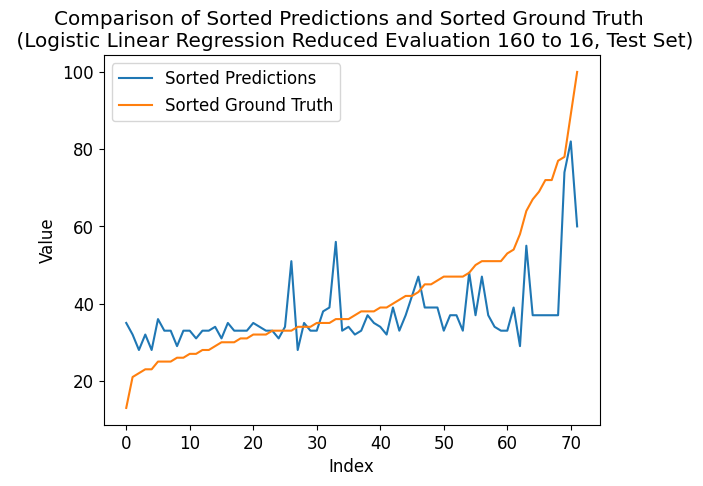

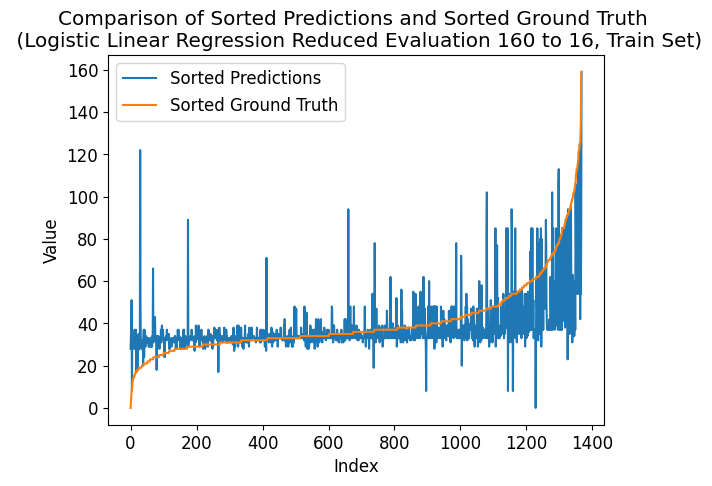

---- ---- ----
class_num = 176
Number of unique elements: 118
[  0.  11.  22.  33.  44.  55.  66.  77.  88.  99. 110. 121. 132. 143.
 154. 165. 176.]
test eval:
Mean squared error: 2.638888888888889
Correlation coefficient: 0.4423332877501636
Coefficient of determination (R-squared score, R2 score): 0.016958896234550158
train eval:
Mean squared error: 2.4407894736842106
Correlation coefficient: 0.561784805421915
Coefficient of determination (R-squared score, R2 score): 0.26701443649156853


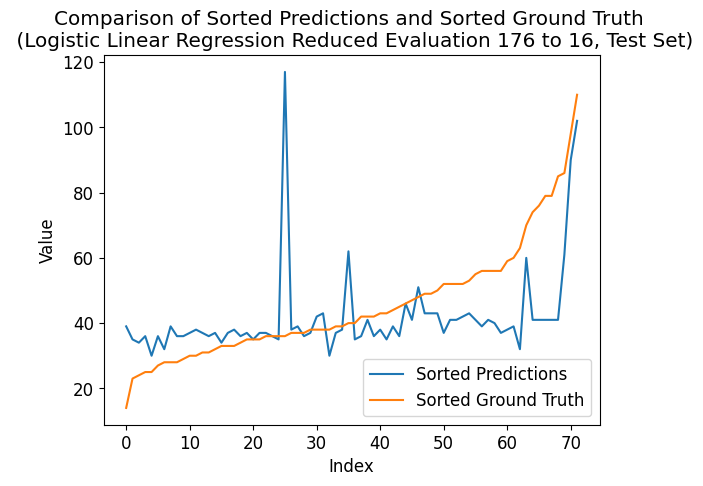

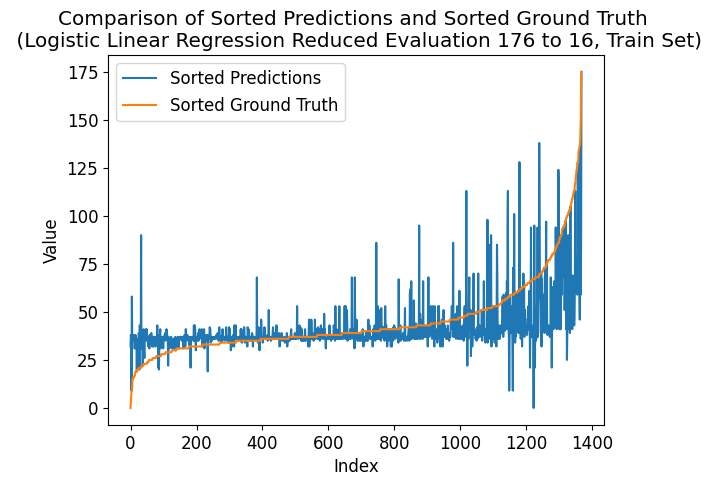

---- ---- ----
class_num = 192
Number of unique elements: 121
[  0.  12.  24.  36.  48.  60.  72.  84.  96. 108. 120. 132. 144. 156.
 168. 180. 192.]
test eval:
Mean squared error: 1.9722222222222223
Correlation coefficient: 0.5896722375656731
Coefficient of determination (R-squared score, R2 score): 0.26530612244897955
train eval:
Mean squared error: 2.3859649122807016
Correlation coefficient: 0.5717486862231805
Coefficient of determination (R-squared score, R2 score): 0.28347862255420175


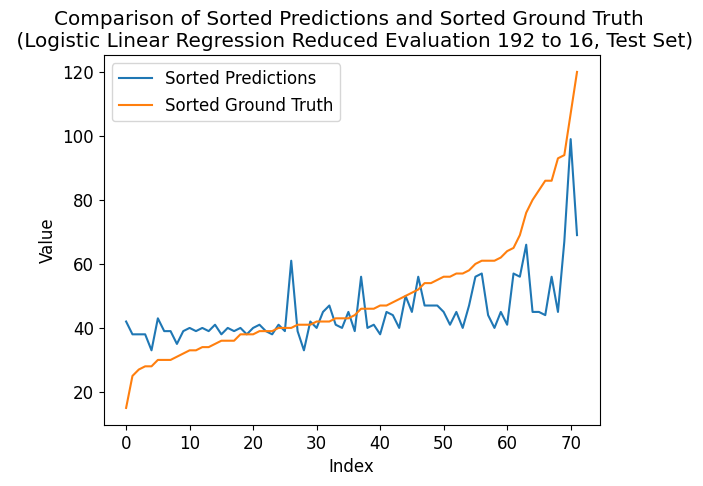

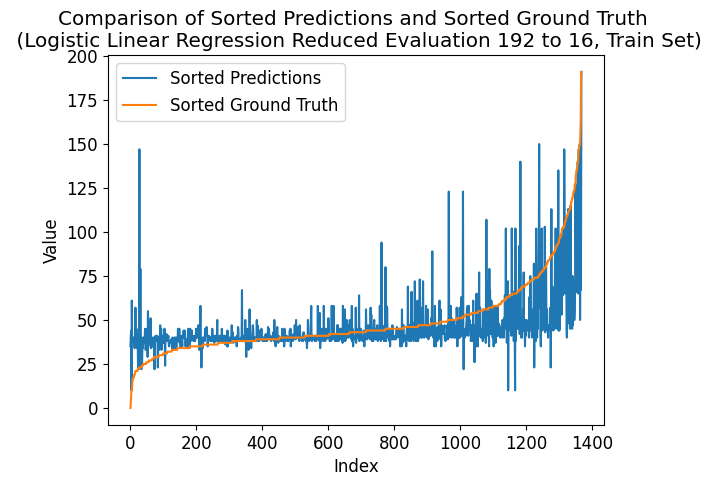

---- ---- ----
class_num = 208
Number of unique elements: 135
[  0.  13.  26.  39.  52.  65.  78.  91. 104. 117. 130. 143. 156. 169.
 182. 195. 208.]
test eval:
Mean squared error: 2.7083333333333335
Correlation coefficient: 0.381926475906906
Coefficient of determination (R-squared score, R2 score): -0.008910606496119522
train eval:
Mean squared error: 2.300438596491228
Correlation coefficient: 0.5931824452536202
Coefficient of determination (R-squared score, R2 score): 0.30916275281190964


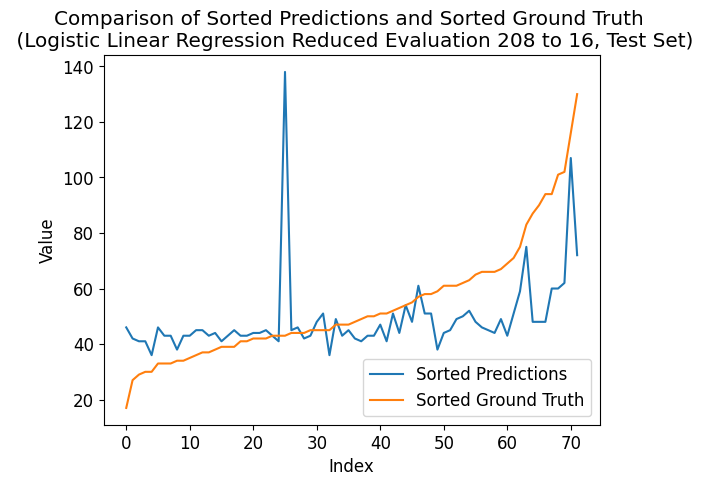

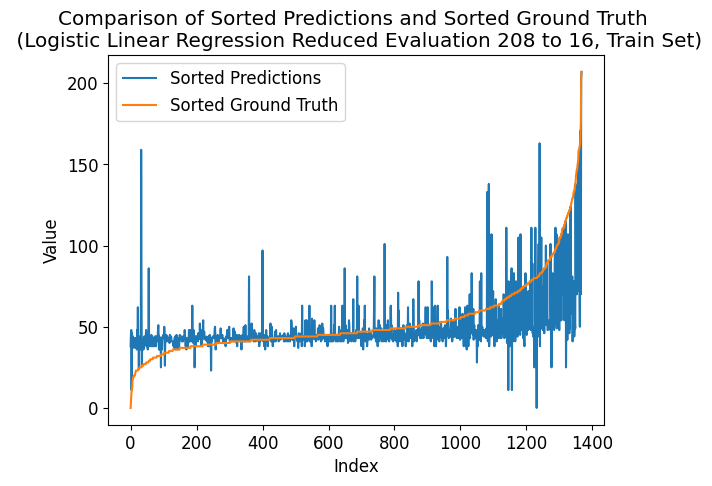

---- ---- ----
class_num = 224
Number of unique elements: 136
[  0.  14.  28.  42.  56.  70.  84.  98. 112. 126. 140. 154. 168. 182.
 196. 210. 224.]
test eval:
Mean squared error: 2.3333333333333335
Correlation coefficient: 0.49598614336376207
Coefficient of determination (R-squared score, R2 score): 0.13078470824949695
train eval:
Mean squared error: 2.5021929824561404
Correlation coefficient: 0.5504691323461698
Coefficient of determination (R-squared score, R2 score): 0.24857454810141932


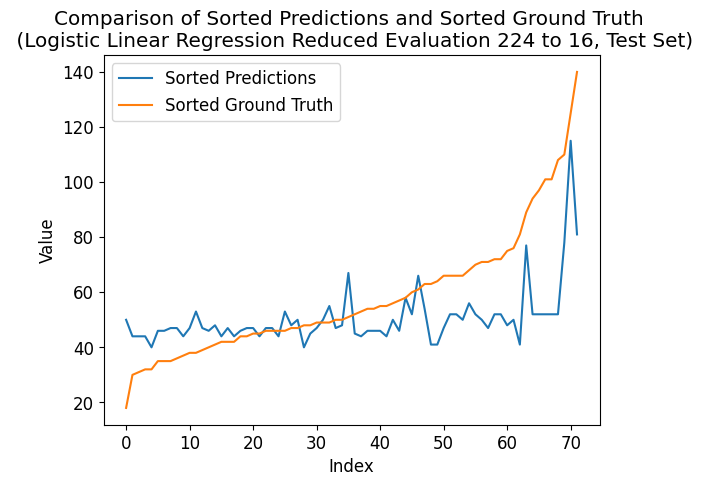

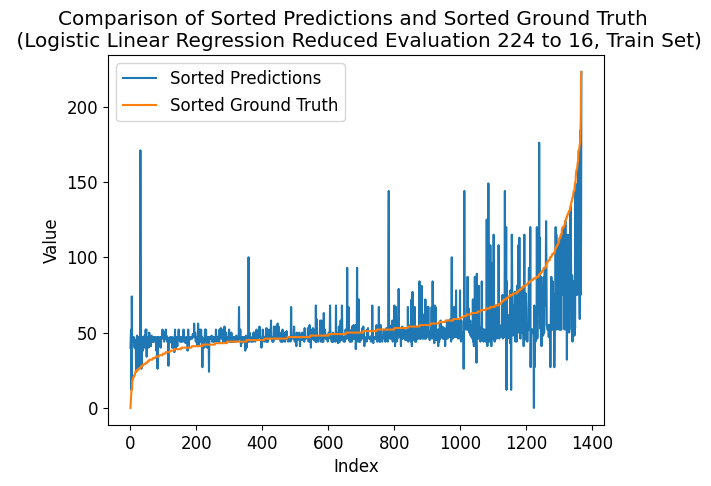

---- ---- ----
class_num = 240
Number of unique elements: 148
[  0.  15.  30.  45.  60.  75.  90. 105. 120. 135. 150. 165. 180. 195.
 210. 225. 240.]
test eval:
Mean squared error: 1.8472222222222223
Correlation coefficient: 0.6232947176419397
Coefficient of determination (R-squared score, R2 score): 0.31187122736418504
train eval:
Mean squared error: 2.31359649122807
Correlation coefficient: 0.58904522341209
Coefficient of determination (R-squared score, R2 score): 0.30521134815687767


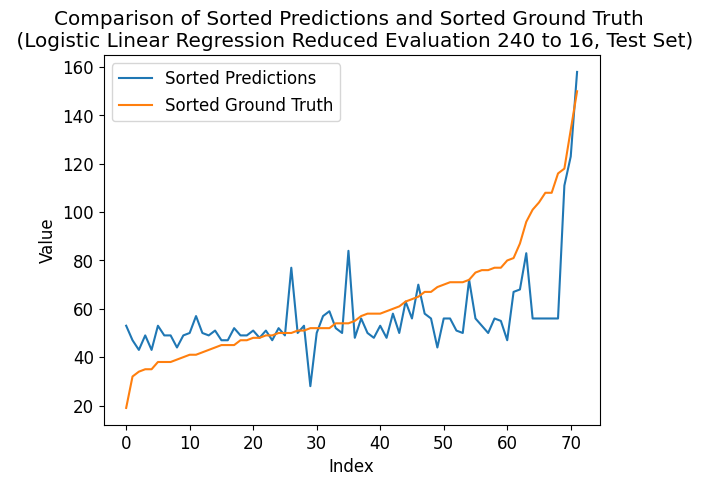

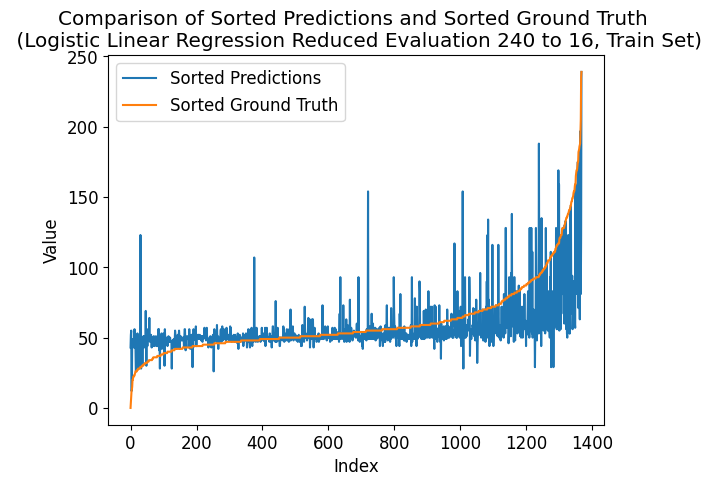

---- ---- ----
class_num = 256
Number of unique elements: 153
[  0.  16.  32.  48.  64.  80.  96. 112. 128. 144. 160. 176. 192. 208.
 224. 240. 256.]
test eval:
Mean squared error: 2.2083333333333335
Correlation coefficient: 0.5062987030082435
Coefficient of determination (R-squared score, R2 score): 0.17734981316470244
train eval:
Mean squared error: 2.421783625730994
Correlation coefficient: 0.5662612004171138
Coefficient of determination (R-squared score, R2 score): 0.27272202099328136


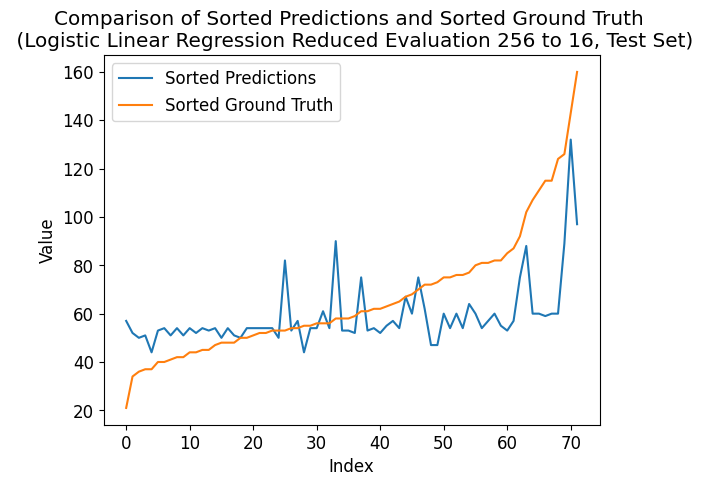

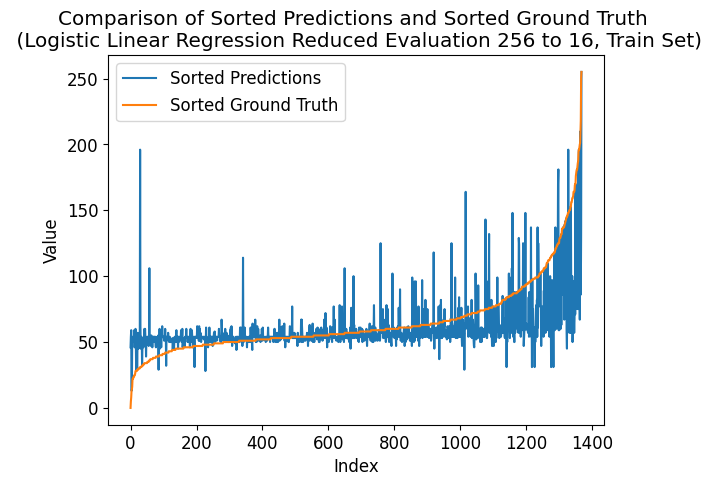

---- ---- ----
class_num = 272
Number of unique elements: 159
[  0.  17.  34.  51.  68.  85. 102. 119. 136. 153. 170. 187. 204. 221.
 238. 255. 272.]
test eval:
Mean squared error: 2.7777777777777777
Correlation coefficient: 0.47944573714704064
Coefficient of determination (R-squared score, R2 score): -0.034780109226789424
train eval:
Mean squared error: 2.334795321637427
Correlation coefficient: 0.5862781592843963
Coefficient of determination (R-squared score, R2 score): 0.2988451962126595


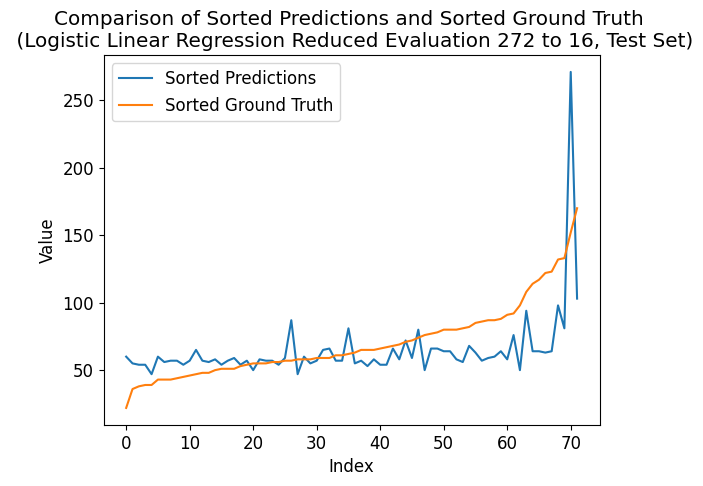

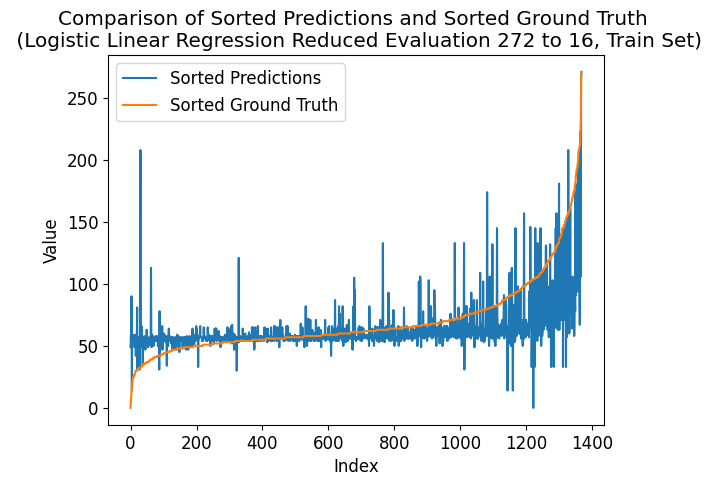

---- ---- ----
class_num = 288
Number of unique elements: 166
[  0.  18.  36.  54.  72.  90. 108. 126. 144. 162. 180. 198. 216. 234.
 252. 270. 288.]
test eval:
Mean squared error: 2.3194444444444446
Correlation coefficient: 0.5067113927060042
Coefficient of determination (R-squared score, R2 score): 0.13595860879563093
train eval:
Mean squared error: 2.4108187134502925
Correlation coefficient: 0.5718047040737763
Coefficient of determination (R-squared score, R2 score): 0.27601485820580807


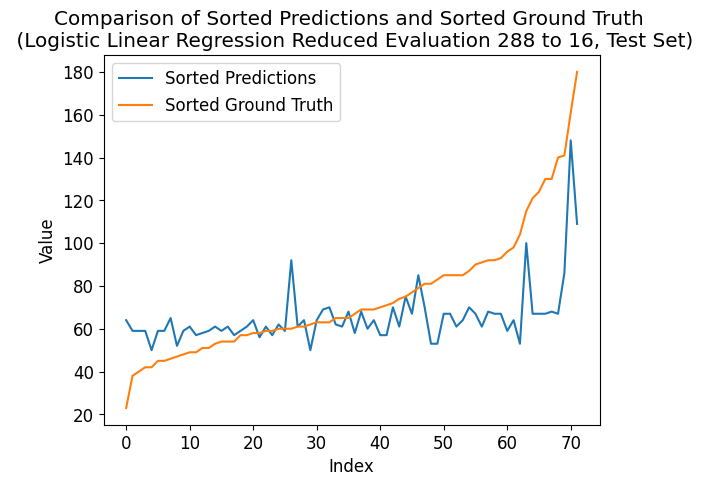

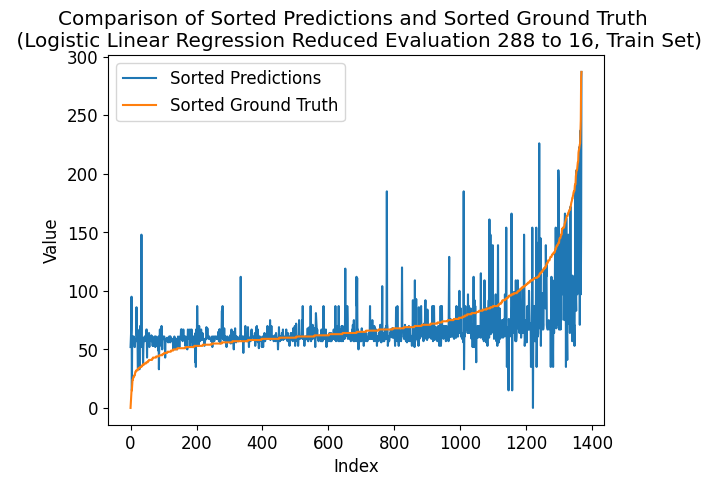

---- ---- ----
class_num = 304
Number of unique elements: 175
[  0.  19.  38.  57.  76.  95. 114. 133. 152. 171. 190. 209. 228. 247.
 266. 285. 304.]
test eval:
Mean squared error: 2.2777777777777777
Correlation coefficient: 0.5052659366734309
Coefficient of determination (R-squared score, R2 score): 0.15148031043403276
train eval:
Mean squared error: 2.4247076023391814
Correlation coefficient: 0.5650637081685518
Coefficient of determination (R-squared score, R2 score): 0.271843931069941


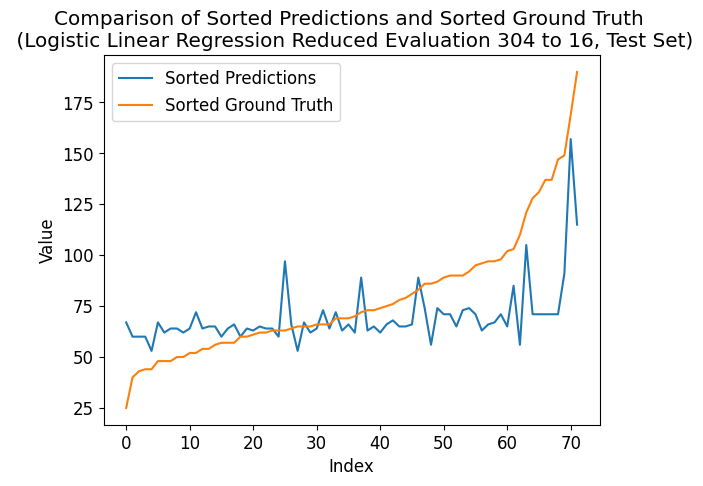

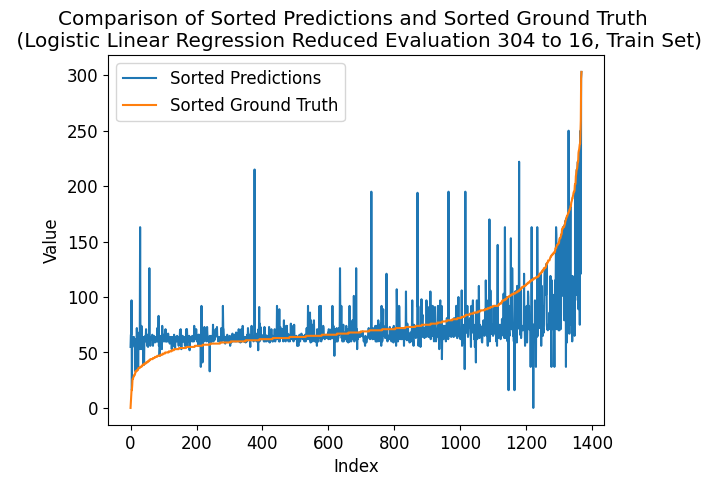

---- ---- ----
class_num = 320
Number of unique elements: 176
[  0.  20.  40.  60.  80. 100. 120. 140. 160. 180. 200. 220. 240. 260.
 280. 300. 320.]
test eval:
Mean squared error: 3.388888888888889
Correlation coefficient: 0.42901532504062145
Coefficient of determination (R-squared score, R2 score): -0.262431733256683
train eval:
Mean squared error: 2.2646198830409356
Correlation coefficient: 0.6019371625796435
Coefficient of determination (R-squared score, R2 score): 0.31991935437283003


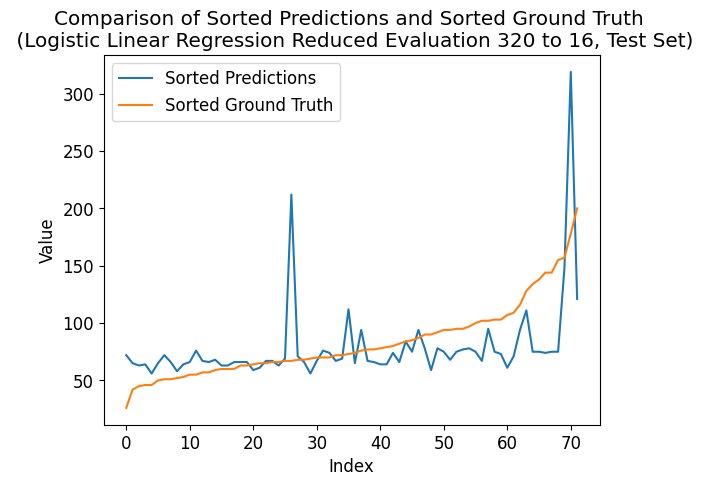

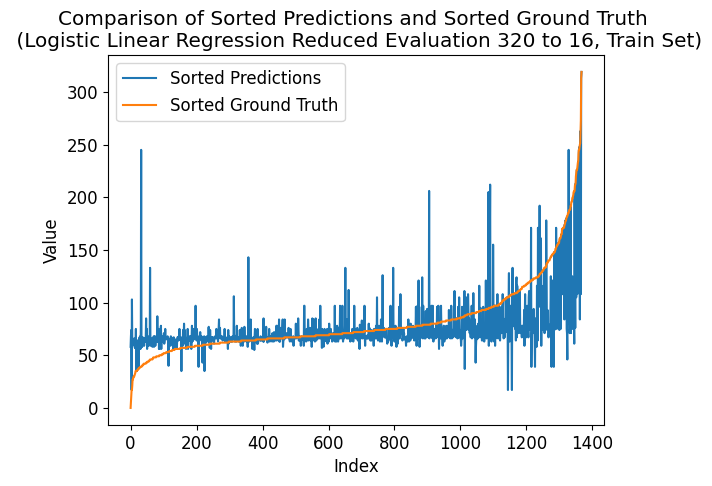

---- ---- ----
class_num = 336
Number of unique elements: 183
[  0.  21.  42.  63.  84. 105. 126. 147. 168. 189. 210. 231. 252. 273.
 294. 315. 336.]
test eval:
Mean squared error: 2.9305555555555554
Correlation coefficient: 0.35212290368900995
Coefficient of determination (R-squared score, R2 score): -0.09169301523426276
train eval:
Mean squared error: 2.402046783625731
Correlation coefficient: 0.5691178512407882
Coefficient of determination (R-squared score, R2 score): 0.2786491279758293


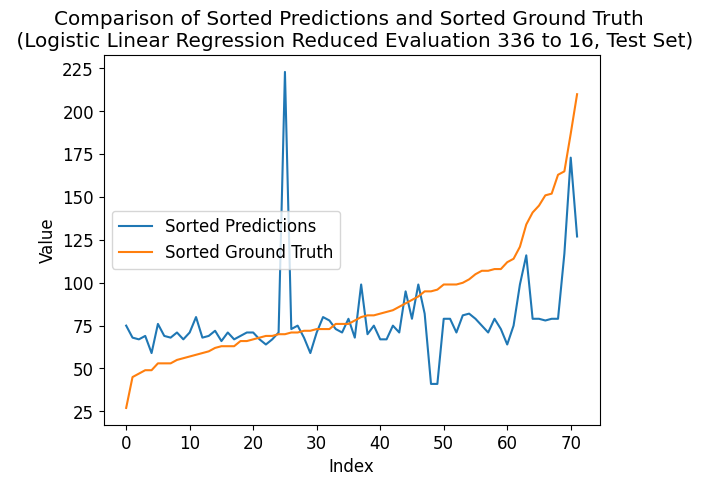

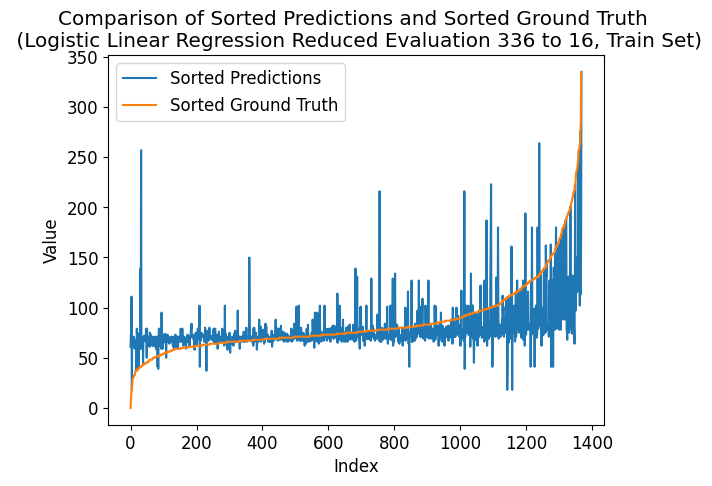

---- ---- ----
class_num = 352
Number of unique elements: 194
[  0.  22.  44.  66.  88. 110. 132. 154. 176. 198. 220. 242. 264. 286.
 308. 330. 352.]
test eval:
Mean squared error: 2.6944444444444446
Correlation coefficient: 0.3526436927204591
Coefficient of determination (R-squared score, R2 score): -0.0037367059499857636
train eval:
Mean squared error: 2.211988304093567
Correlation coefficient: 0.6140512716144444
Coefficient of determination (R-squared score, R2 score): 0.3357249729929579


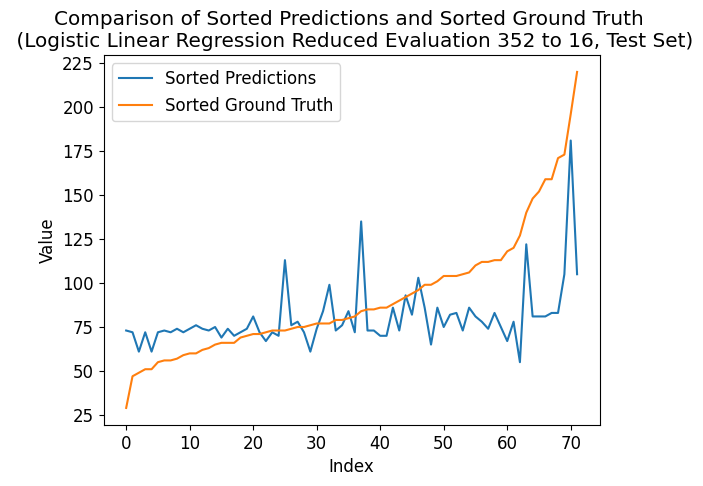

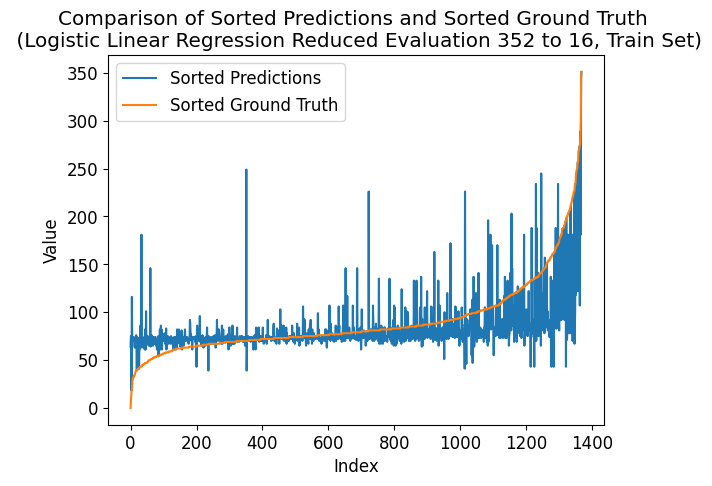

---- ---- ----
class_num = 368
Number of unique elements: 198
[  0.  23.  46.  69.  92. 115. 138. 161. 184. 207. 230. 253. 276. 299.
 322. 345. 368.]
test eval:
Mean squared error: 3.361111111111111
Correlation coefficient: 0.23843095241228807
Coefficient of determination (R-squared score, R2 score): -0.25208393216441505
train eval:
Mean squared error: 2.2850877192982457
Correlation coefficient: 0.594312840825534
Coefficient of determination (R-squared score, R2 score): 0.31377272490944697


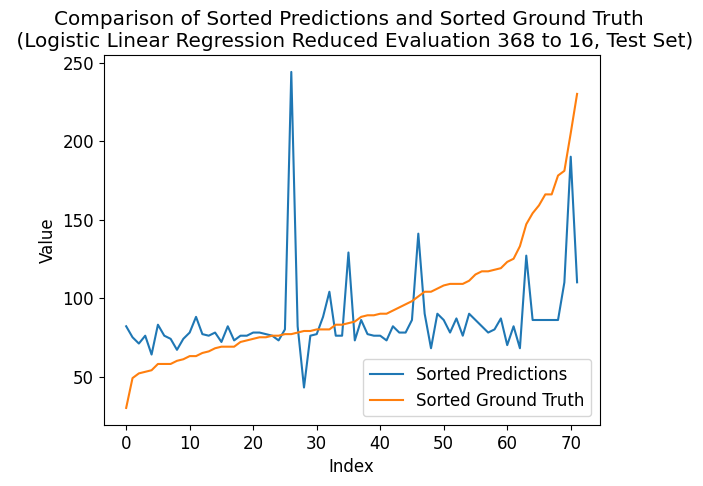

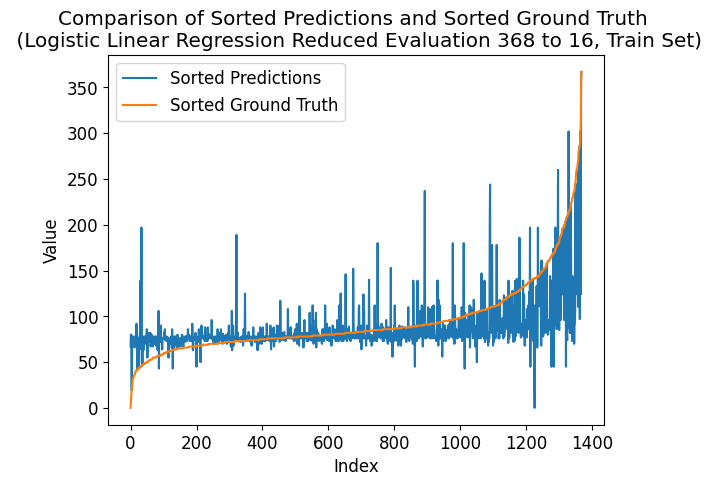

---- ---- ----
class_num = 384
Number of unique elements: 201
[  0.  24.  48.  72.  96. 120. 144. 168. 192. 216. 240. 264. 288. 312.
 336. 360. 384.]
test eval:
Mean squared error: 2.8333333333333335
Correlation coefficient: 0.4183999454486279
Coefficient of determination (R-squared score, R2 score): -0.055475711411325124
train eval:
Mean squared error: 2.3947368421052633
Correlation coefficient: 0.5722532597221422
Coefficient of determination (R-squared score, R2 score): 0.2808443527841804


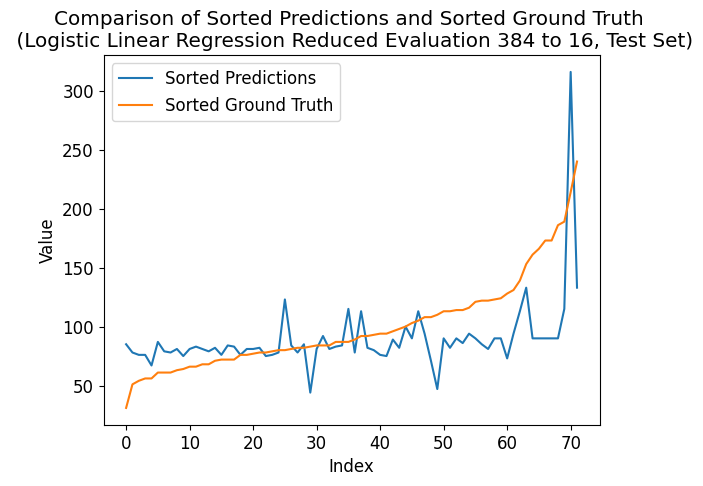

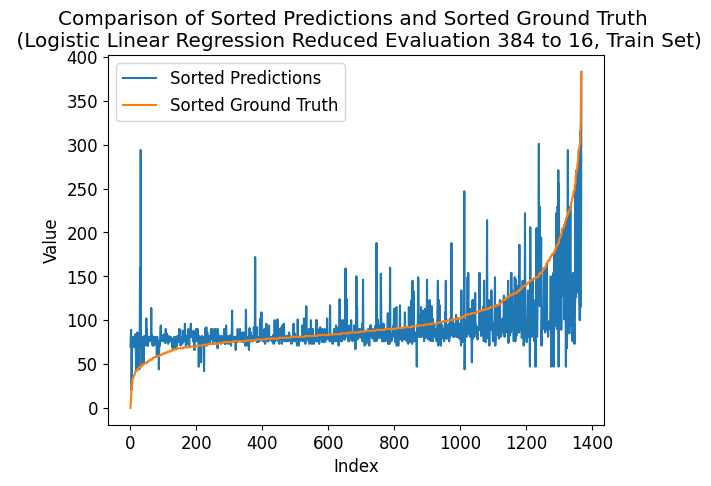

---- ---- ----
class_num = 400
Number of unique elements: 211
[  0.  25.  50.  75. 100. 125. 150. 175. 200. 225. 250. 275. 300. 325.
 350. 375. 400.]
test eval:
Mean squared error: 1.8194444444444444
Correlation coefficient: 0.6334678432507554
Coefficient of determination (R-squared score, R2 score): 0.322219028456453
train eval:
Mean squared error: 2.3472222222222223
Correlation coefficient: 0.5789381618541263
Coefficient of determination (R-squared score, R2 score): 0.29511331403846264


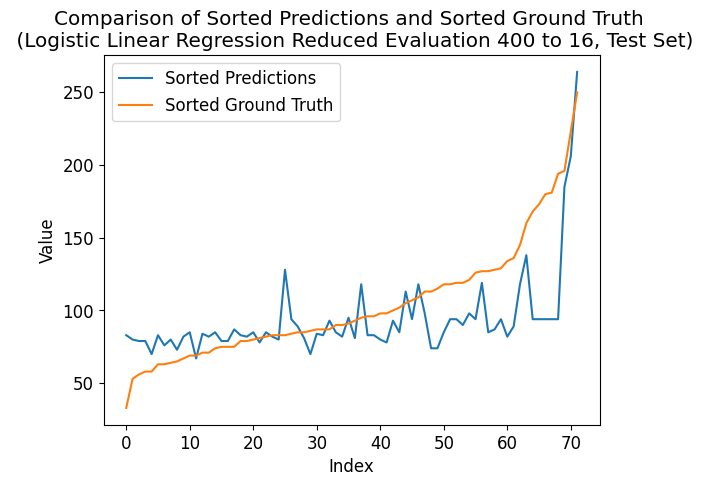

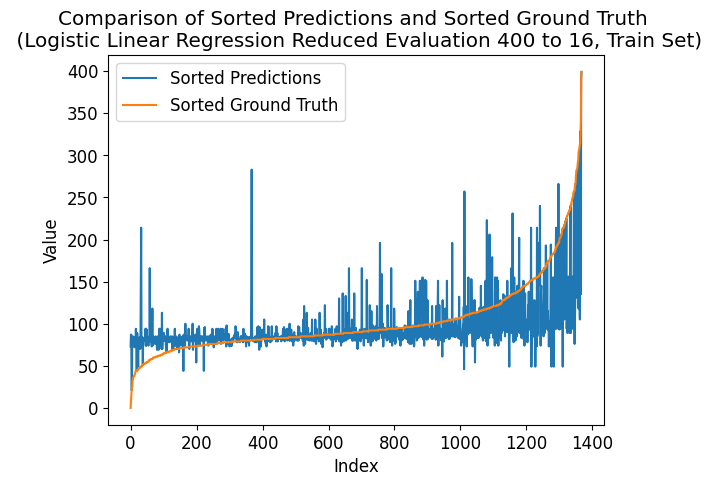

---- ---- ----
class_num = 416
Number of unique elements: 217
[  0.  26.  52.  78. 104. 130. 156. 182. 208. 234. 260. 286. 312. 338.
 364. 390. 416.]
test eval:
Mean squared error: 2.8333333333333335
Correlation coefficient: 0.3625352404709058
Coefficient of determination (R-squared score, R2 score): -0.055475711411325124
train eval:
Mean squared error: 2.2244152046783627
Correlation coefficient: 0.60545034102102
Coefficient of determination (R-squared score, R2 score): 0.33199309081876105


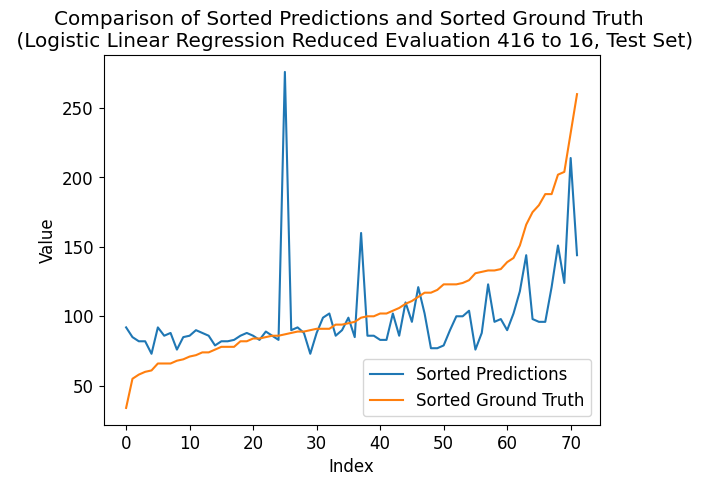

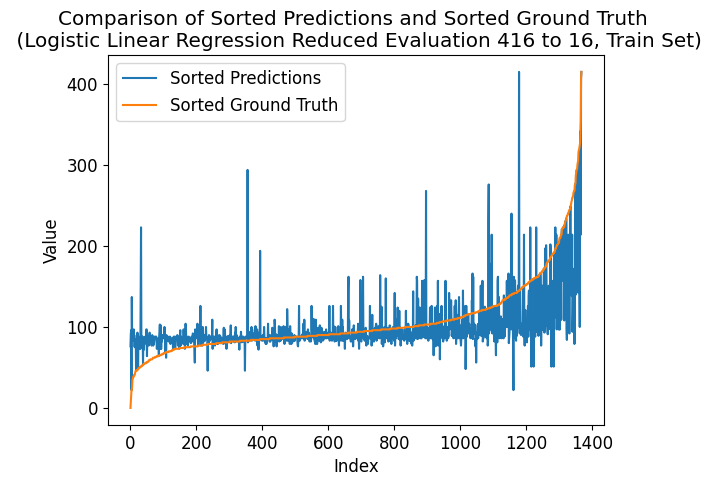

---- ---- ----
class_num = 432
Number of unique elements: 216
[  0.  27.  54.  81. 108. 135. 162. 189. 216. 243. 270. 297. 324. 351.
 378. 405. 432.]
test eval:
Mean squared error: 3.2222222222222223
Correlation coefficient: 0.26179074166889704
Coefficient of determination (R-squared score, R2 score): -0.2003449267030757
train eval:
Mean squared error: 2.3391812865497075
Correlation coefficient: 0.5835550085902215
Coefficient of determination (R-squared score, R2 score): 0.29752806132764875


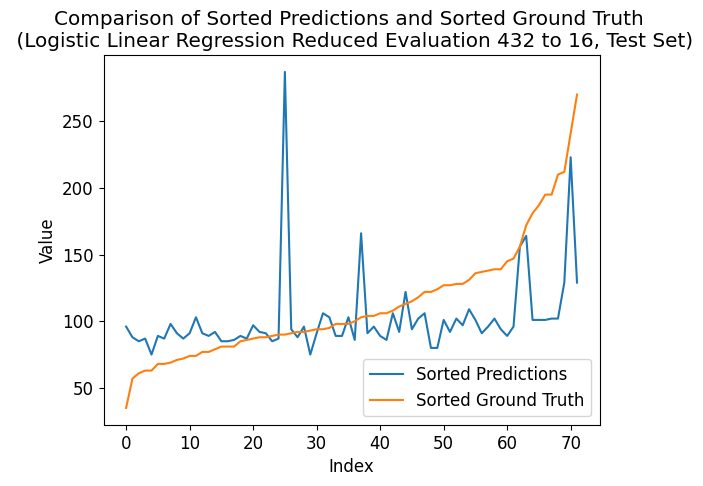

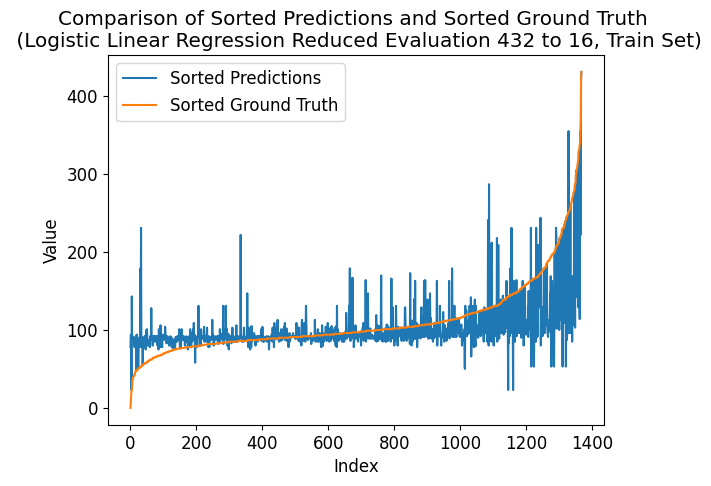

---- ---- ----
class_num = 448
Number of unique elements: 217
[  0.  28.  56.  84. 112. 140. 168. 196. 224. 252. 280. 308. 336. 364.
 392. 420. 448.]
test eval:
Mean squared error: 3.0416666666666665
Correlation coefficient: 0.2899062653147234
Coefficient of determination (R-squared score, R2 score): -0.13308421960333439
train eval:
Mean squared error: 2.3494152046783627
Correlation coefficient: 0.5847251202625734
Coefficient of determination (R-squared score, R2 score): 0.2944547465959573


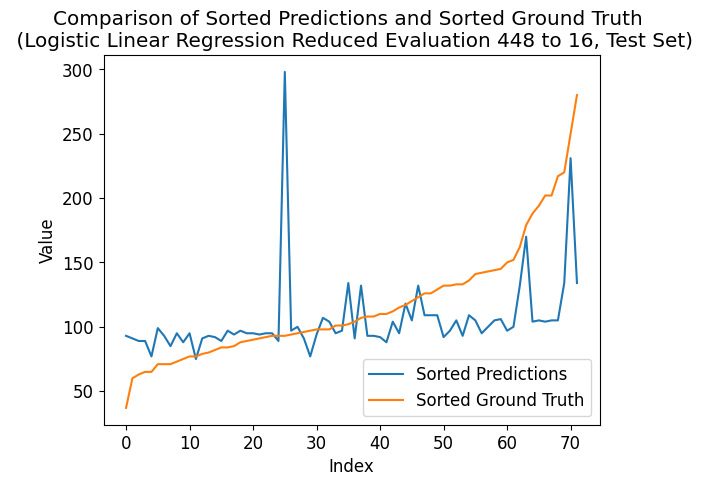

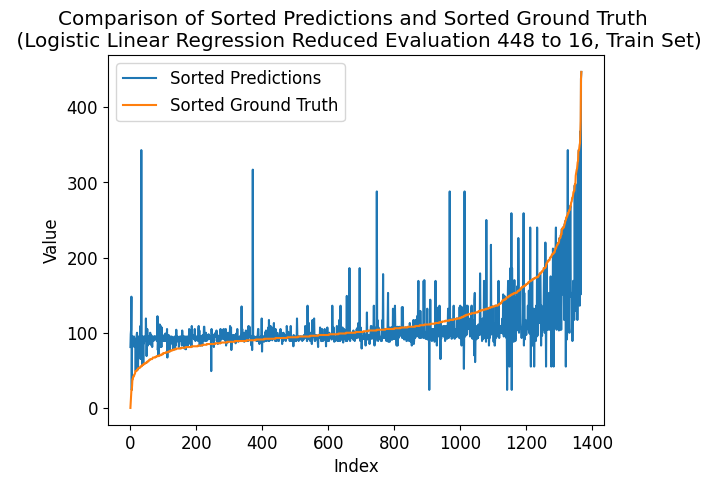

---- ---- ----
class_num = 464
Number of unique elements: 234
[  0.  29.  58.  87. 116. 145. 174. 203. 232. 261. 290. 319. 348. 377.
 406. 435. 464.]
test eval:
Mean squared error: 2.9027777777777777
Correlation coefficient: 0.3315168351866335
Coefficient of determination (R-squared score, R2 score): -0.0813452141419948
train eval:
Mean squared error: 2.277046783625731
Correlation coefficient: 0.5985283297418744
Coefficient of determination (R-squared score, R2 score): 0.3161874721986331


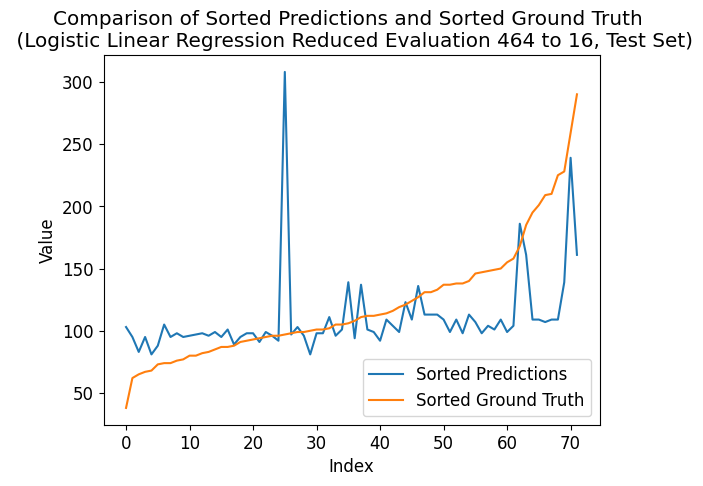

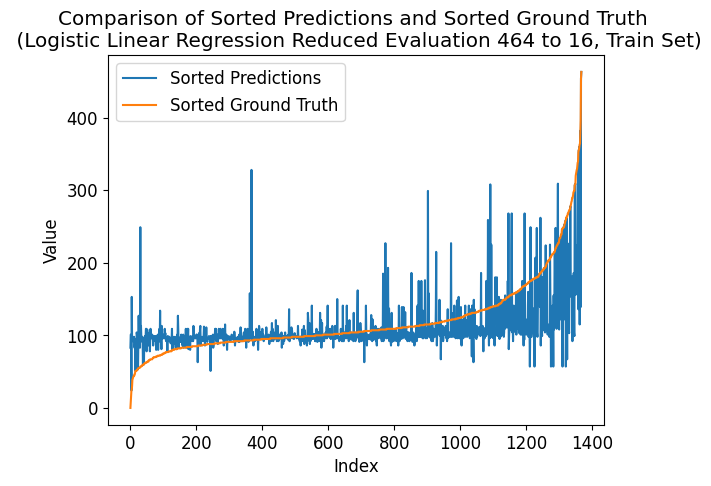

---- ---- ----
class_num = 480
Number of unique elements: 232
[  0.  30.  60.  90. 120. 150. 180. 210. 240. 270. 300. 330. 360. 390.
 420. 450. 480.]
test eval:
Mean squared error: 1.8611111111111112
Correlation coefficient: 0.6044187652504551
Coefficient of determination (R-squared score, R2 score): 0.3066973268180512
train eval:
Mean squared error: 2.1637426900584797
Correlation coefficient: 0.6209554649484783
Coefficient of determination (R-squared score, R2 score): 0.35021345672807513


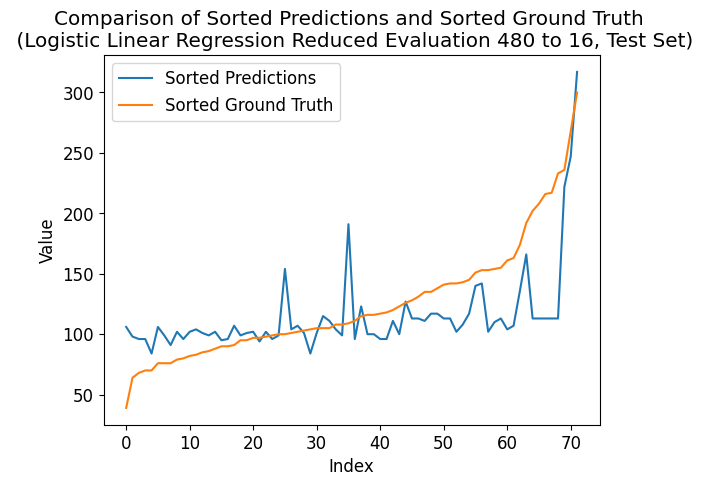

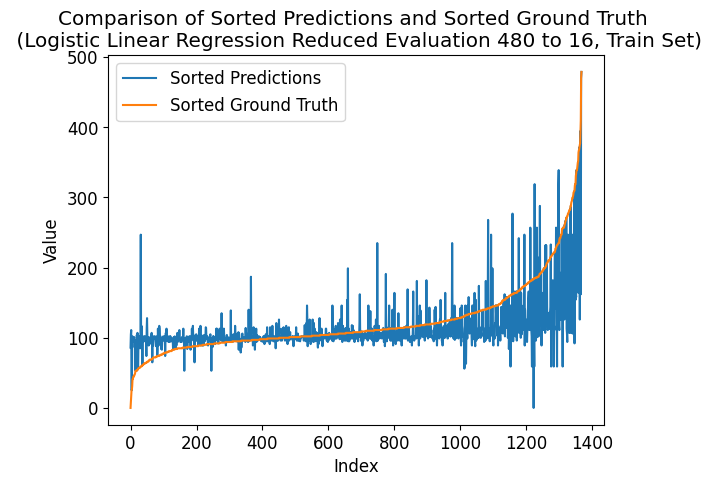

---- ---- ----
class_num = 496
Number of unique elements: 240
[  0.  31.  62.  93. 124. 155. 186. 217. 248. 279. 310. 341. 372. 403.
 434. 465. 496.]
test eval:
Mean squared error: 2.3333333333333335
Correlation coefficient: 0.45862334360689305
Coefficient of determination (R-squared score, R2 score): 0.13078470824949695
train eval:
Mean squared error: 2.172514619883041
Correlation coefficient: 0.6165784766060715
Coefficient of determination (R-squared score, R2 score): 0.3475791869580538


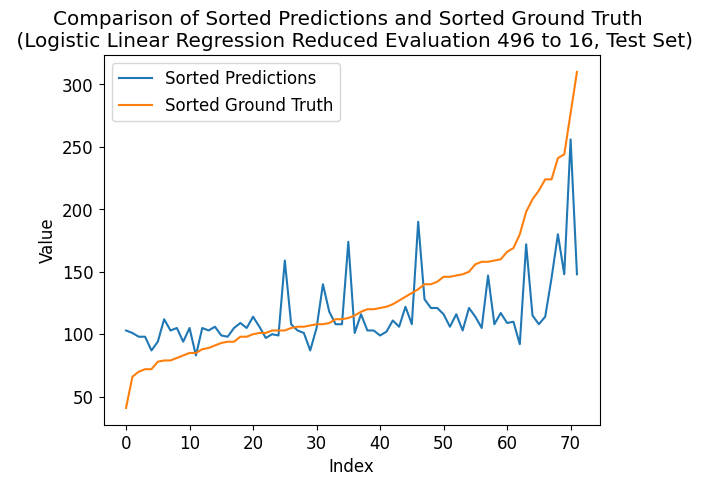

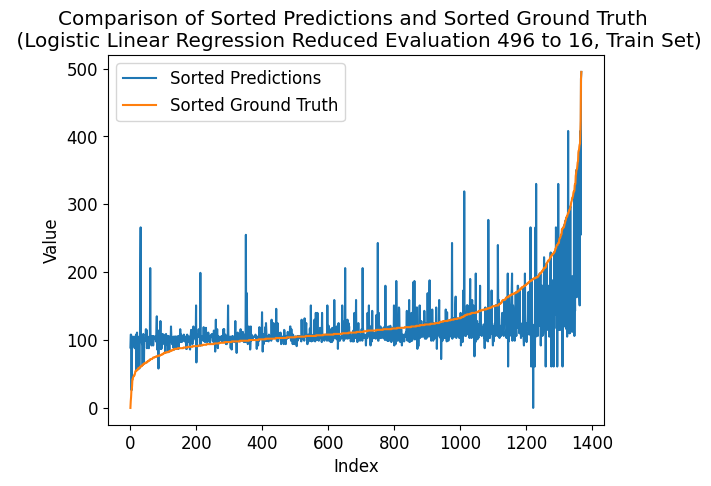

---- ---- ----
class_num = 512
Number of unique elements: 246
[  0.  32.  64.  96. 128. 160. 192. 224. 256. 288. 320. 352. 384. 416.
 448. 480. 512.]
test eval:
Mean squared error: 3.736111111111111
Correlation coefficient: 0.33183429061032527
Coefficient of determination (R-squared score, R2 score): -0.39177924691003163
train eval:
Mean squared error: 2.317982456140351
Correlation coefficient: 0.5858418649268451
Coefficient of determination (R-squared score, R2 score): 0.30389421327186694


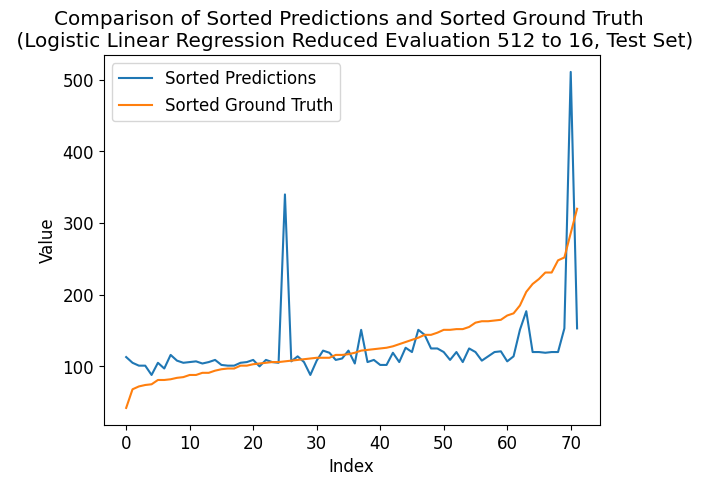

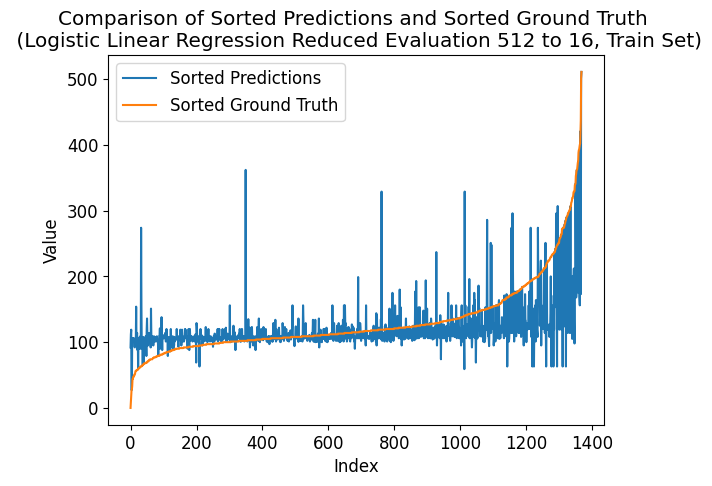

---- ---- ----
class_num = 528
Number of unique elements: 249
[  0.  33.  66.  99. 132. 165. 198. 231. 264. 297. 330. 363. 396. 429.
 462. 495. 528.]
test eval:
Mean squared error: 3.236111111111111
Correlation coefficient: 0.24117055473059854
Coefficient of determination (R-squared score, R2 score): -0.20551882724920967
train eval:
Mean squared error: 2.02046783625731
Correlation coefficient: 0.6467845982349959
Coefficient of determination (R-squared score, R2 score): 0.3932398629717566


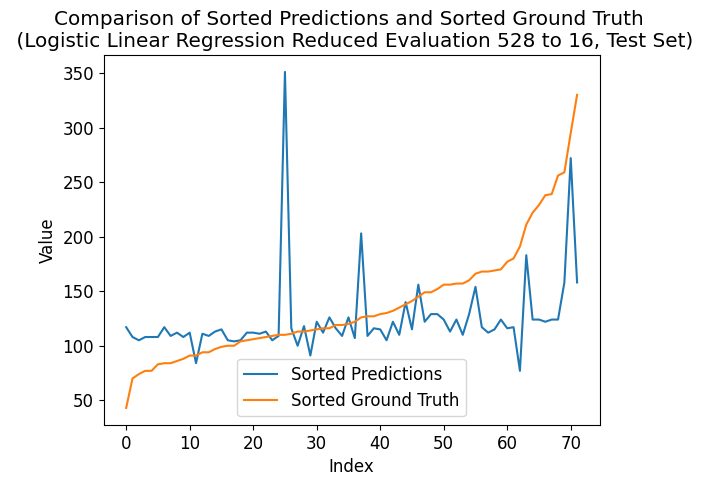

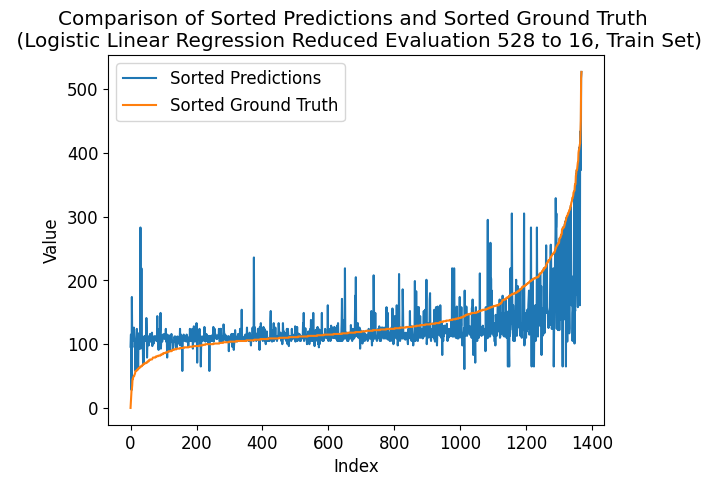

---- ---- ----
class_num = 544
Number of unique elements: 253
[  0.  34.  68. 102. 136. 170. 204. 238. 272. 306. 340. 374. 408. 442.
 476. 510. 544.]
test eval:
Mean squared error: 2.3333333333333335
Correlation coefficient: 0.5170574935265199
Coefficient of determination (R-squared score, R2 score): 0.13078470824949695
train eval:
Mean squared error: 2.171783625730994
Correlation coefficient: 0.6242096204862637
Coefficient of determination (R-squared score, R2 score): 0.3477987094388889


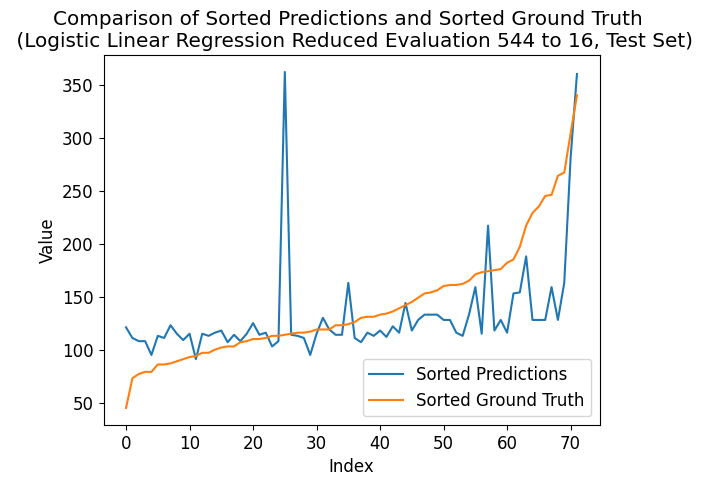

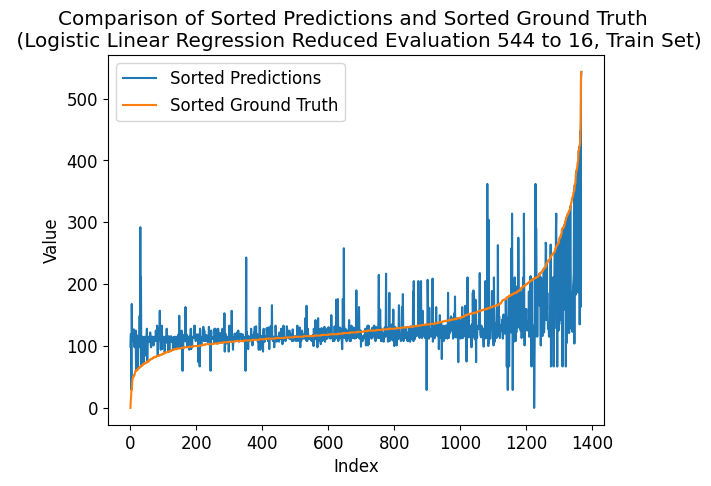

---- ---- ----
class_num = 560
Number of unique elements: 256
[  0.  35.  70. 105. 140. 175. 210. 245. 280. 315. 350. 385. 420. 455.
 490. 525. 560.]
test eval:
Mean squared error: 2.4722222222222223
Correlation coefficient: 0.5085671018594541
Coefficient of determination (R-squared score, R2 score): 0.07904570278815748
train eval:
Mean squared error: 2.388157894736842
Correlation coefficient: 0.5758665349251176
Coefficient of determination (R-squared score, R2 score): 0.2828200551116964


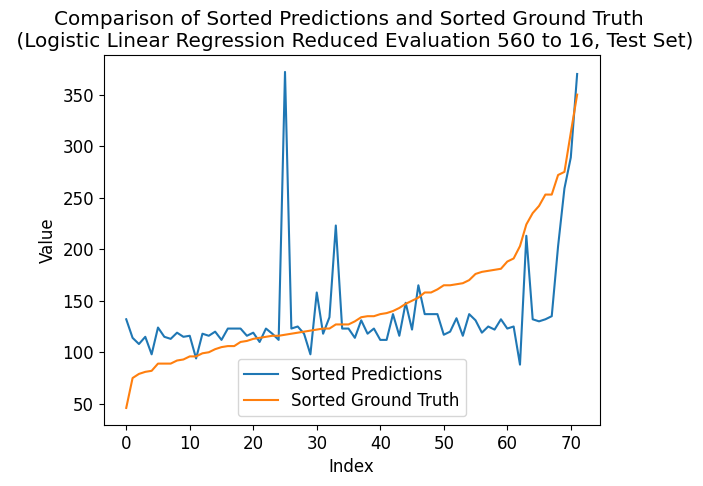

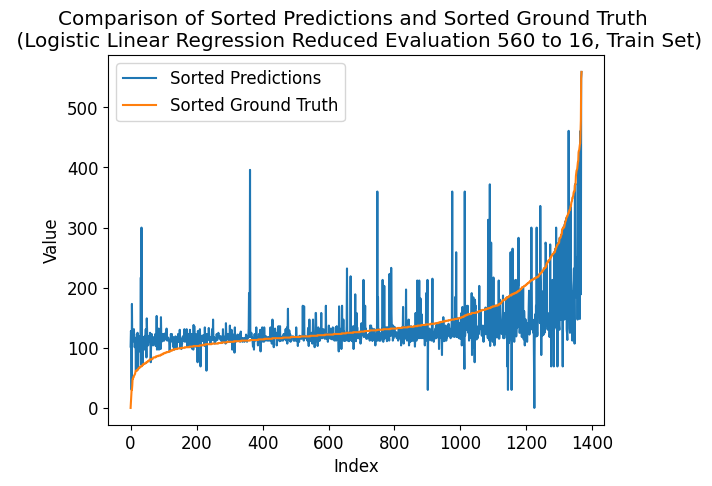

---- ---- ----
class_num = 576
Number of unique elements: 265
[  0.  36.  72. 108. 144. 180. 216. 252. 288. 324. 360. 396. 432. 468.
 504. 540. 576.]
test eval:
Mean squared error: 1.5555555555555556
Correlation coefficient: 0.6799288354108487
Coefficient of determination (R-squared score, R2 score): 0.42052313883299797
train eval:
Mean squared error: 2.1637426900584797
Correlation coefficient: 0.6196600132624361
Coefficient of determination (R-squared score, R2 score): 0.35021345672807513


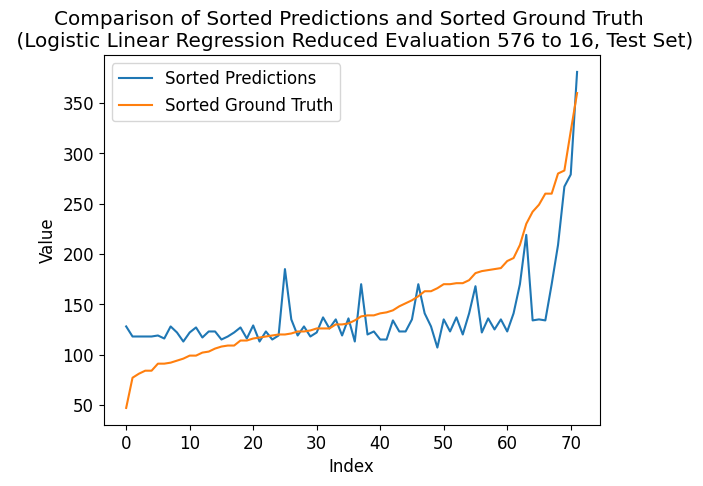

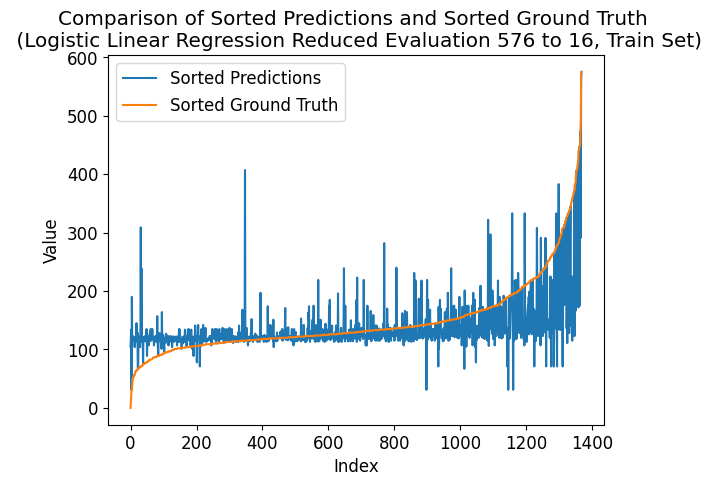

---- ---- ----
class_num = 592
Number of unique elements: 267
[  0.  37.  74. 111. 148. 185. 222. 259. 296. 333. 370. 407. 444. 481.
 518. 555. 592.]
test eval:
Mean squared error: 2.5555555555555554
Correlation coefficient: 0.39412706715166135
Coefficient of determination (R-squared score, R2 score): 0.04800229951135382
train eval:
Mean squared error: 2.211988304093567
Correlation coefficient: 0.6125396877217594
Coefficient of determination (R-squared score, R2 score): 0.3357249729929579


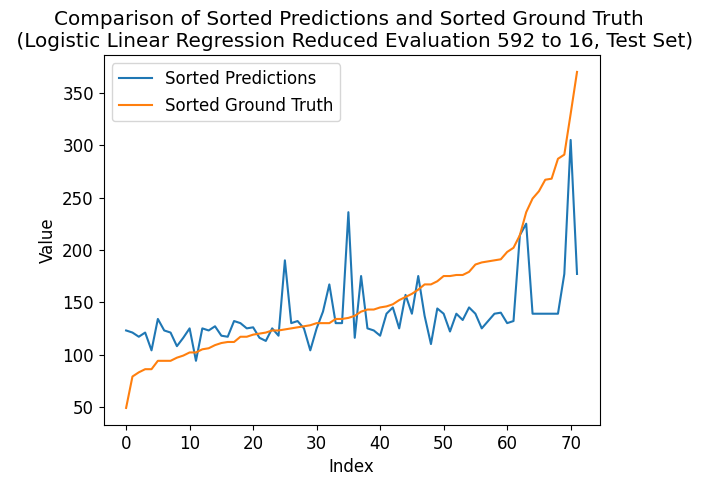

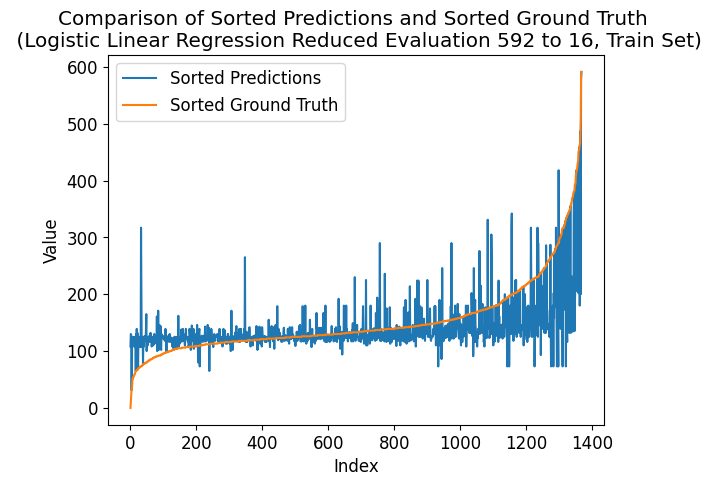

---- ---- ----
class_num = 608
Number of unique elements: 274
[  0.  38.  76. 114. 152. 190. 228. 266. 304. 342. 380. 418. 456. 494.
 532. 570. 608.]
test eval:
Mean squared error: 2.4166666666666665
Correlation coefficient: 0.46340267404870455
Coefficient of determination (R-squared score, R2 score): 0.09974130497269329
train eval:
Mean squared error: 2.202485380116959
Correlation coefficient: 0.6141831859146629
Coefficient of determination (R-squared score, R2 score): 0.33857876524381436


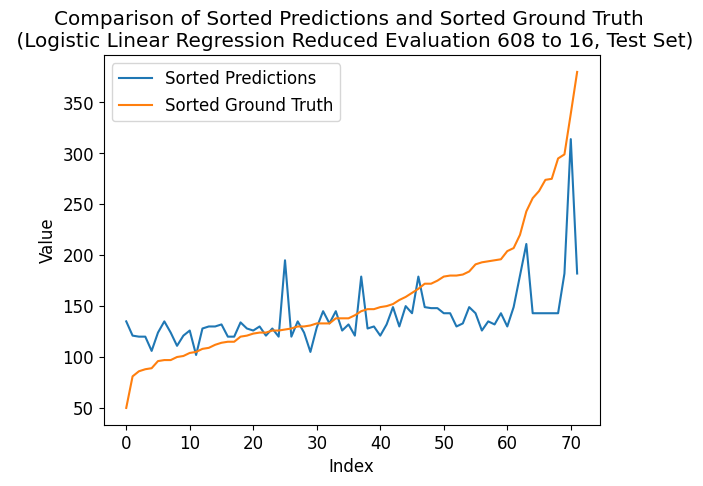

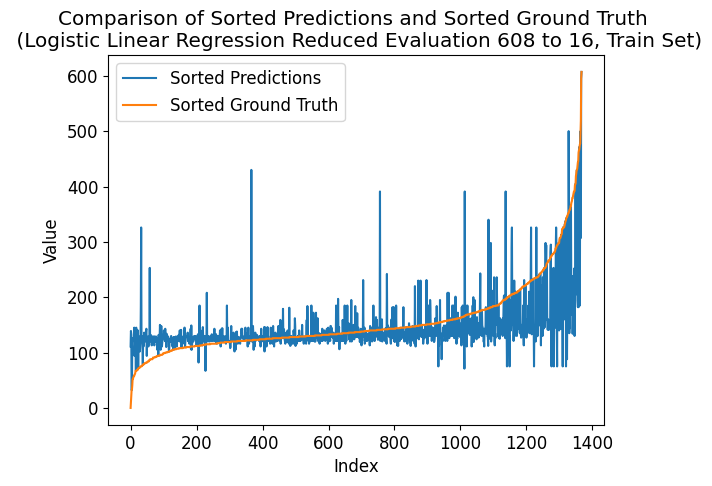

---- ---- ----
class_num = 624
Number of unique elements: 282
[  0.  39.  78. 117. 156. 195. 234. 273. 312. 351. 390. 429. 468. 507.
 546. 585. 624.]
test eval:
Mean squared error: 2.263888888888889
Correlation coefficient: 0.544310327539552
Coefficient of determination (R-squared score, R2 score): 0.15665421098016674
train eval:
Mean squared error: 1.9912280701754386
Correlation coefficient: 0.6560423725496375
Coefficient of determination (R-squared score, R2 score): 0.40202076220516103


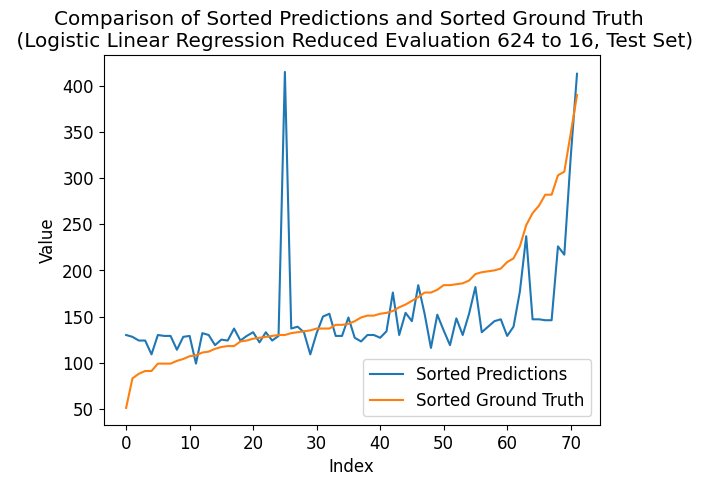

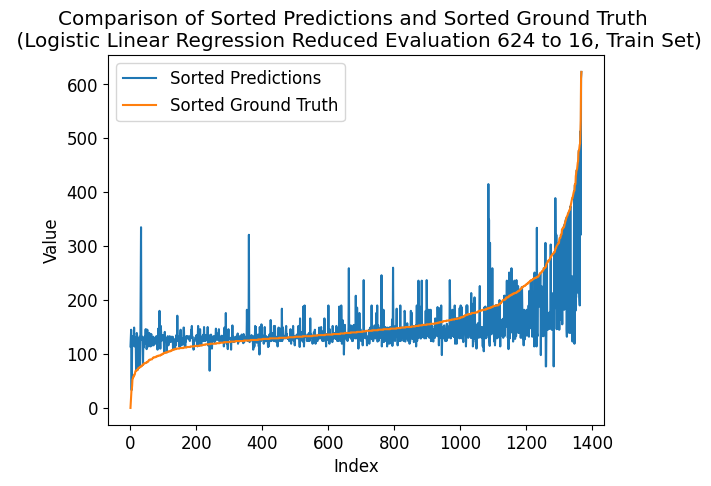

---- ---- ----
class_num = 640
Number of unique elements: 281
[  0.  40.  80. 120. 160. 200. 240. 280. 320. 360. 400. 440. 480. 520.
 560. 600. 640.]
test eval:
Mean squared error: 2.513888888888889
Correlation coefficient: 0.4959796133239494
Coefficient of determination (R-squared score, R2 score): 0.06352400114975565
train eval:
Mean squared error: 1.891812865497076
Correlation coefficient: 0.6728581584127225
Coefficient of determination (R-squared score, R2 score): 0.431875819598736


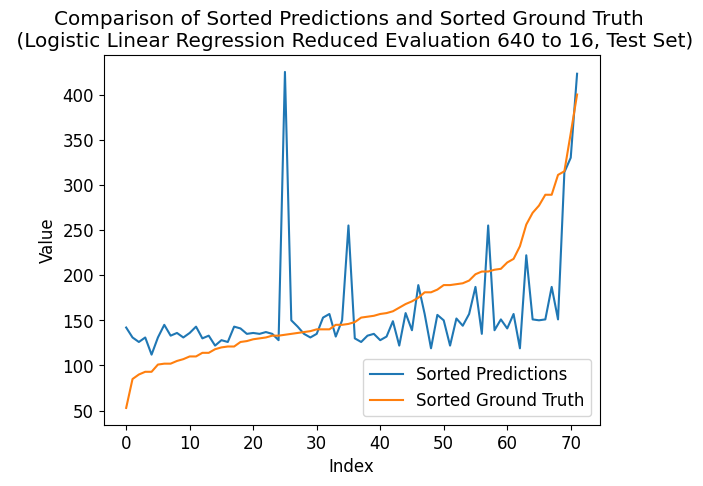

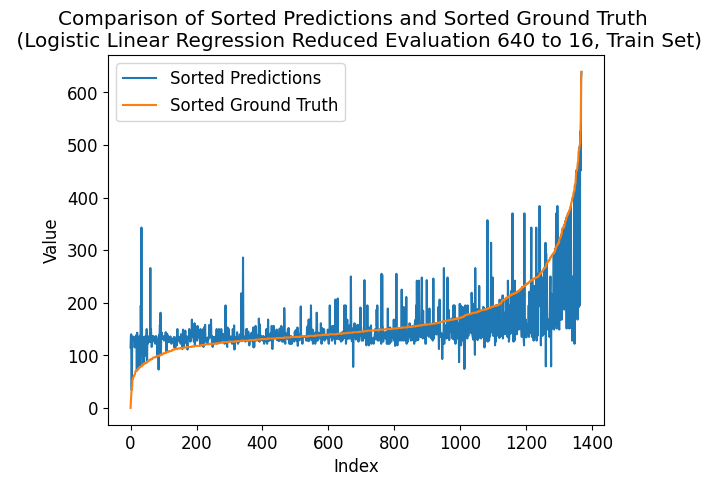

---- ---- ----
class_num = 656
Number of unique elements: 285
[  0.  41.  82. 123. 164. 205. 246. 287. 328. 369. 410. 451. 492. 533.
 574. 615. 656.]
test eval:
Mean squared error: 2.3472222222222223
Correlation coefficient: 0.5242565496215956
Coefficient of determination (R-squared score, R2 score): 0.12561080770336297
train eval:
Mean squared error: 2.1403508771929824
Correlation coefficient: 0.6280867798400422
Coefficient of determination (R-squared score, R2 score): 0.3572381761147987


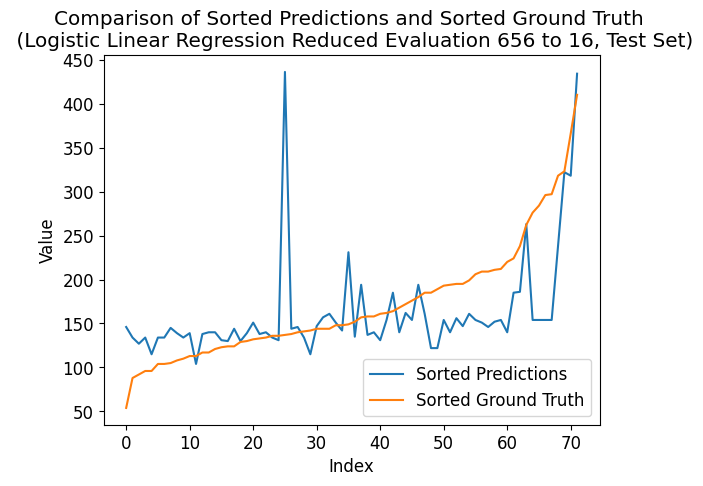

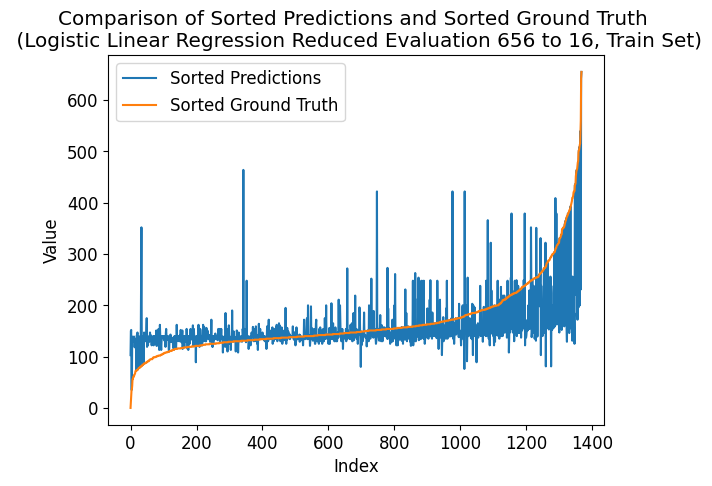

---- ---- ----
class_num = 672
Number of unique elements: 294
[  0.  42.  84. 126. 168. 210. 252. 294. 336. 378. 420. 462. 504. 546.
 588. 630. 672.]
test eval:
Mean squared error: 3.111111111111111
Correlation coefficient: 0.2776339596690231
Coefficient of determination (R-squared score, R2 score): -0.15895372233400407
train eval:
Mean squared error: 2.009502923976608
Correlation coefficient: 0.6524229224817558
Coefficient of determination (R-squared score, R2 score): 0.3965327001842833


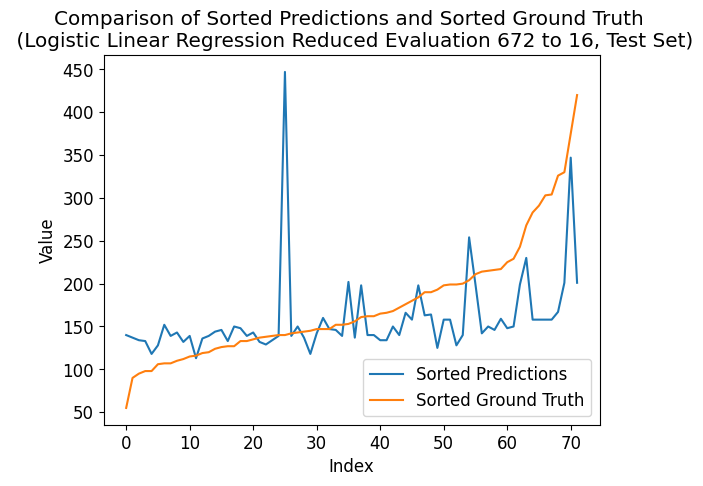

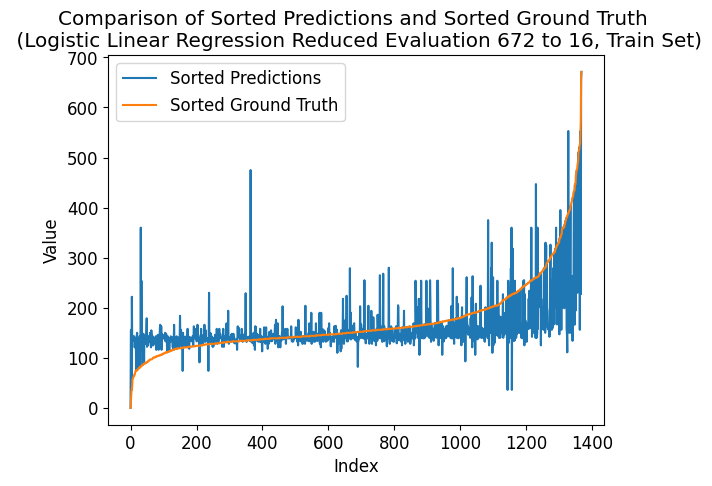

---- ---- ----
class_num = 688
Number of unique elements: 294
[  0.  43.  86. 129. 172. 215. 258. 301. 344. 387. 430. 473. 516. 559.
 602. 645. 688.]
test eval:
Mean squared error: 2.388888888888889
Correlation coefficient: 0.4429392489636886
Coefficient of determination (R-squared score, R2 score): 0.11008910606496114
train eval:
Mean squared error: 1.9269005847953216
Correlation coefficient: 0.6670231959802345
Coefficient of determination (R-squared score, R2 score): 0.4213387405186507


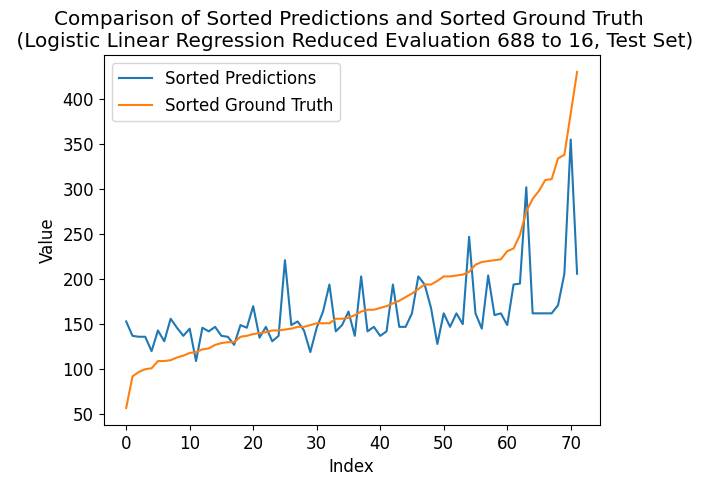

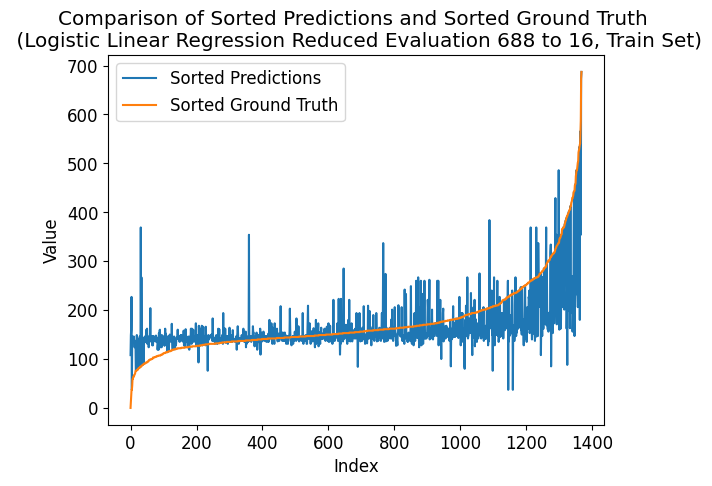

---- ---- ----
class_num = 704
Number of unique elements: 297
[  0.  44.  88. 132. 176. 220. 264. 308. 352. 396. 440. 484. 528. 572.
 616. 660. 704.]
test eval:
Mean squared error: 1.9027777777777777
Correlation coefficient: 0.612276796515316
Coefficient of determination (R-squared score, R2 score): 0.29117562517964934
train eval:
Mean squared error: 2.06140350877193
Correlation coefficient: 0.6389297219566348
Coefficient of determination (R-squared score, R2 score): 0.3809466040449905


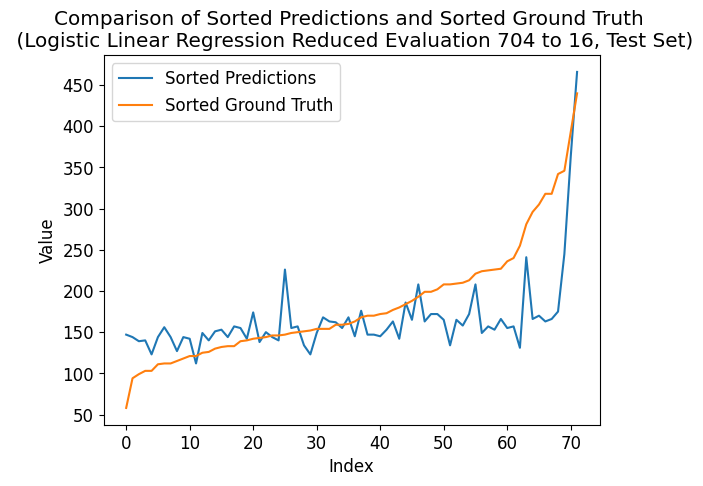

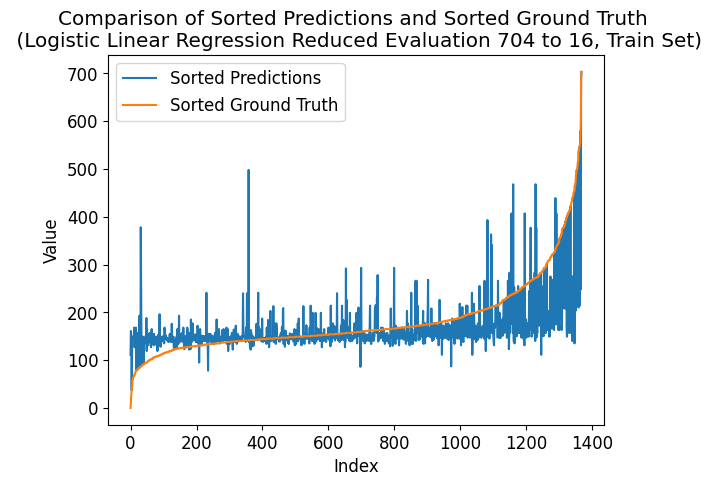

---- ---- ----
class_num = 720
Number of unique elements: 295
[  0.  45.  90. 135. 180. 225. 270. 315. 360. 405. 450. 495. 540. 585.
 630. 675. 720.]
test eval:
Mean squared error: 2.375
Correlation coefficient: 0.5182896714090198
Coefficient of determination (R-squared score, R2 score): 0.11526300661109512
train eval:
Mean squared error: 2.1410818713450293
Correlation coefficient: 0.6245946738526794
Coefficient of determination (R-squared score, R2 score): 0.35701865363396357


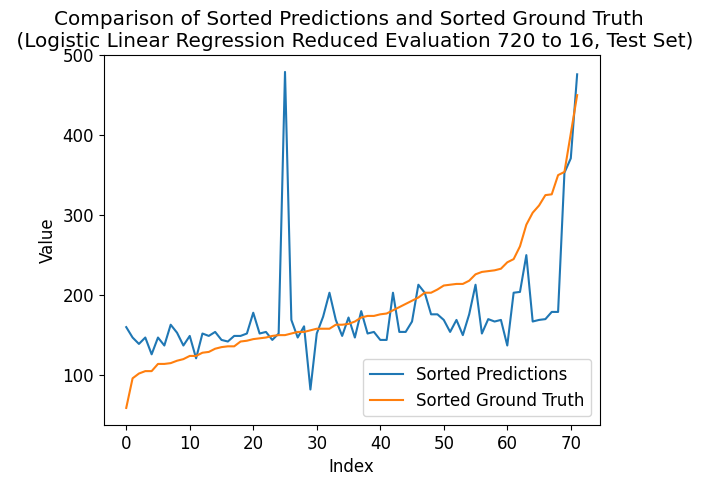

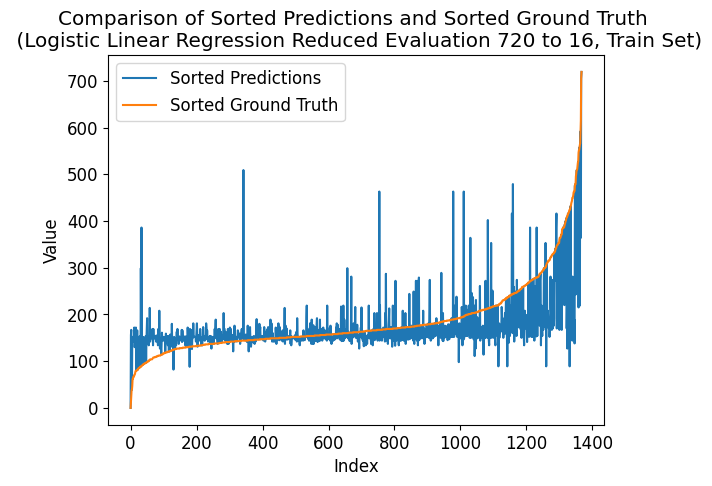

---- ---- ----
class_num = 736
Number of unique elements: 305
[  0.  46.  92. 138. 184. 230. 276. 322. 368. 414. 460. 506. 552. 598.
 644. 690. 736.]
test eval:
Mean squared error: 2.4444444444444446
Correlation coefficient: 0.5069063533931024
Coefficient of determination (R-squared score, R2 score): 0.08939350388042533
train eval:
Mean squared error: 1.905701754385965
Correlation coefficient: 0.6733284687300131
Coefficient of determination (R-squared score, R2 score): 0.4277048924628689


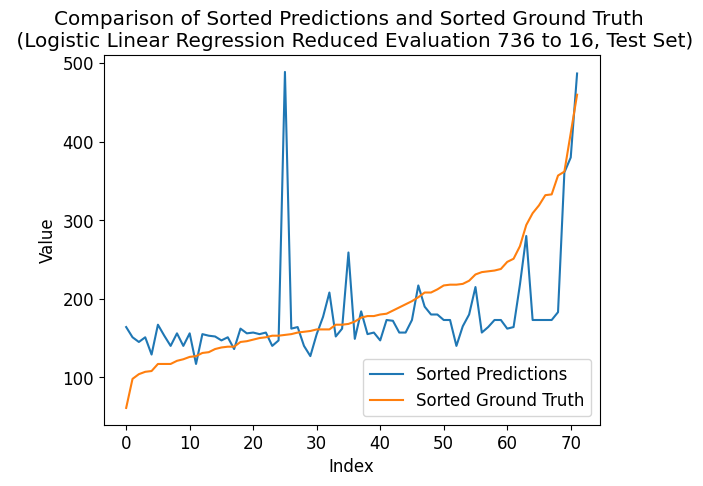

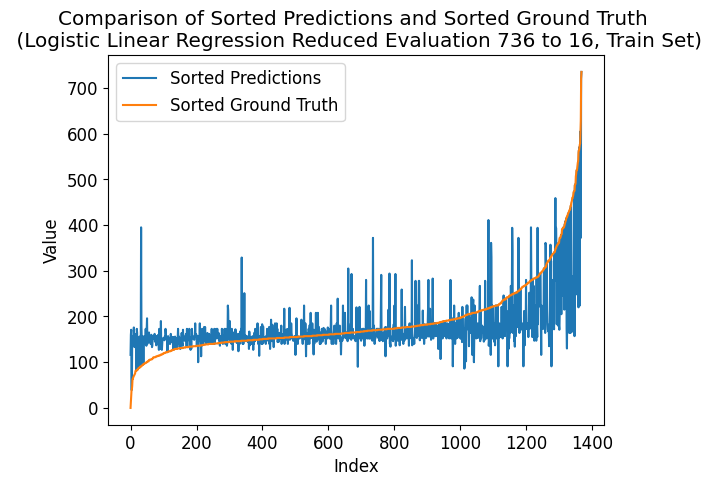

---- ---- ----
class_num = 752
Number of unique elements: 310
[  0.  47.  94. 141. 188. 235. 282. 329. 376. 423. 470. 517. 564. 611.
 658. 705. 752.]
test eval:
Mean squared error: 3.013888888888889
Correlation coefficient: 0.30591668513978393
Coefficient of determination (R-squared score, R2 score): -0.12273641851106643
train eval:
Mean squared error: 2.037280701754386
Correlation coefficient: 0.6427261113026423
Coefficient of determination (R-squared score, R2 score): 0.38819084591254915


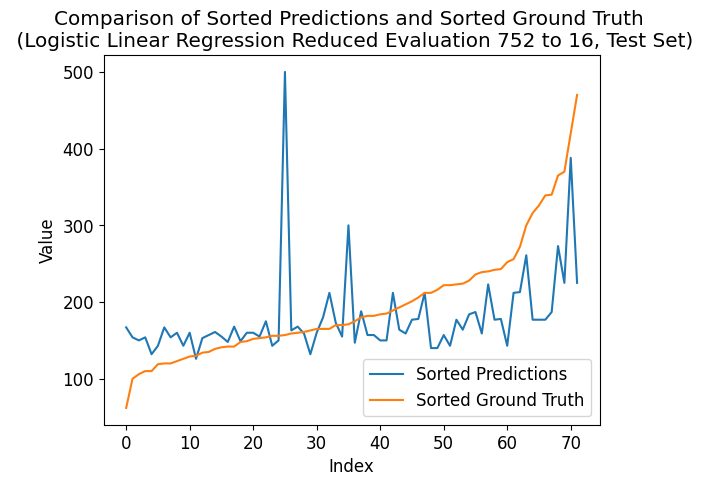

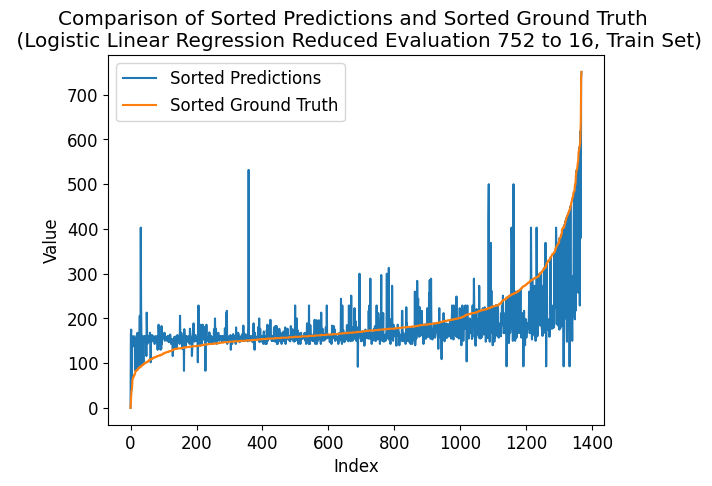

---- ---- ----
class_num = 768
Number of unique elements: 313
[  0.  48.  96. 144. 192. 240. 288. 336. 384. 432. 480. 528. 576. 624.
 672. 720. 768.]
test eval:
Mean squared error: 3.125
Correlation coefficient: 0.2851318189627352
Coefficient of determination (R-squared score, R2 score): -0.16412762288013805
train eval:
Mean squared error: 2.121345029239766
Correlation coefficient: 0.6325679085124666
Coefficient of determination (R-squared score, R2 score): 0.3629457606165115


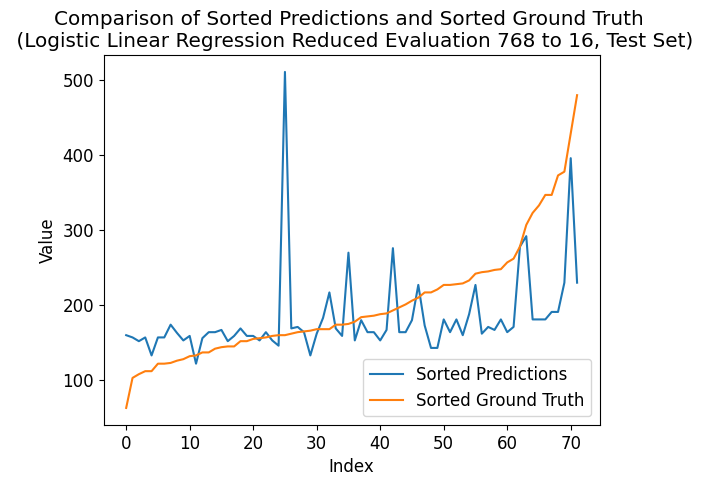

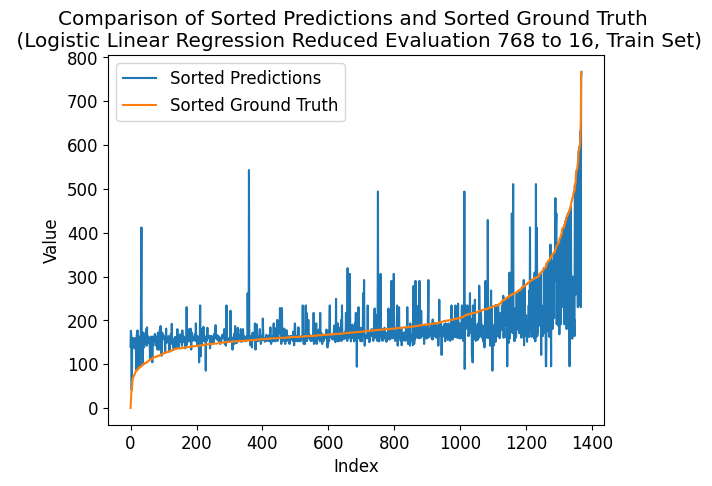

---- ---- ----
class_num = 784
Number of unique elements: 319
[  0.  49.  98. 147. 196. 245. 294. 343. 392. 441. 490. 539. 588. 637.
 686. 735. 784.]
test eval:
Mean squared error: 2.611111111111111
Correlation coefficient: 0.4701232724147603
Coefficient of determination (R-squared score, R2 score): 0.027306697326818008
train eval:
Mean squared error: 1.9839181286549707
Correlation coefficient: 0.6567204808433413
Coefficient of determination (R-squared score, R2 score): 0.40421598701351213


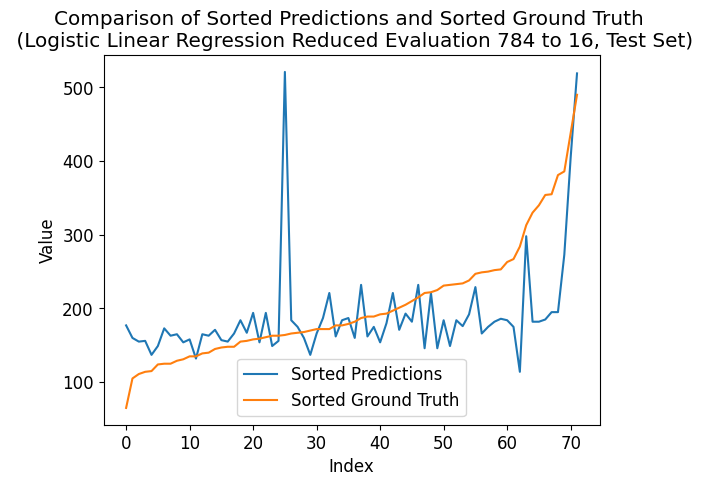

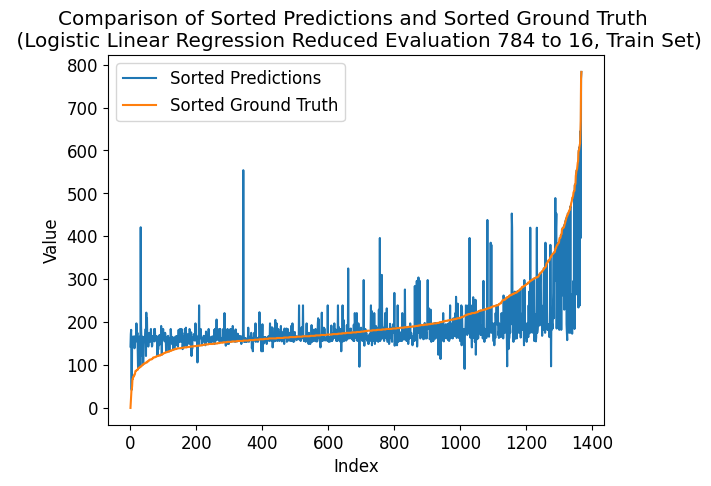

---- ---- ----
class_num = 800
Number of unique elements: 325
[  0.  50. 100. 150. 200. 250. 300. 350. 400. 450. 500. 550. 600. 650.
 700. 750. 800.]
test eval:
Mean squared error: 1.7222222222222223
Correlation coefficient: 0.6442014182764194
Coefficient of determination (R-squared score, R2 score): 0.35843633227939065
train eval:
Mean squared error: 2.1052631578947367
Correlation coefficient: 0.6290069965056774
Coefficient of determination (R-squared score, R2 score): 0.36777525519488397


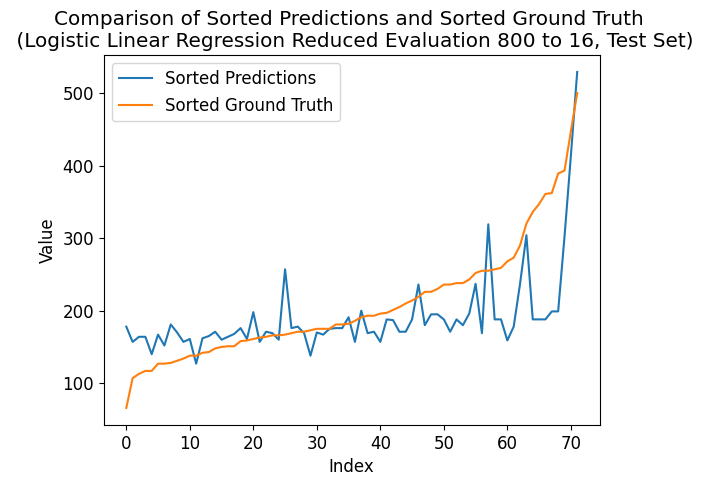

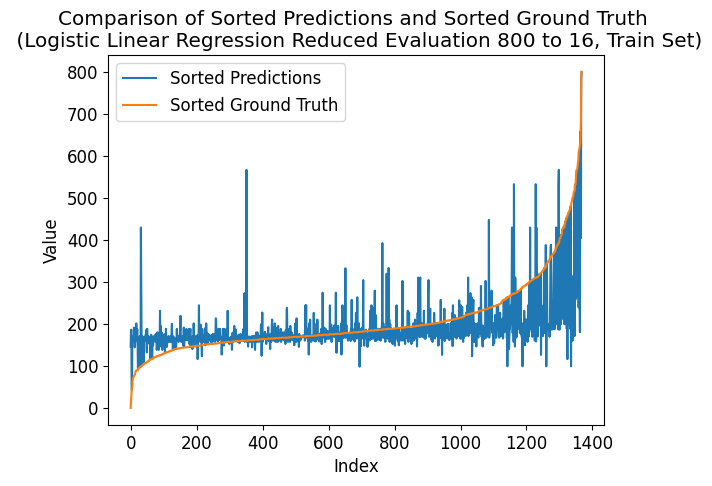

---- ---- ----
class_num = 816
Number of unique elements: 324
[  0.  51. 102. 153. 204. 255. 306. 357. 408. 459. 510. 561. 612. 663.
 714. 765. 816.]
test eval:
Mean squared error: 1.9305555555555556
Correlation coefficient: 0.6053807853573832
Coefficient of determination (R-squared score, R2 score): 0.2808278240873814
train eval:
Mean squared error: 2.064327485380117
Correlation coefficient: 0.6450582690587523
Coefficient of determination (R-squared score, R2 score): 0.3800685141216501


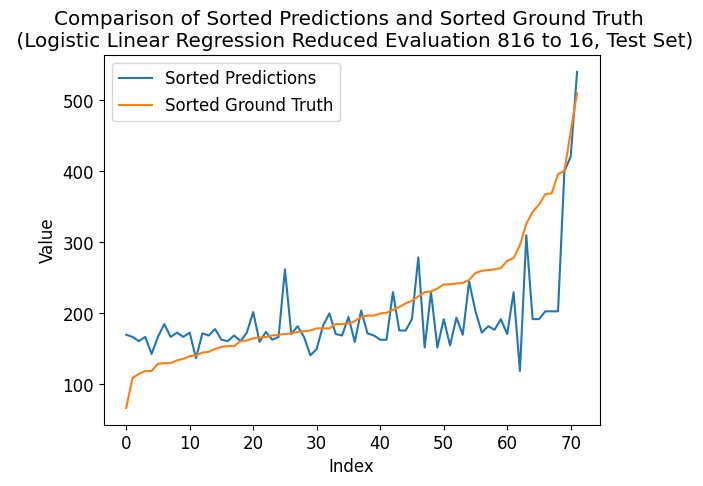

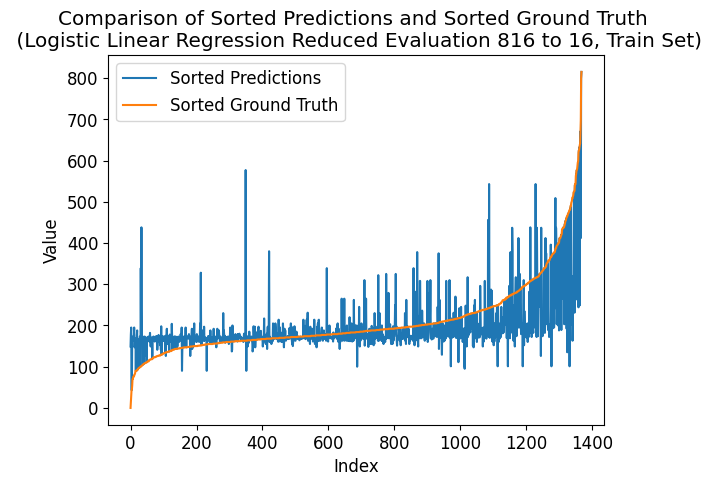

---- ---- ----
class_num = 832
Number of unique elements: 334
[  0.  52. 104. 156. 208. 260. 312. 364. 416. 468. 520. 572. 624. 676.
 728. 780. 832.]
test eval:
Mean squared error: 3.138888888888889
Correlation coefficient: 0.2835395109767746
Coefficient of determination (R-squared score, R2 score): -0.16930152342627203
train eval:
Mean squared error: 2.0994152046783627
Correlation coefficient: 0.6331160488144556
Coefficient of determination (R-squared score, R2 score): 0.3695314350415648


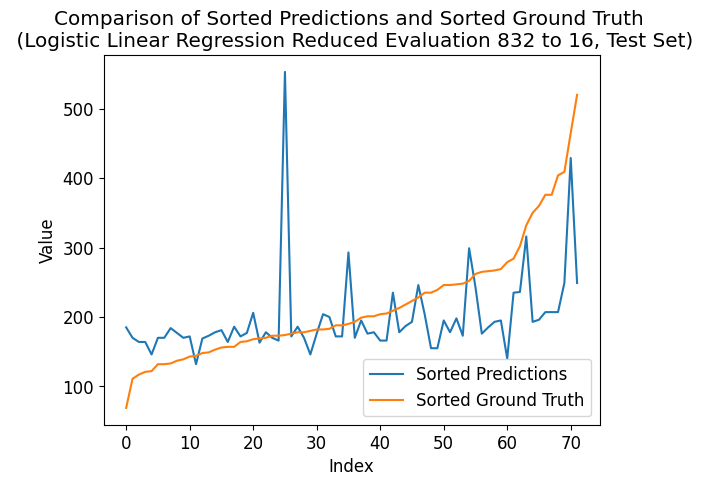

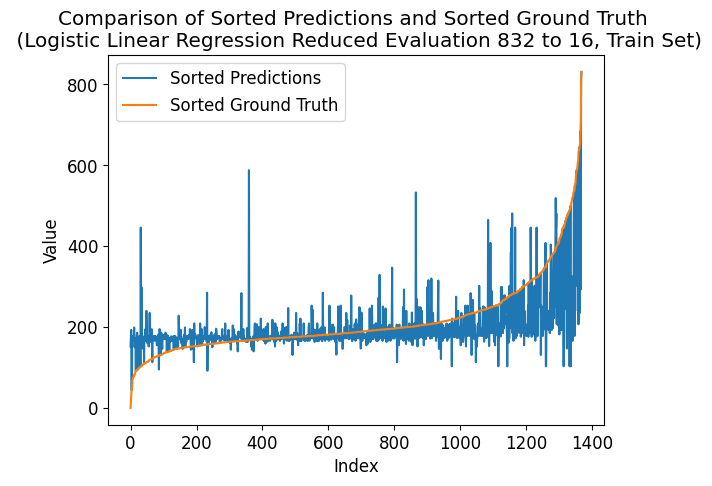

---- ---- ----
class_num = 848
Number of unique elements: 338
[  0.  53. 106. 159. 212. 265. 318. 371. 424. 477. 530. 583. 636. 689.
 742. 795. 848.]
test eval:
Mean squared error: 2.5833333333333335
Correlation coefficient: 0.47280752946812027
Coefficient of determination (R-squared score, R2 score): 0.03765449841908586
train eval:
Mean squared error: 2.0080409356725144
Correlation coefficient: 0.6523969279902289
Coefficient of determination (R-squared score, R2 score): 0.39697174514595346


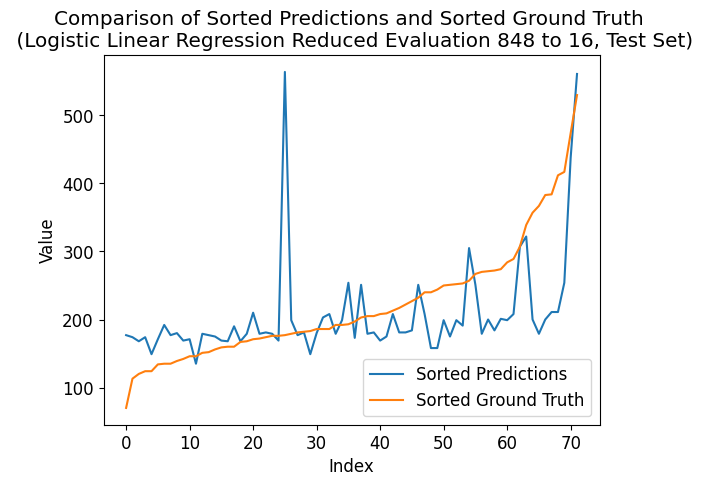

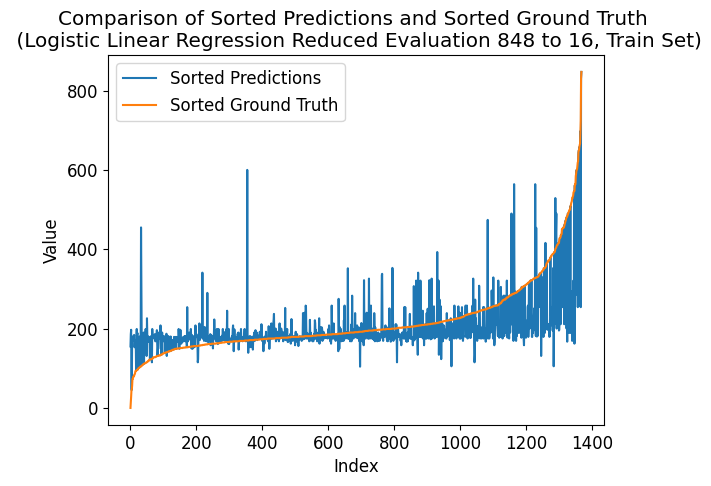

---- ---- ----
class_num = 864
Number of unique elements: 341
[  0.  54. 108. 162. 216. 270. 324. 378. 432. 486. 540. 594. 648. 702.
 756. 810. 864.]
test eval:
Mean squared error: 2.513888888888889
Correlation coefficient: 0.4896600188556923
Coefficient of determination (R-squared score, R2 score): 0.06352400114975565
train eval:
Mean squared error: 2.121345029239766
Correlation coefficient: 0.6272607634184295
Coefficient of determination (R-squared score, R2 score): 0.3629457606165115


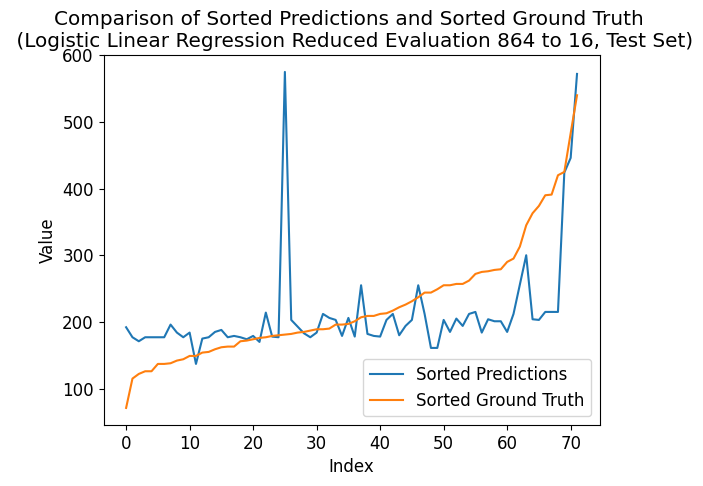

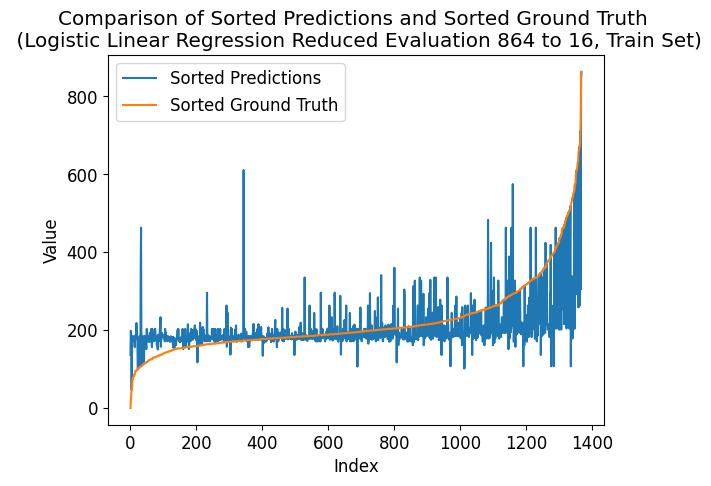

---- ---- ----
class_num = 880
Number of unique elements: 341
[  0.  55. 110. 165. 220. 275. 330. 385. 440. 495. 550. 605. 660. 715.
 770. 825. 880.]
test eval:
Mean squared error: 3.0277777777777777
Correlation coefficient: 0.34771092509666
Coefficient of determination (R-squared score, R2 score): -0.1279103190572004
train eval:
Mean squared error: 1.9861111111111112
Correlation coefficient: 0.6564756883538337
Coefficient of determination (R-squared score, R2 score): 0.40355741957100677


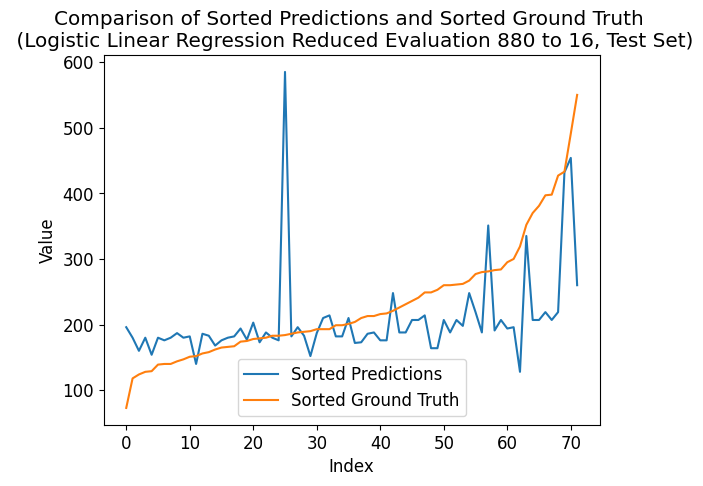

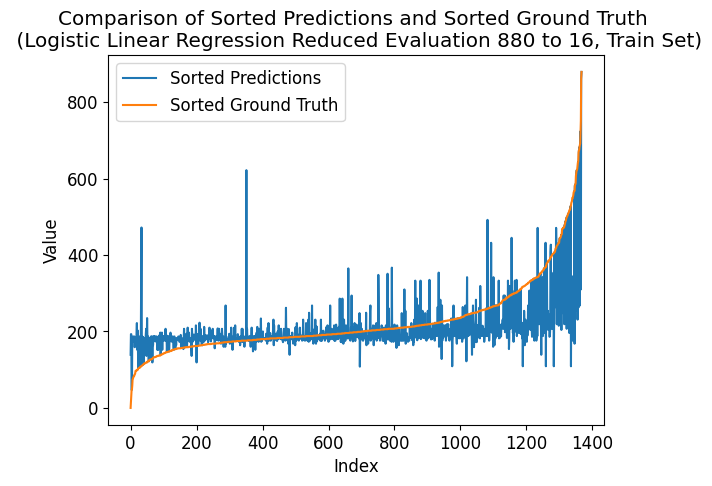

---- ---- ----
class_num = 896
Number of unique elements: 343
[  0.  56. 112. 168. 224. 280. 336. 392. 448. 504. 560. 616. 672. 728.
 784. 840. 896.]
test eval:
Mean squared error: 1.8333333333333333
Correlation coefficient: 0.615271327222017
Coefficient of determination (R-squared score, R2 score): 0.317045127910319
train eval:
Mean squared error: 1.9305555555555556
Correlation coefficient: 0.6710527360755263
Coefficient of determination (R-squared score, R2 score): 0.4202411281144751


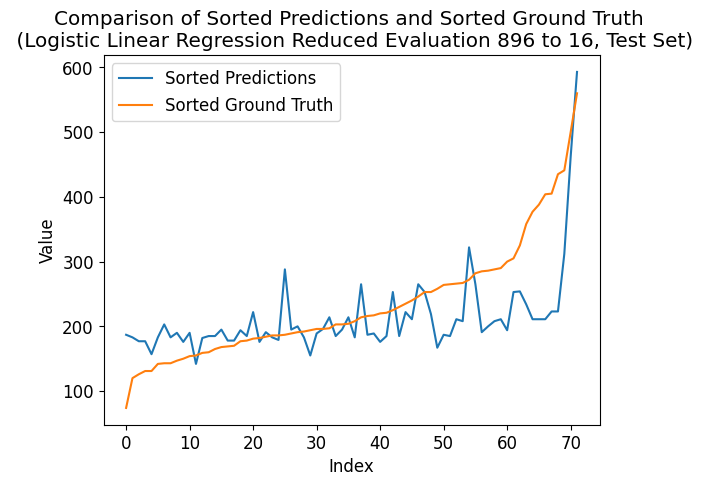

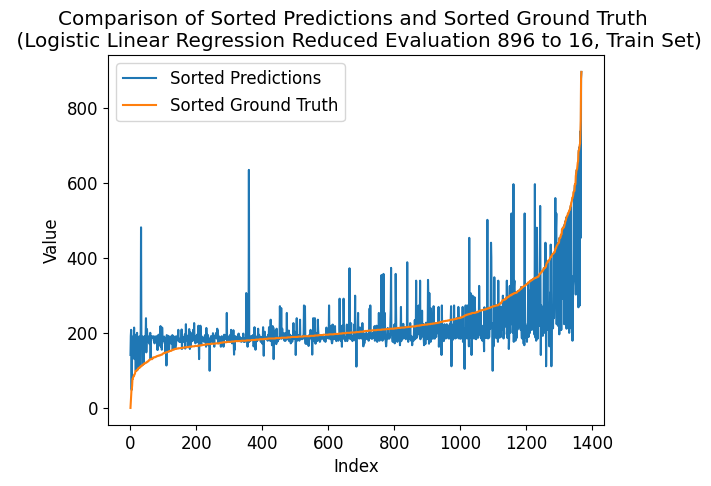

---- ---- ----
class_num = 912
Number of unique elements: 348
[  0.  57. 114. 171. 228. 285. 342. 399. 456. 513. 570. 627. 684. 741.
 798. 855. 912.]
test eval:
Mean squared error: 1.9305555555555556
Correlation coefficient: 0.5873926075204718
Coefficient of determination (R-squared score, R2 score): 0.2808278240873814
train eval:
Mean squared error: 1.894736842105263
Correlation coefficient: 0.6763233151814512
Coefficient of determination (R-squared score, R2 score): 0.4309977296753955


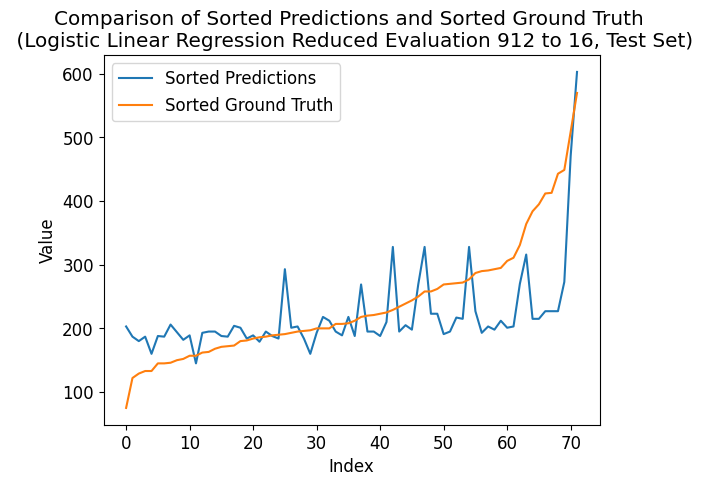

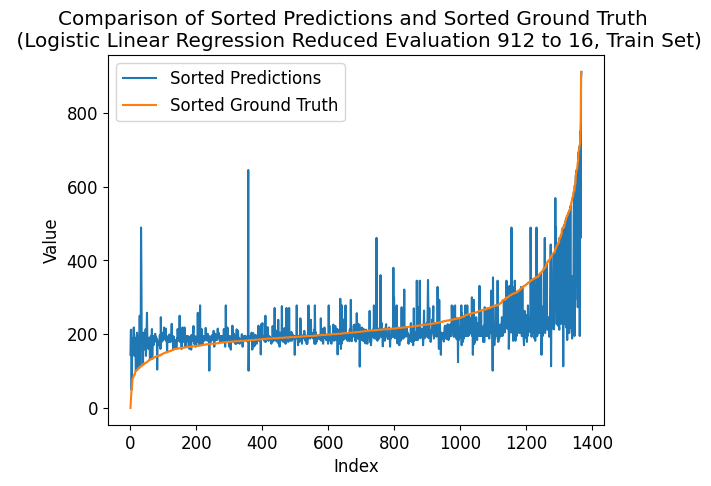

---- ---- ----
class_num = 928
Number of unique elements: 351
[  0.  58. 116. 174. 232. 290. 348. 406. 464. 522. 580. 638. 696. 754.
 812. 870. 928.]
test eval:
Mean squared error: 2.6944444444444446
Correlation coefficient: 0.4485437075709681
Coefficient of determination (R-squared score, R2 score): -0.0037367059499857636
train eval:
Mean squared error: 1.9444444444444444
Correlation coefficient: 0.6672195966596819
Coefficient of determination (R-squared score, R2 score): 0.41607020097860803


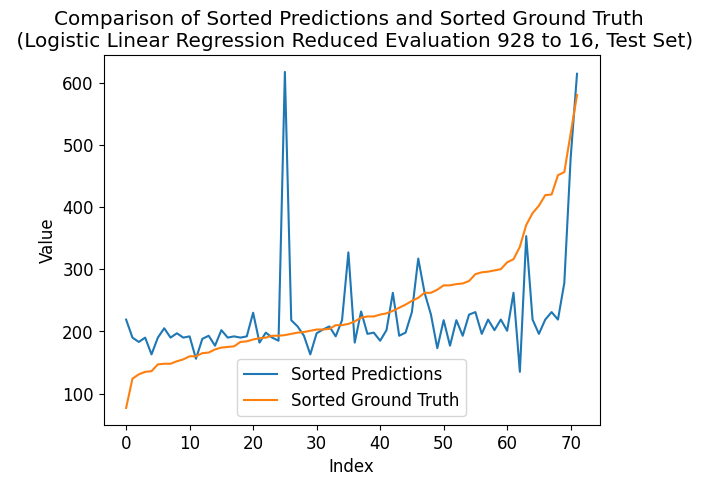

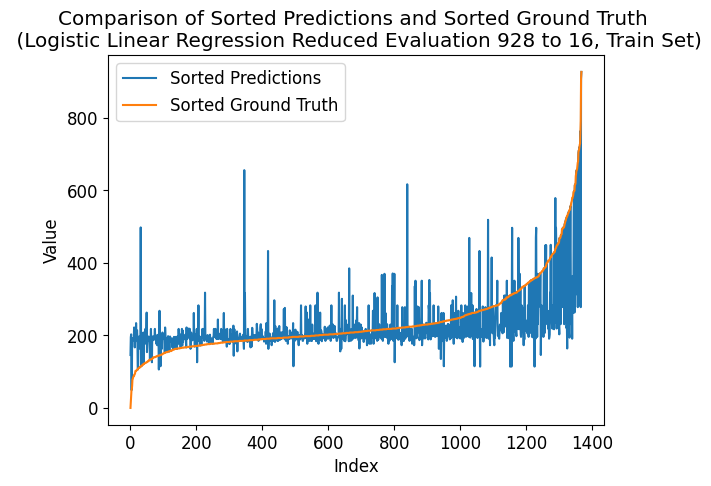

---- ---- ----
class_num = 944
Number of unique elements: 357
[  0.  59. 118. 177. 236. 295. 354. 413. 472. 531. 590. 649. 708. 767.
 826. 885. 944.]
test eval:
Mean squared error: 2.9583333333333335
Correlation coefficient: 0.3442632231956626
Coefficient of determination (R-squared score, R2 score): -0.10204081632653073
train eval:
Mean squared error: 2.021198830409357
Correlation coefficient: 0.6523343388983958
Coefficient of determination (R-squared score, R2 score): 0.3930203404909215


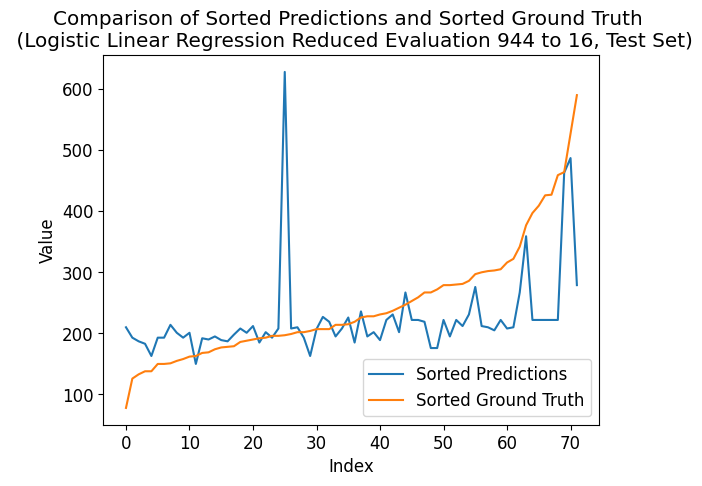

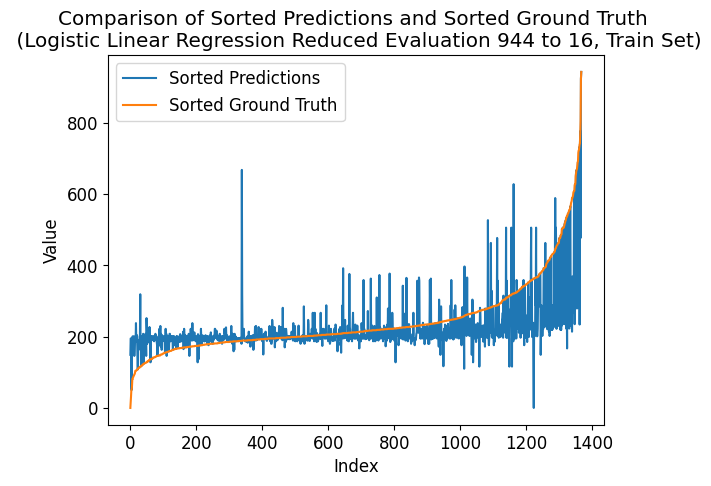

---- ---- ----
class_num = 960
Number of unique elements: 361
[  0.  60. 120. 180. 240. 300. 360. 420. 480. 540. 600. 660. 720. 780.
 840. 900. 960.]
test eval:
Mean squared error: 2.25
Correlation coefficient: 0.5519770771720284
Coefficient of determination (R-squared score, R2 score): 0.1618281115263006
train eval:
Mean squared error: 2.0255847953216373
Correlation coefficient: 0.647285814439221
Coefficient of determination (R-squared score, R2 score): 0.3917032056059109


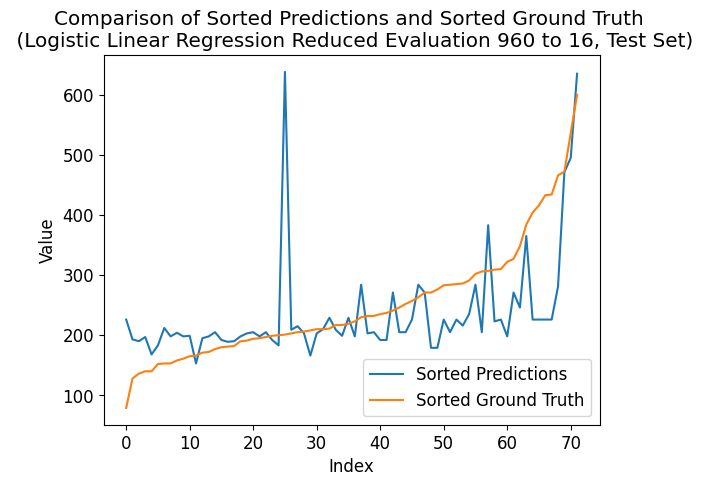

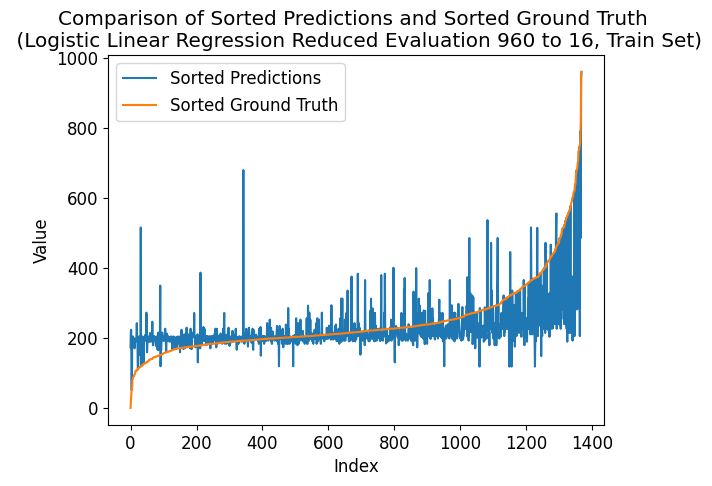

---- ---- ----
class_num = 976
Number of unique elements: 368
[  0.  61. 122. 183. 244. 305. 366. 427. 488. 549. 610. 671. 732. 793.
 854. 915. 976.]
test eval:
Mean squared error: 2.263888888888889
Correlation coefficient: 0.5488420276262334
Coefficient of determination (R-squared score, R2 score): 0.15665421098016674
train eval:
Mean squared error: 1.9451754385964912
Correlation coefficient: 0.6673713456449218
Coefficient of determination (R-squared score, R2 score): 0.4158506784977729


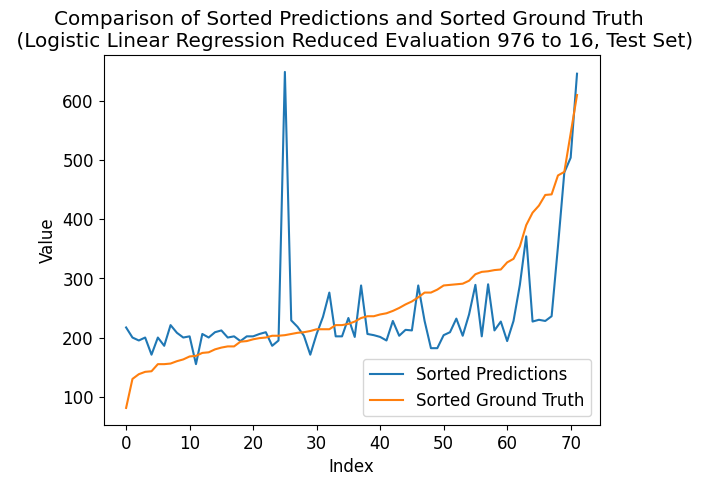

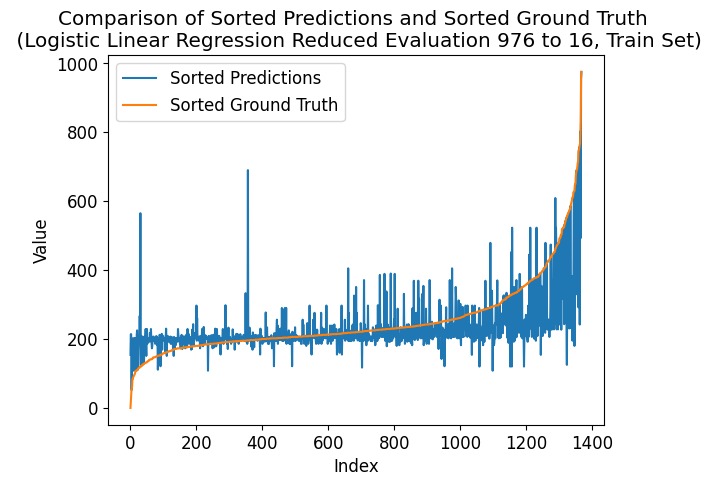

---- ---- ----
class_num = 992
Number of unique elements: 367
[  0.  62. 124. 186. 248. 310. 372. 434. 496. 558. 620. 682. 744. 806.
 868. 930. 992.]
test eval:
Mean squared error: 2.9583333333333335
Correlation coefficient: 0.3328472186423275
Coefficient of determination (R-squared score, R2 score): -0.10204081632653073
train eval:
Mean squared error: 2.0964912280701755
Correlation coefficient: 0.637516524083052
Coefficient of determination (R-squared score, R2 score): 0.3704095249649052


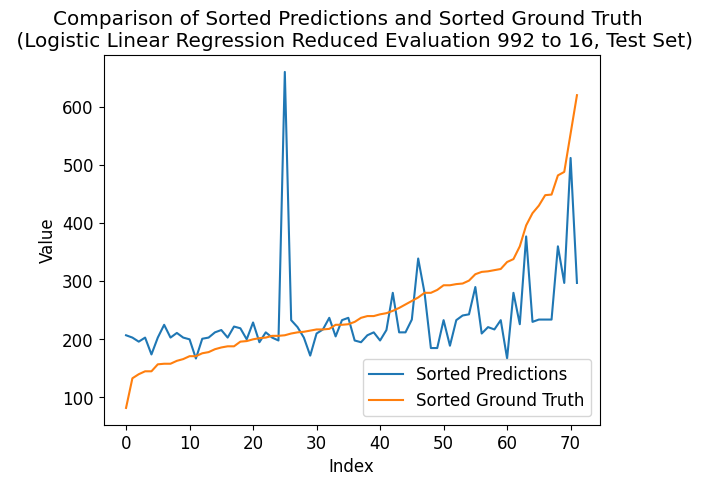

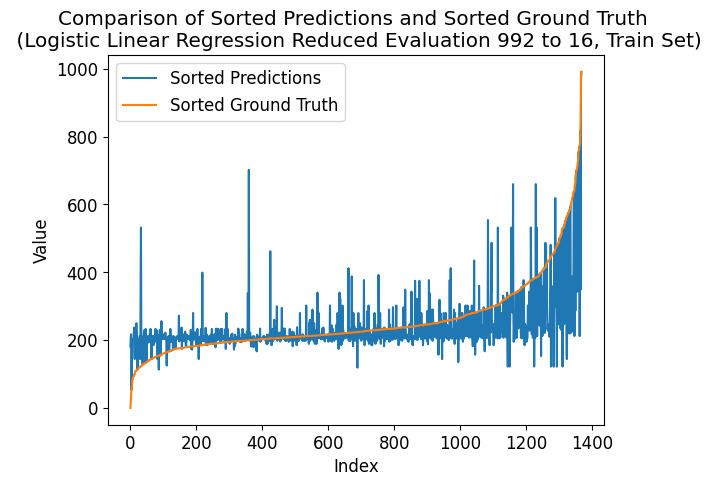

---- ---- ----
class_num = 1008
Number of unique elements: 378
[   0.   63.  126.  189.  252.  315.  378.  441.  504.  567.  630.  693.
  756.  819.  882.  945. 1008.]
test eval:
Mean squared error: 2.486111111111111
Correlation coefficient: 0.4444171027169641
Coefficient of determination (R-squared score, R2 score): 0.0738718022420235
train eval:
Mean squared error: 2.094298245614035
Correlation coefficient: 0.6394203577468888
Coefficient of determination (R-squared score, R2 score): 0.37106809240741057


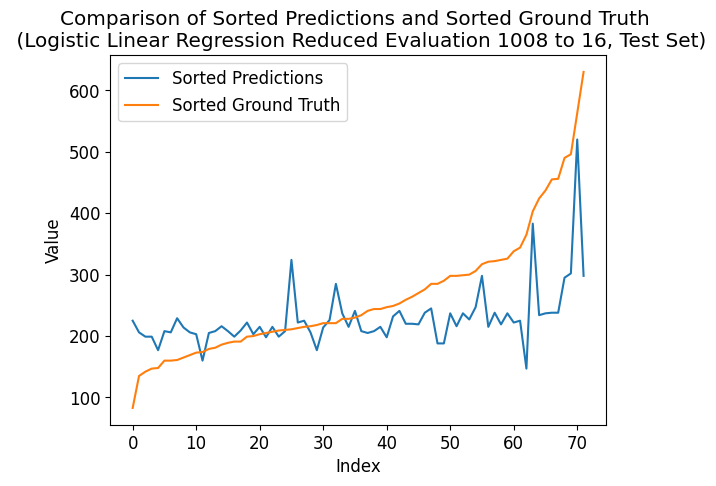

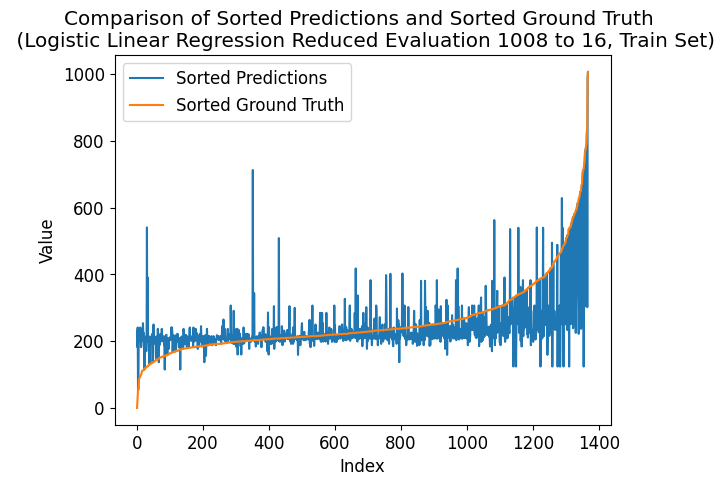

---- ---- ----
class_num = 1024
Number of unique elements: 375
[   0.   64.  128.  192.  256.  320.  384.  448.  512.  576.  640.  704.
  768.  832.  896.  960. 1024.]
test eval:
Mean squared error: 2.4027777777777777
Correlation coefficient: 0.5226471919797034
Coefficient of determination (R-squared score, R2 score): 0.10491520551882727
train eval:
Mean squared error: 2.0796783625730995
Correlation coefficient: 0.6389852486303297
Coefficient of determination (R-squared score, R2 score): 0.3754585420241128


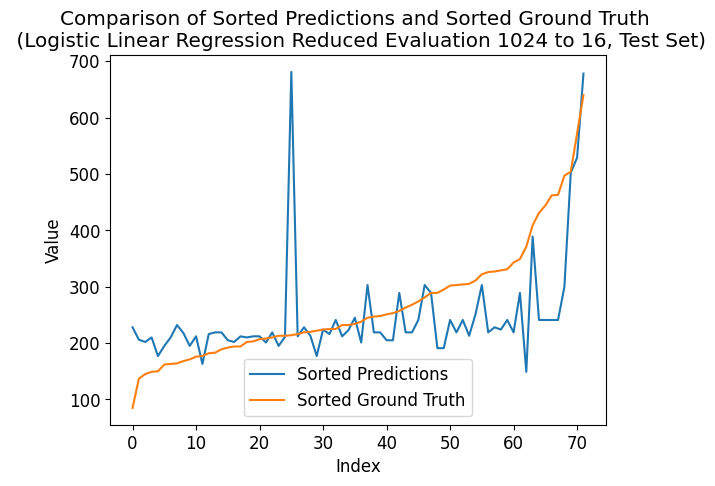

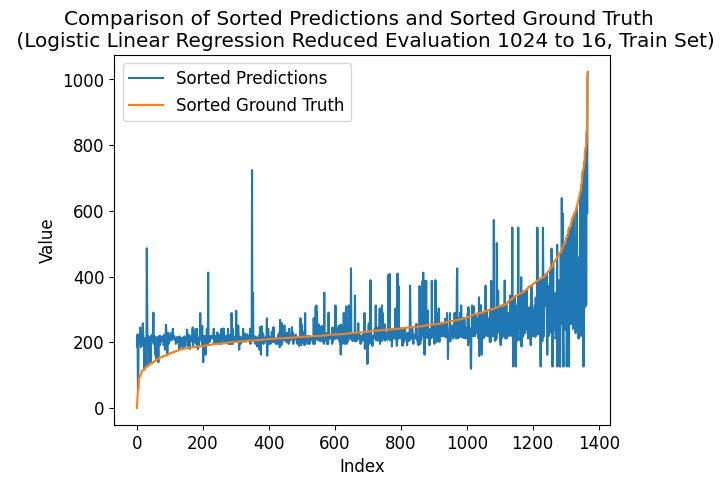

---- ---- ----
class_num = 1040
Number of unique elements: 379
[   0.   65.  130.  195.  260.  325.  390.  455.  520.  585.  650.  715.
  780.  845.  910.  975. 1040.]
test eval:
Mean squared error: 2.861111111111111
Correlation coefficient: 0.4026341335786889
Coefficient of determination (R-squared score, R2 score): -0.06582351250359308
train eval:
Mean squared error: 2.254385964912281
Correlation coefficient: 0.6069642692673607
Coefficient of determination (R-squared score, R2 score): 0.3229926691045215


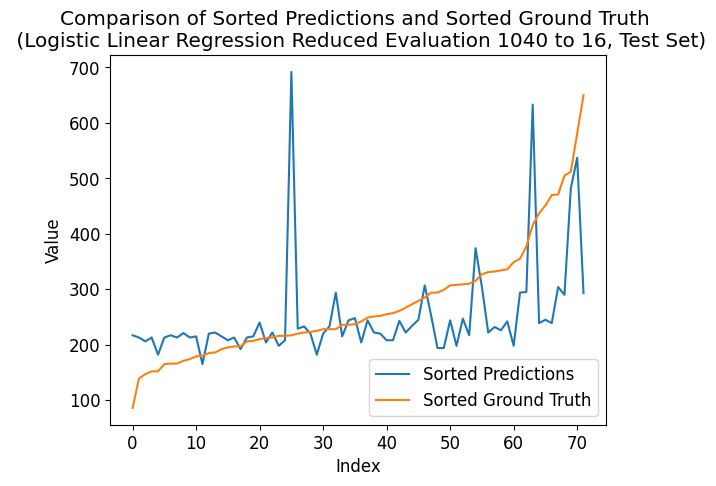

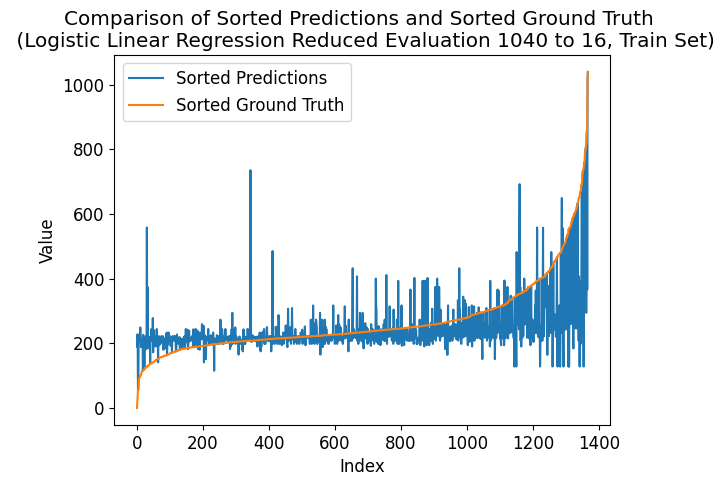

---- ---- ----
class_num = 1056
Number of unique elements: 378
[   0.   66.  132.  198.  264.  330.  396.  462.  528.  594.  660.  726.
  792.  858.  924.  990. 1056.]
test eval:
Mean squared error: 2.3055555555555554
Correlation coefficient: 0.5447584403232473
Coefficient of determination (R-squared score, R2 score): 0.1411325093417648
train eval:
Mean squared error: 1.963450292397661
Correlation coefficient: 0.6625470329519252
Coefficient of determination (R-squared score, R2 score): 0.4103626164768952


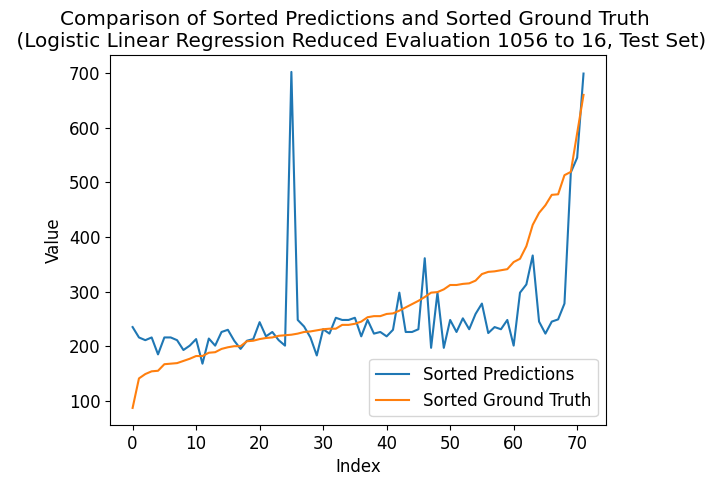

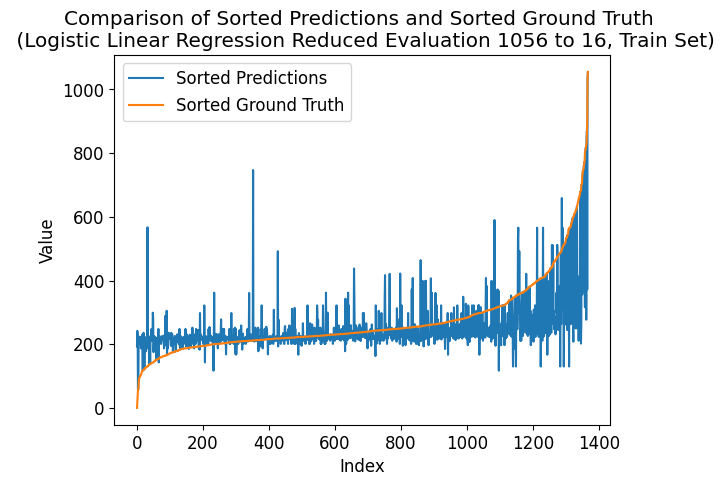

---- ---- ----
class_num = 1072
Number of unique elements: 384
[   0.   67.  134.  201.  268.  335.  402.  469.  536.  603.  670.  737.
  804.  871.  938. 1005. 1072.]
test eval:
Mean squared error: 2.888888888888889
Correlation coefficient: 0.38819145467270394
Coefficient of determination (R-squared score, R2 score): -0.07617131359586082
train eval:
Mean squared error: 2.1366959064327484
Correlation coefficient: 0.6297310705572746
Coefficient of determination (R-squared score, R2 score): 0.3583357885189742


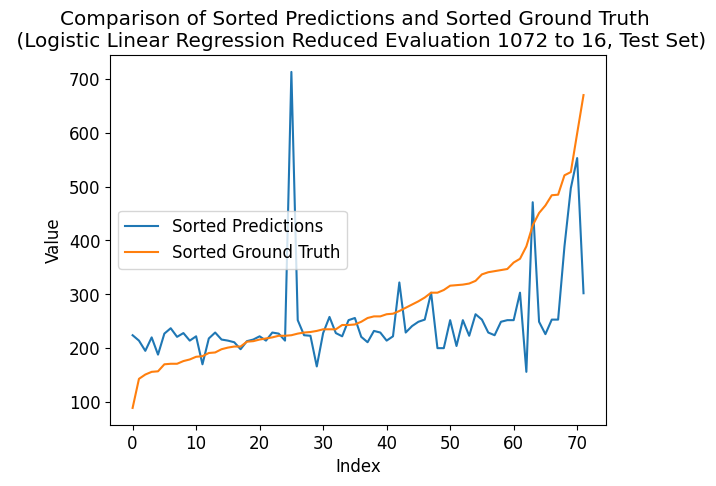

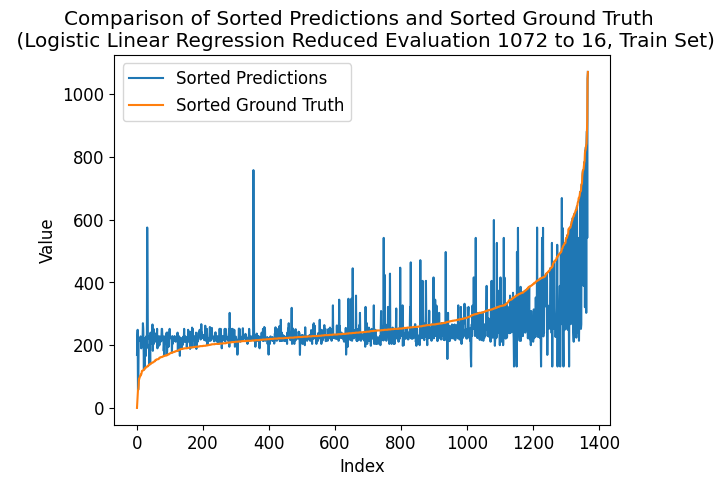

---- ---- ----
class_num = 1088
Number of unique elements: 391
[   0.   68.  136.  204.  272.  340.  408.  476.  544.  612.  680.  748.
  816.  884.  952. 1020. 1088.]
test eval:
Mean squared error: 1.9027777777777777
Correlation coefficient: 0.6007301017890054
Coefficient of determination (R-squared score, R2 score): 0.29117562517964934
train eval:
Mean squared error: 2.2353801169590644
Correlation coefficient: 0.6143762909263057
Coefficient of determination (R-squared score, R2 score): 0.32870025360623434


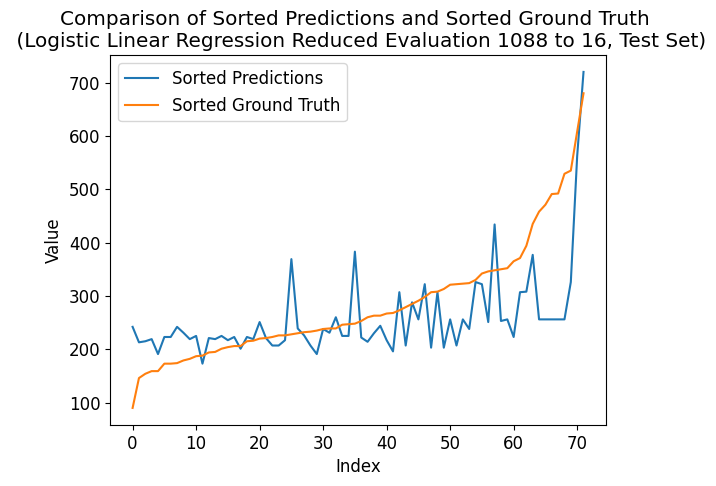

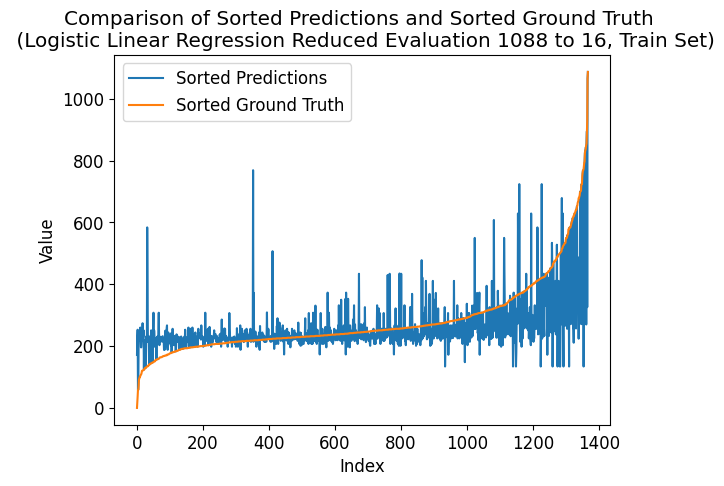

---- ---- ----
class_num = 1104
Number of unique elements: 389
[   0.   69.  138.  207.  276.  345.  414.  483.  552.  621.  690.  759.
  828.  897.  966. 1035. 1104.]
test eval:
Mean squared error: 2.4444444444444446
Correlation coefficient: 0.45555559450391664
Coefficient of determination (R-squared score, R2 score): 0.08939350388042533
train eval:
Mean squared error: 2.179093567251462
Correlation coefficient: 0.6252245951835987
Coefficient of determination (R-squared score, R2 score): 0.3456034846305378


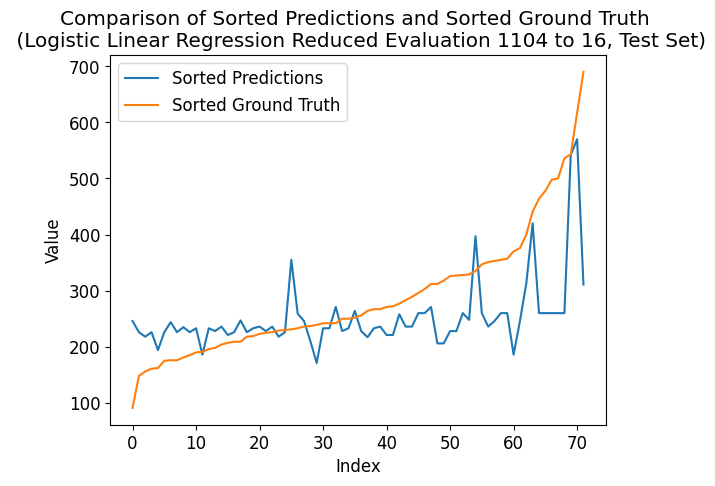

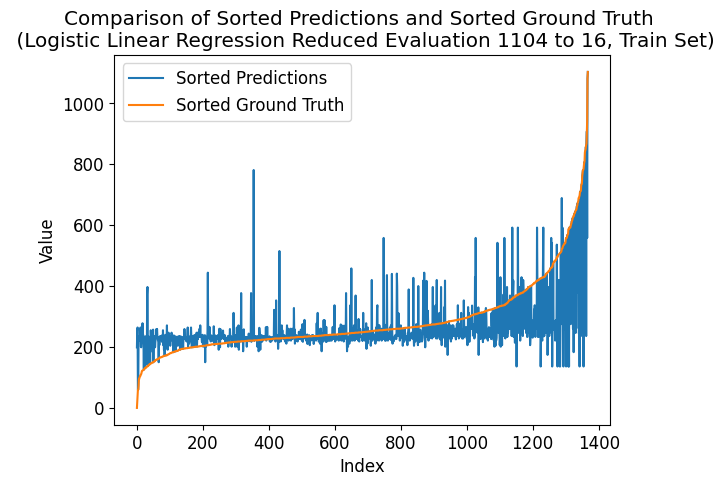

---- ---- ----
class_num = 1120
Number of unique elements: 390
[   0.   70.  140.  210.  280.  350.  420.  490.  560.  630.  700.  770.
  840.  910.  980. 1050. 1120.]
test eval:
Mean squared error: 1.6388888888888888
Correlation coefficient: 0.6717078439483446
Coefficient of determination (R-squared score, R2 score): 0.3894797355561943
train eval:
Mean squared error: 2.0197368421052633
Correlation coefficient: 0.6519000614263346
Coefficient of determination (R-squared score, R2 score): 0.39345938545259174


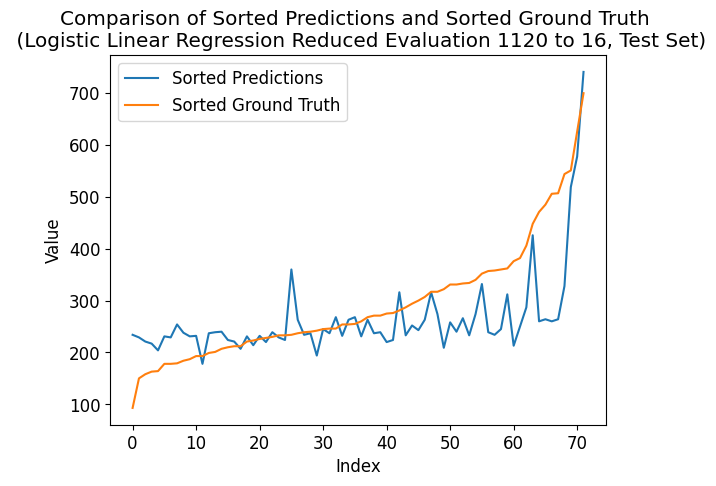

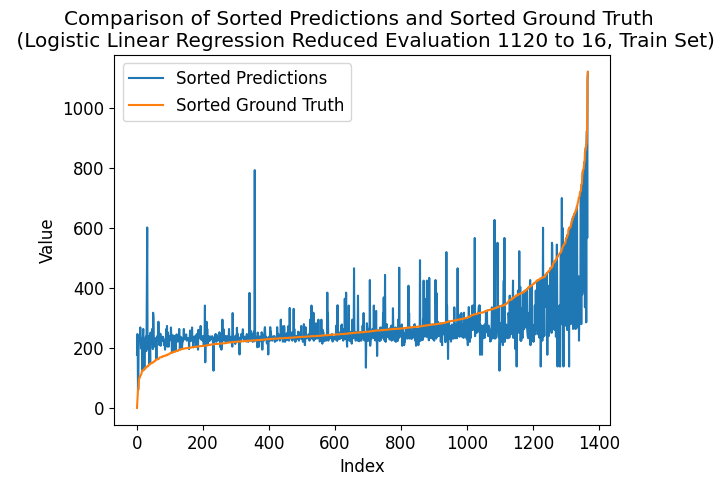

---- ---- ----
class_num = 1136
Number of unique elements: 398
[   0.   71.  142.  213.  284.  355.  426.  497.  568.  639.  710.  781.
  852.  923.  994. 1065. 1136.]
test eval:
Mean squared error: 2.8472222222222223
Correlation coefficient: 0.3751257609402642
Coefficient of determination (R-squared score, R2 score): -0.060649611957459104
train eval:
Mean squared error: 2.1710526315789473
Correlation coefficient: 0.6204281301609996
Coefficient of determination (R-squared score, R2 score): 0.34801823191972403


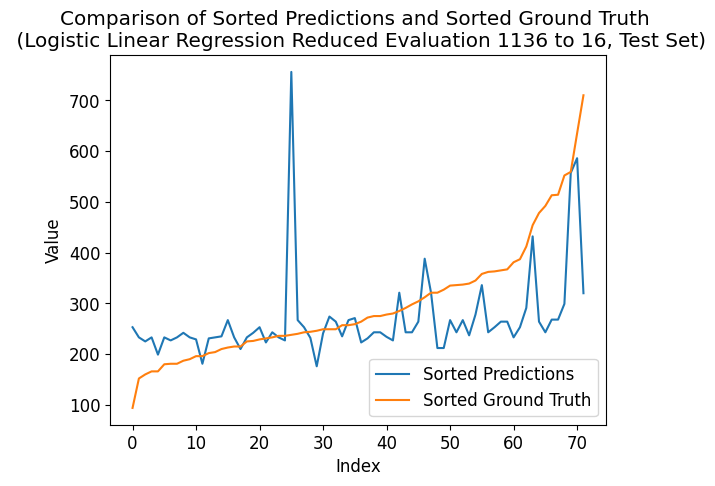

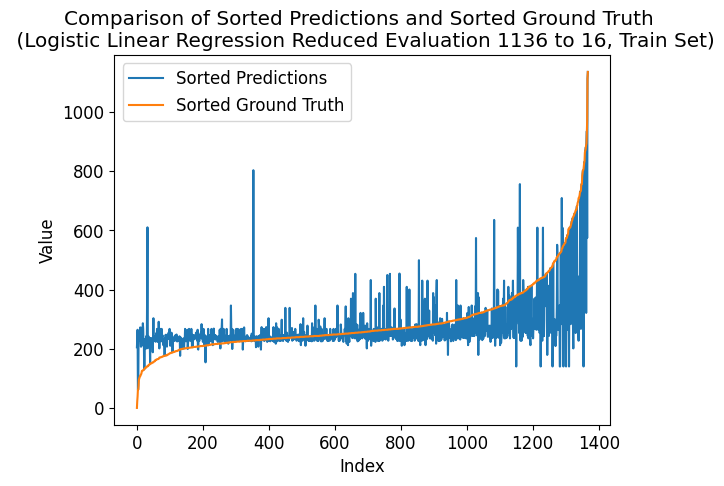

---- ---- ----
class_num = 1152
Number of unique elements: 403
[   0.   72.  144.  216.  288.  360.  432.  504.  576.  648.  720.  792.
  864.  936. 1008. 1080. 1152.]
test eval:
Mean squared error: 2.2222222222222223
Correlation coefficient: 0.5583151478918635
Coefficient of determination (R-squared score, R2 score): 0.17217591261856857
train eval:
Mean squared error: 2.039473684210526
Correlation coefficient: 0.6492383212345133
Coefficient of determination (R-squared score, R2 score): 0.3875322784700438


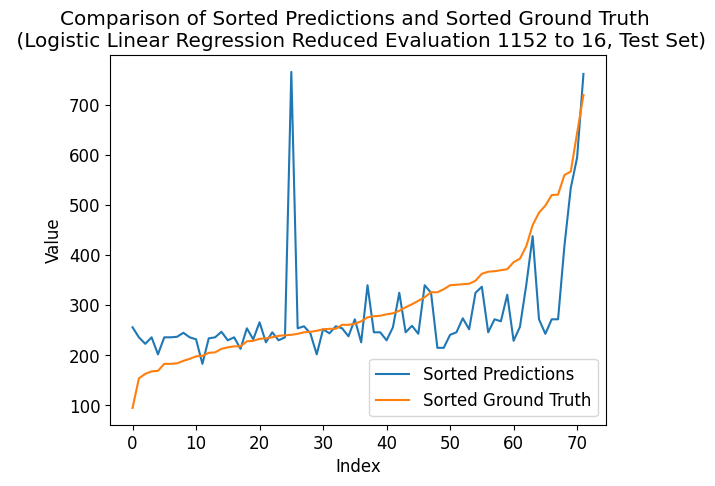

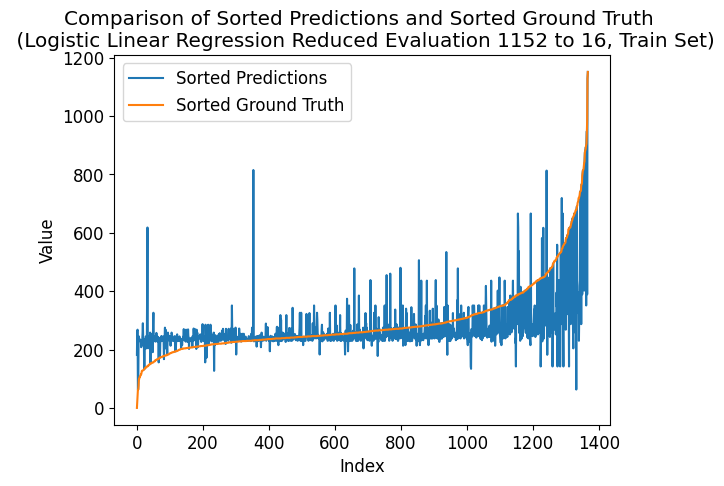

---- ---- ----
class_num = 1168
Number of unique elements: 407
[   0.   73.  146.  219.  292.  365.  438.  511.  584.  657.  730.  803.
  876.  949. 1022. 1095. 1168.]
test eval:
Mean squared error: 2.861111111111111
Correlation coefficient: 0.37720398111182396
Coefficient of determination (R-squared score, R2 score): -0.06582351250359308
train eval:
Mean squared error: 2.047514619883041
Correlation coefficient: 0.6472550866221959
Coefficient of determination (R-squared score, R2 score): 0.38511753118085756


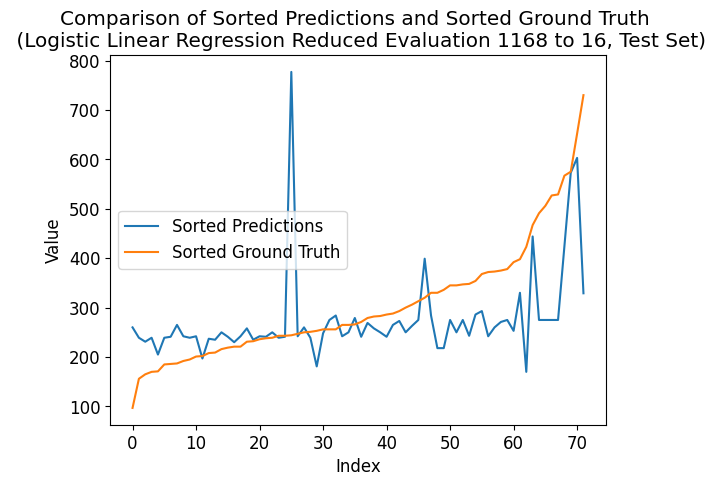

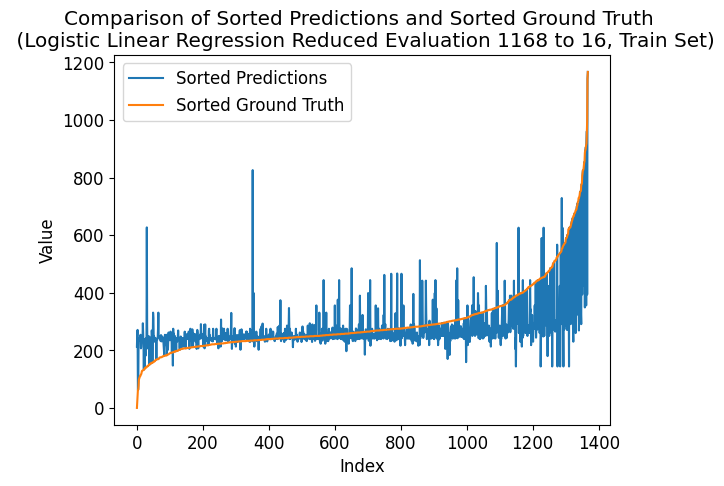

---- ---- ----
class_num = 1184
Number of unique elements: 401
[   0.   74.  148.  222.  296.  370.  444.  518.  592.  666.  740.  814.
  888.  962. 1036. 1110. 1184.]
test eval:
Mean squared error: 2.375
Correlation coefficient: 0.5348848996880021
Coefficient of determination (R-squared score, R2 score): 0.11526300661109512
train eval:
Mean squared error: 1.9568713450292399
Correlation coefficient: 0.6663066324551297
Coefficient of determination (R-squared score, R2 score): 0.4123383188044112


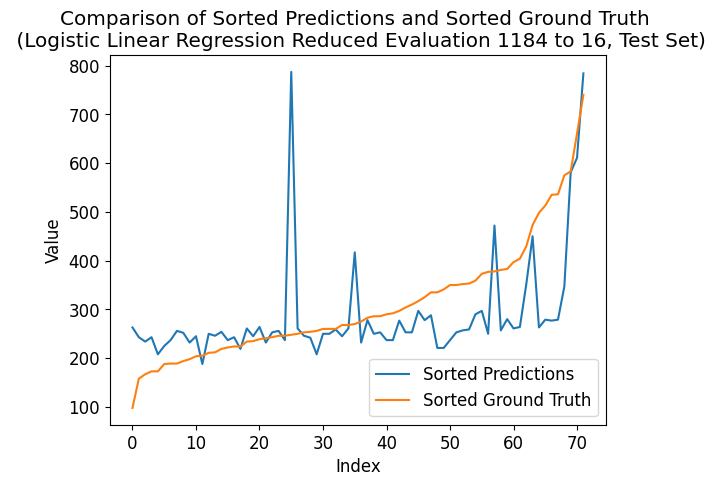

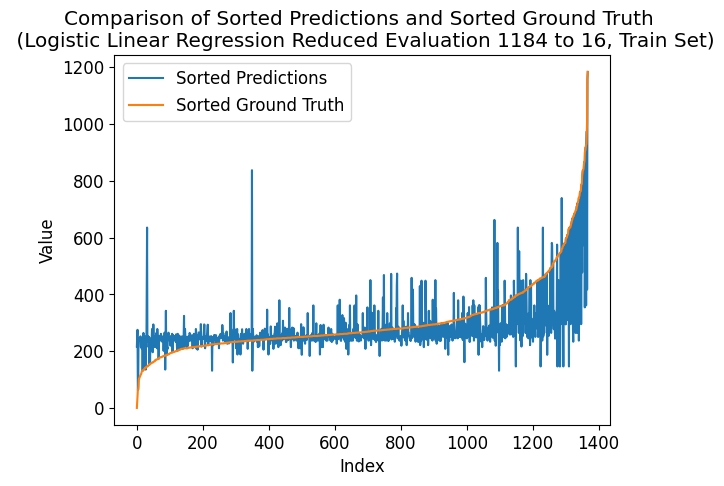

---- ---- ----
class_num = 1200
Number of unique elements: 413
[   0.   75.  150.  225.  300.  375.  450.  525.  600.  675.  750.  825.
  900.  975. 1050. 1125. 1200.]
test eval:
Mean squared error: 2.0416666666666665
Correlation coefficient: 0.5520999347686477
Coefficient of determination (R-squared score, R2 score): 0.23943661971830987
train eval:
Mean squared error: 2.1564327485380117
Correlation coefficient: 0.6223904116376103
Coefficient of determination (R-squared score, R2 score): 0.35240868153642624


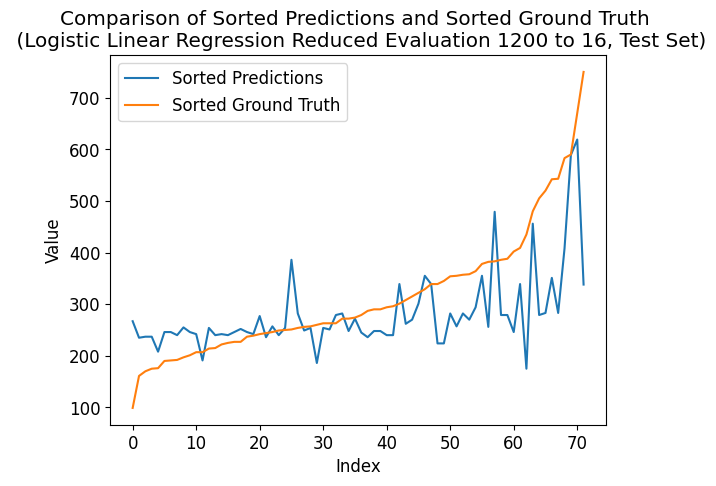

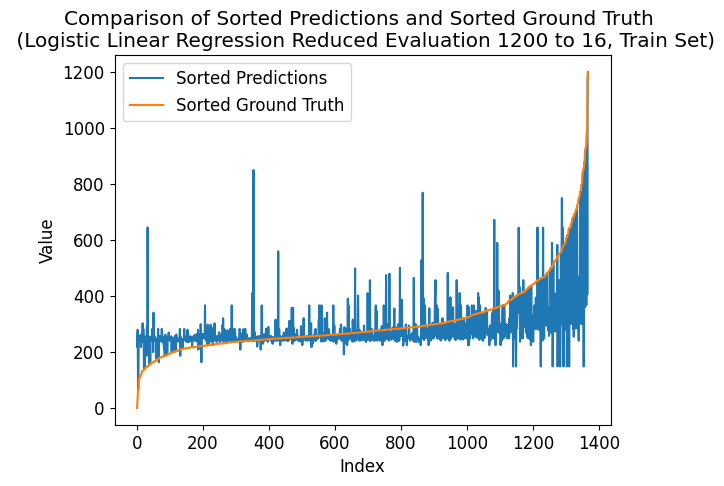

---- ---- ----
class_num = 1216
Number of unique elements: 414
[   0.   76.  152.  228.  304.  380.  456.  532.  608.  684.  760.  836.
  912.  988. 1064. 1140. 1216.]
test eval:
Mean squared error: 1.7361111111111112
Correlation coefficient: 0.6403519636542888
Coefficient of determination (R-squared score, R2 score): 0.35326243173325667
train eval:
Mean squared error: 2.2317251461988303
Correlation coefficient: 0.6098830192270563
Coefficient of determination (R-squared score, R2 score): 0.32979786601040995


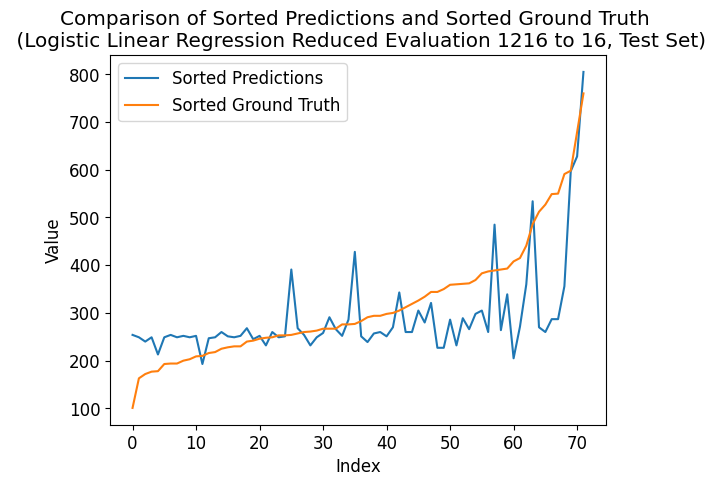

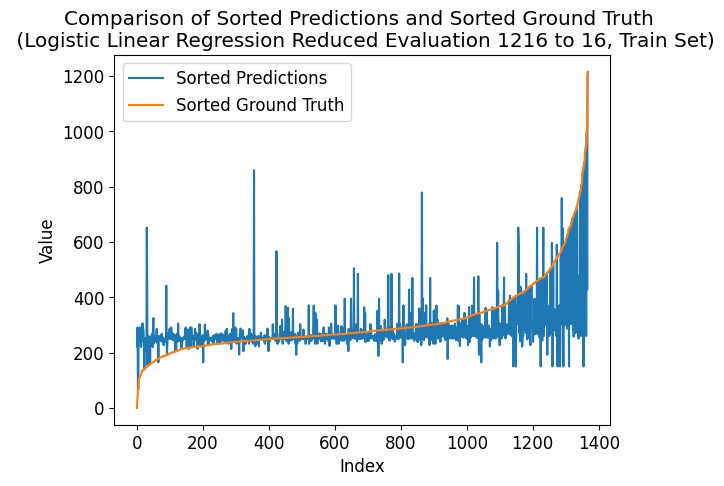

---- ---- ----
class_num = 1232
Number of unique elements: 416
[   0.   77.  154.  231.  308.  385.  462.  539.  616.  693.  770.  847.
  924. 1001. 1078. 1155. 1232.]
test eval:
Mean squared error: 2.6944444444444446
Correlation coefficient: 0.41319321442432555
Coefficient of determination (R-squared score, R2 score): -0.0037367059499857636
train eval:
Mean squared error: 2.0226608187134505
Correlation coefficient: 0.6546943130644216
Coefficient of determination (R-squared score, R2 score): 0.39258129552925136


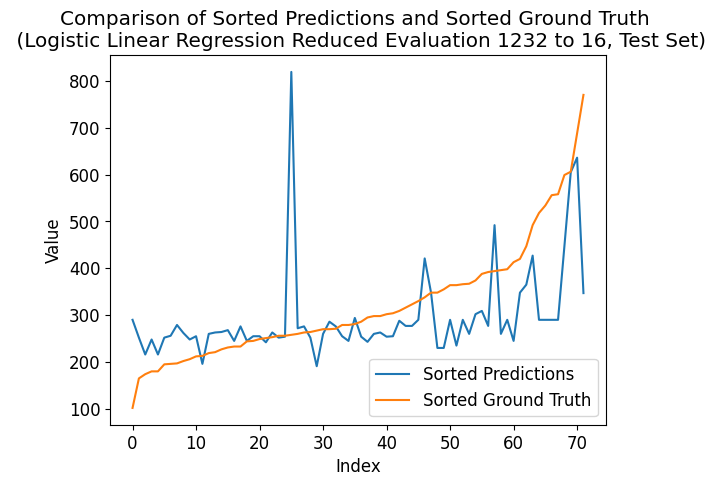

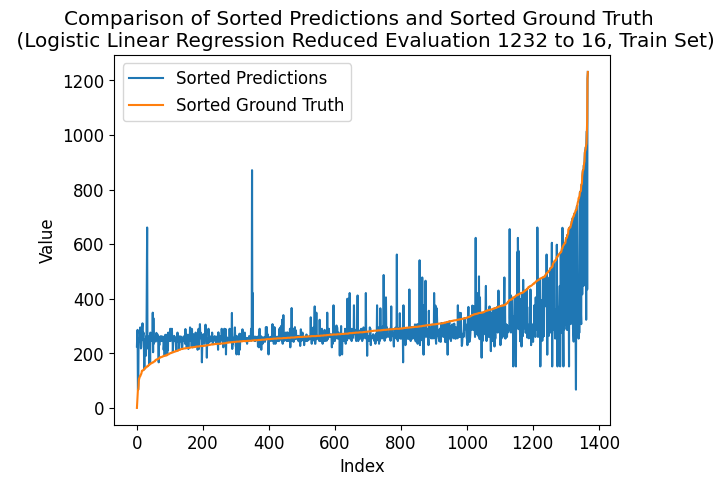

---- ---- ----
class_num = 1248
Number of unique elements: 426
[   0.   78.  156.  234.  312.  390.  468.  546.  624.  702.  780.  858.
  936. 1014. 1092. 1170. 1248.]
test eval:
Mean squared error: 2.2222222222222223
Correlation coefficient: 0.551789695015013
Coefficient of determination (R-squared score, R2 score): 0.17217591261856857
train eval:
Mean squared error: 1.7785087719298245
Correlation coefficient: 0.6992563427663594
Coefficient of determination (R-squared score, R2 score): 0.46590180412817794


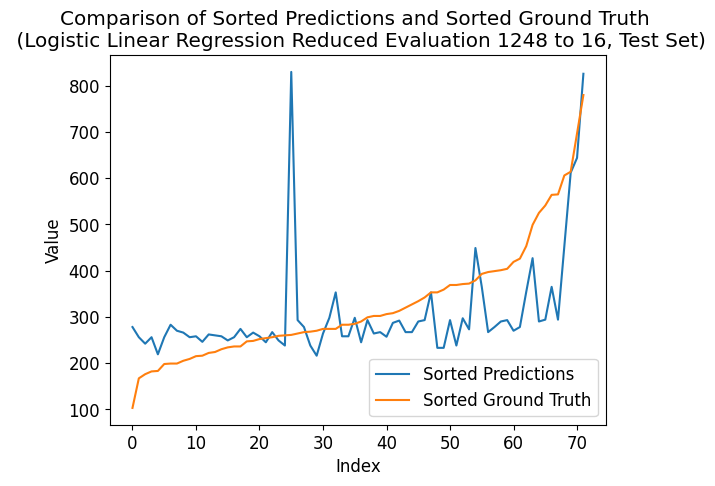

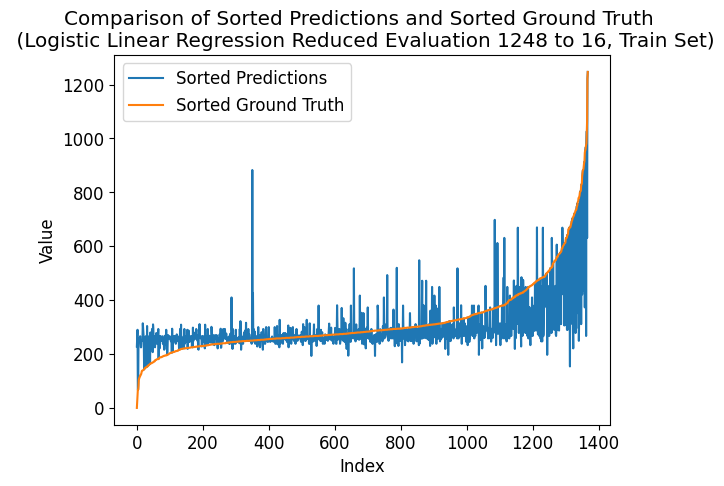

---- ---- ----
class_num = 1264
Number of unique elements: 424
[   0.   79.  158.  237.  316.  395.  474.  553.  632.  711.  790.  869.
  948. 1027. 1106. 1185. 1264.]
test eval:
Mean squared error: 2.8333333333333335
Correlation coefficient: 0.37263105431055876
Coefficient of determination (R-squared score, R2 score): -0.055475711411325124
train eval:
Mean squared error: 1.9108187134502923
Correlation coefficient: 0.6731857495591004
Coefficient of determination (R-squared score, R2 score): 0.42616823509702306


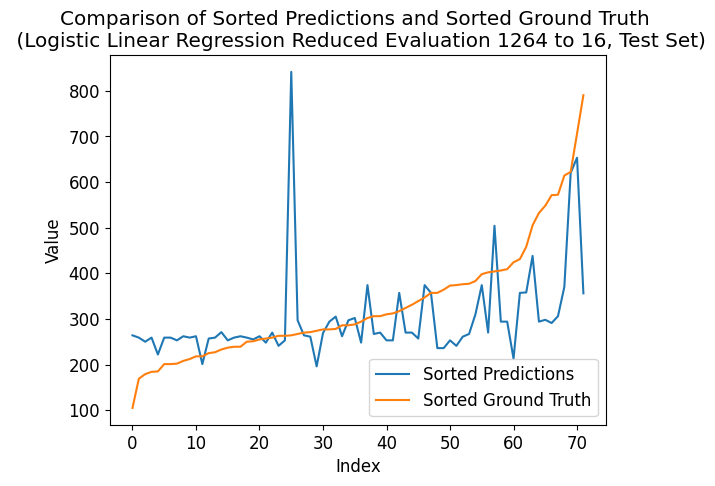

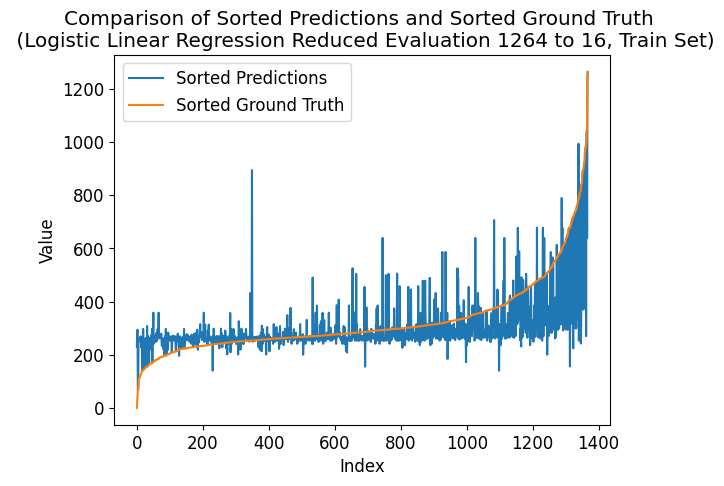

---- ---- ----
class_num = 1280
Number of unique elements: 429
[   0.   80.  160.  240.  320.  400.  480.  560.  640.  720.  800.  880.
  960. 1040. 1120. 1200. 1280.]
test eval:
Mean squared error: 2.375
Correlation coefficient: 0.5297482356467846
Coefficient of determination (R-squared score, R2 score): 0.11526300661109512
train eval:
Mean squared error: 1.8735380116959064
Correlation coefficient: 0.6795581152163802
Coefficient of determination (R-squared score, R2 score): 0.4373638816196137


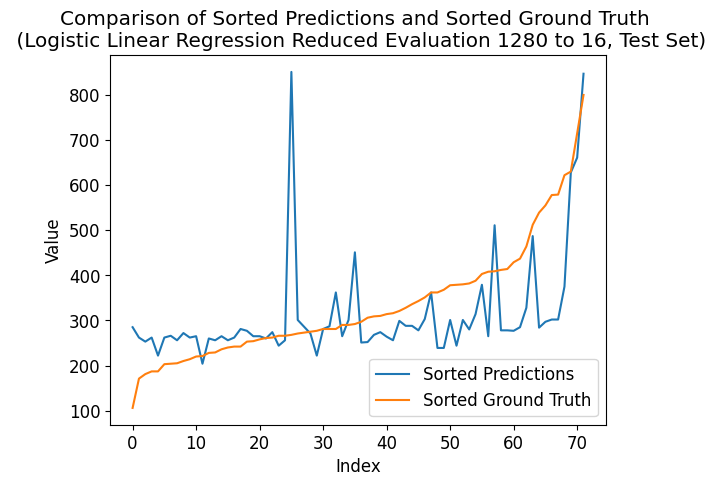

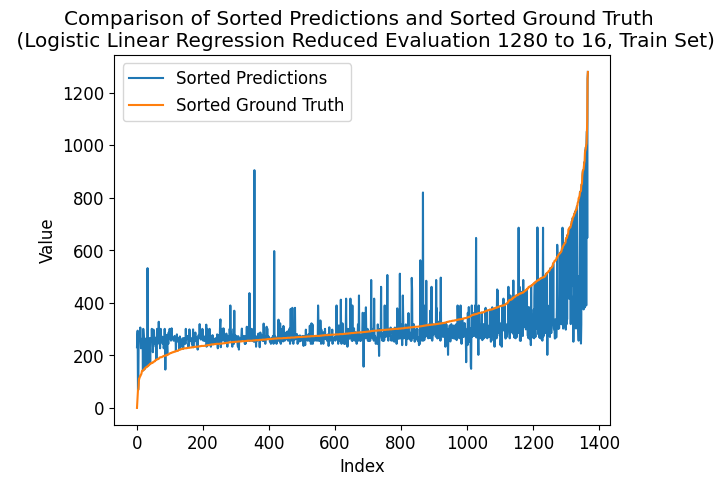

---- ---- ----
class_num = 1296
Number of unique elements: 423
[   0.   81.  162.  243.  324.  405.  486.  567.  648.  729.  810.  891.
  972. 1053. 1134. 1215. 1296.]
test eval:
Mean squared error: 2.3194444444444446
Correlation coefficient: 0.4750340598562872
Coefficient of determination (R-squared score, R2 score): 0.13595860879563093
train eval:
Mean squared error: 1.9320175438596492
Correlation coefficient: 0.6690561020826166
Coefficient of determination (R-squared score, R2 score): 0.4198020831528049


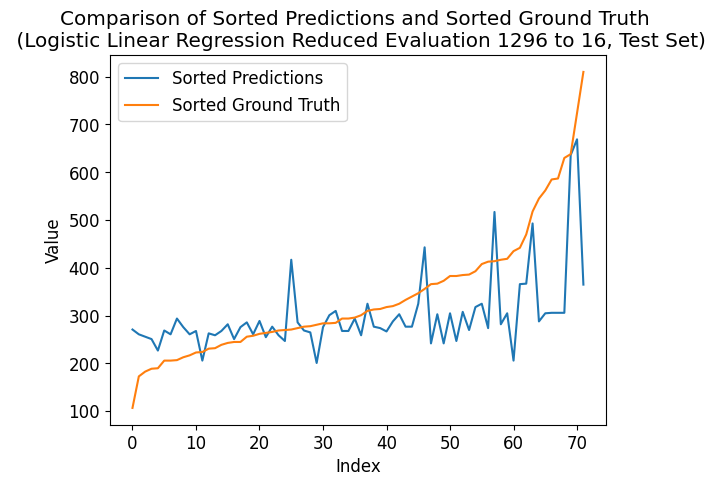

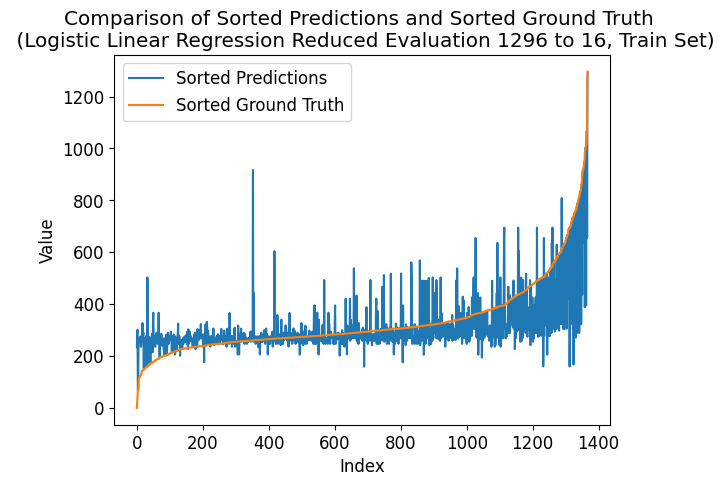

---- ---- ----
class_num = 1312
Number of unique elements: 425
[   0.   82.  164.  246.  328.  410.  492.  574.  656.  738.  820.  902.
  984. 1066. 1148. 1230. 1312.]
test eval:
Mean squared error: 1.6388888888888888
Correlation coefficient: 0.6580453433910504
Coefficient of determination (R-squared score, R2 score): 0.3894797355561943
train eval:
Mean squared error: 1.8735380116959064
Correlation coefficient: 0.6785999337378896
Coefficient of determination (R-squared score, R2 score): 0.4373638816196137


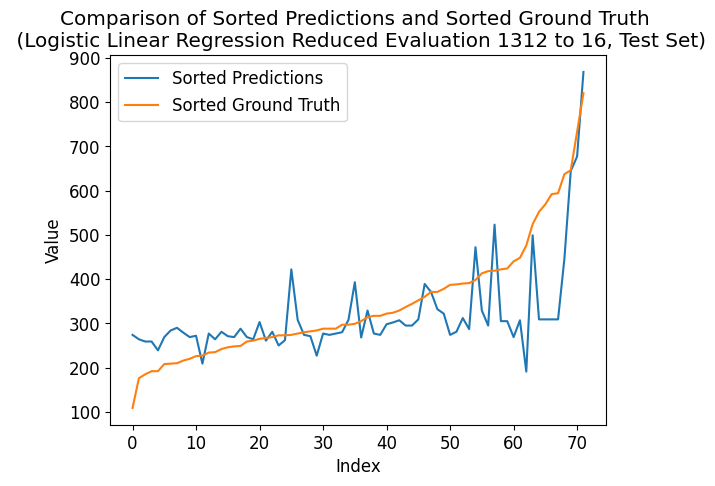

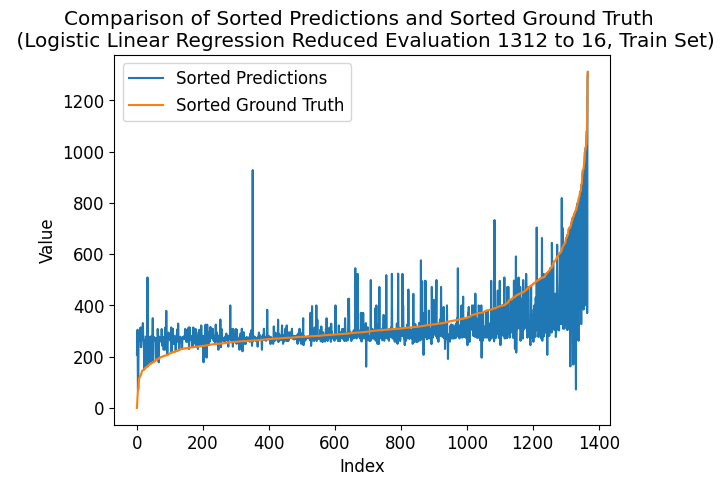

---- ---- ----
class_num = 1328
Number of unique elements: 444
[   0.   83.  166.  249.  332.  415.  498.  581.  664.  747.  830.  913.
  996. 1079. 1162. 1245. 1328.]
test eval:
Mean squared error: 1.375
Correlation coefficient: 0.7137578480576577
Coefficient of determination (R-squared score, R2 score): 0.48778384593273927
train eval:
Mean squared error: 1.8735380116959064
Correlation coefficient: 0.6765475825892652
Coefficient of determination (R-squared score, R2 score): 0.4373638816196137


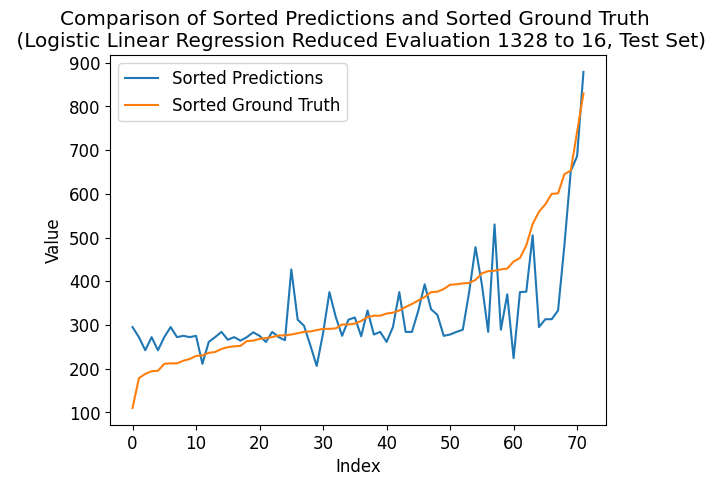

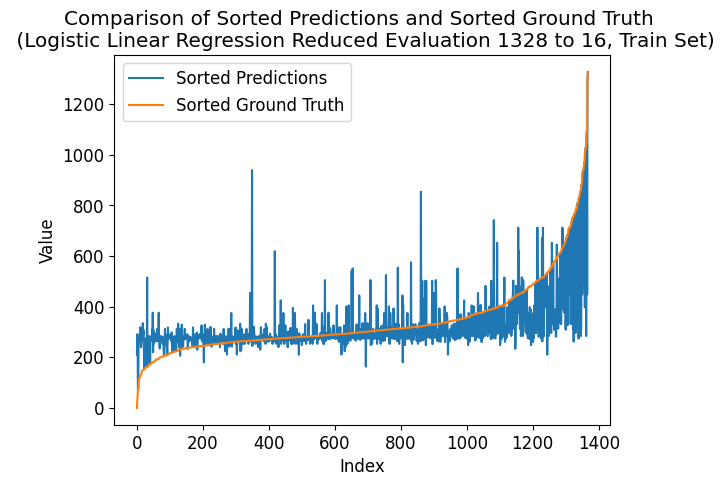

---- ---- ----
class_num = 1344
Number of unique elements: 441
[   0.   84.  168.  252.  336.  420.  504.  588.  672.  756.  840.  924.
 1008. 1092. 1176. 1260. 1344.]
test eval:
Mean squared error: 2.513888888888889
Correlation coefficient: 0.520494740256962
Coefficient of determination (R-squared score, R2 score): 0.06352400114975565
train eval:
Mean squared error: 1.7763157894736843
Correlation coefficient: 0.6981581186992978
Coefficient of determination (R-squared score, R2 score): 0.4665603715706833


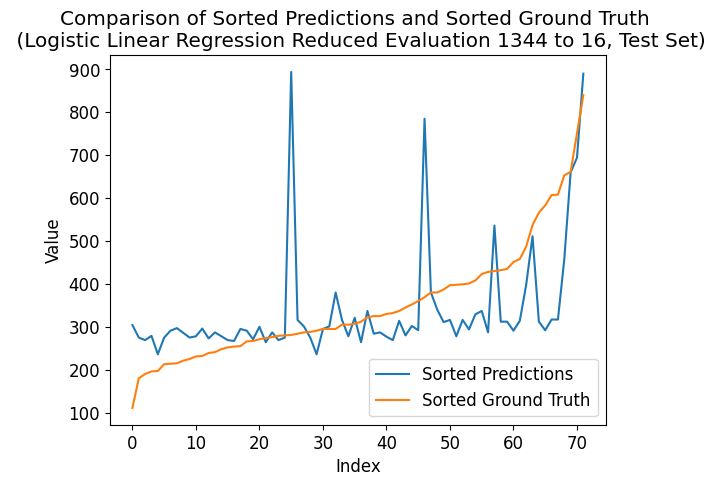

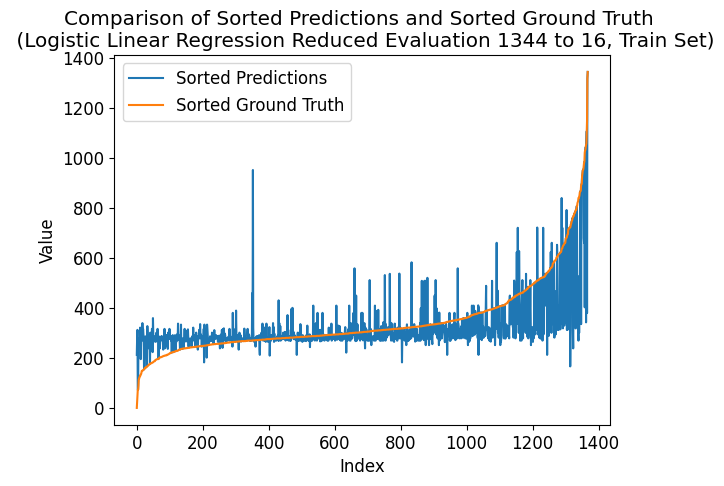

---- ---- ----
class_num = 1360
Number of unique elements: 436
[   0.   85.  170.  255.  340.  425.  510.  595.  680.  765.  850.  935.
 1020. 1105. 1190. 1275. 1360.]
test eval:
Mean squared error: 2.4583333333333335
Correlation coefficient: 0.5153349773840759
Coefficient of determination (R-squared score, R2 score): 0.08421960333429146
train eval:
Mean squared error: 1.885233918128655
Correlation coefficient: 0.6769155138580818
Coefficient of determination (R-squared score, R2 score): 0.433851521926252


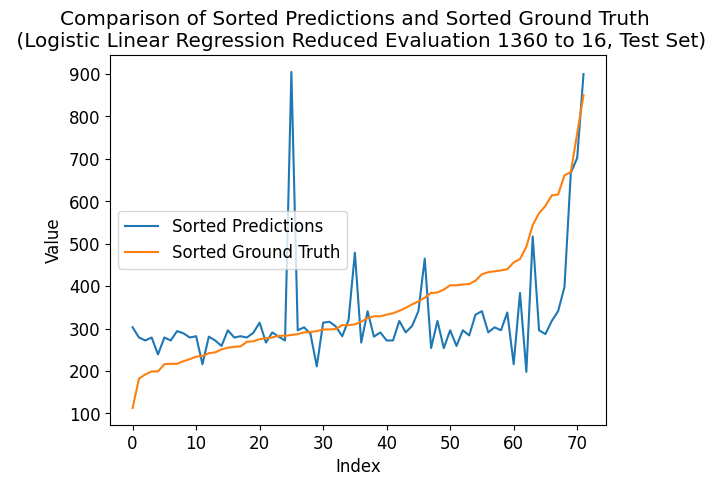

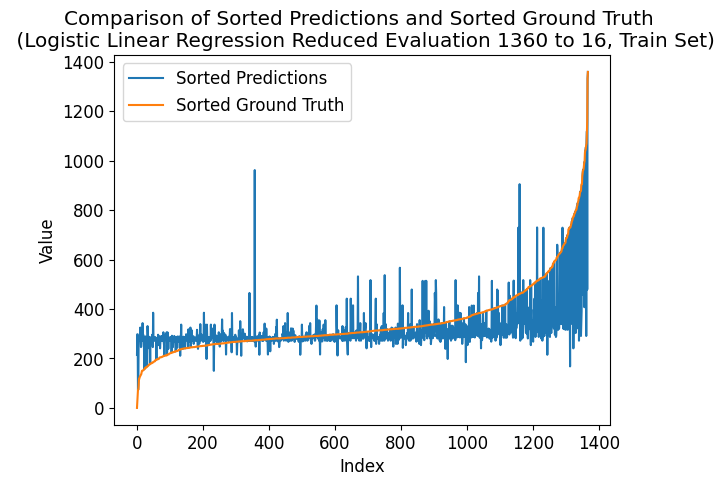

---- ---- ----
class_num = 1376
Number of unique elements: 440
[   0.   86.  172.  258.  344.  430.  516.  602.  688.  774.  860.  946.
 1032. 1118. 1204. 1290. 1376.]
test eval:
Mean squared error: 2.8333333333333335
Correlation coefficient: 0.36894054546784794
Coefficient of determination (R-squared score, R2 score): -0.055475711411325124
train eval:
Mean squared error: 1.9137426900584795
Correlation coefficient: 0.671191543372111
Coefficient of determination (R-squared score, R2 score): 0.4252901451736827


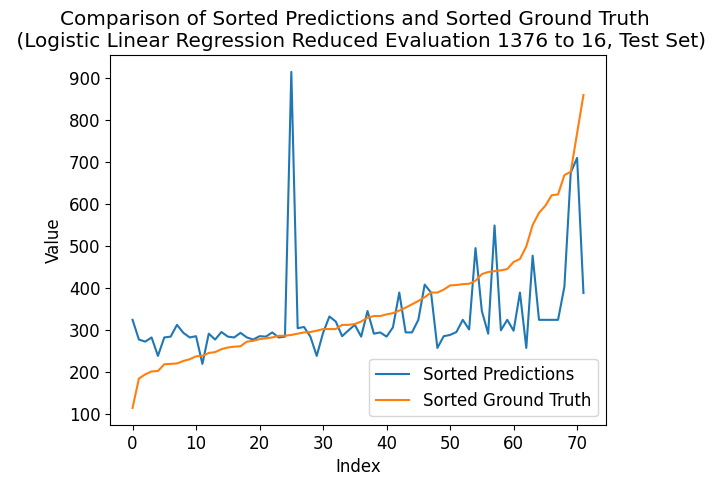

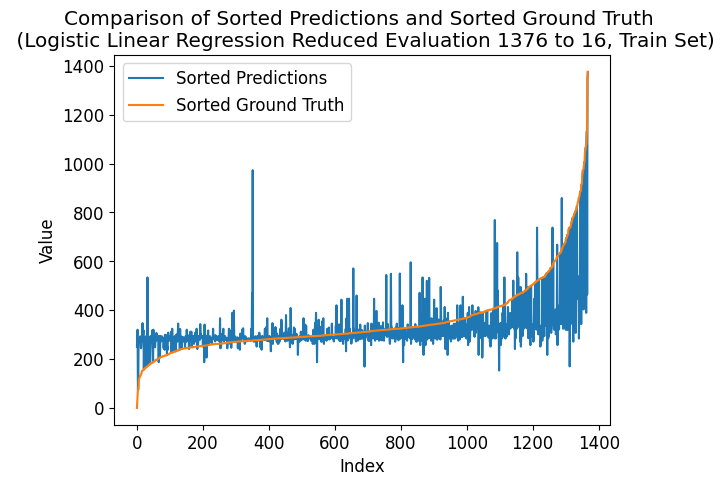

---- ---- ----
class_num = 1392
Number of unique elements: 455
[   0.   87.  174.  261.  348.  435.  522.  609.  696.  783.  870.  957.
 1044. 1131. 1218. 1305. 1392.]
test eval:
Mean squared error: 1.6944444444444444
Correlation coefficient: 0.6519114688128772
Coefficient of determination (R-squared score, R2 score): 0.3687841333716585
train eval:
Mean squared error: 1.888157894736842
Correlation coefficient: 0.6765016656471918
Coefficient of determination (R-squared score, R2 score): 0.4329734320029115


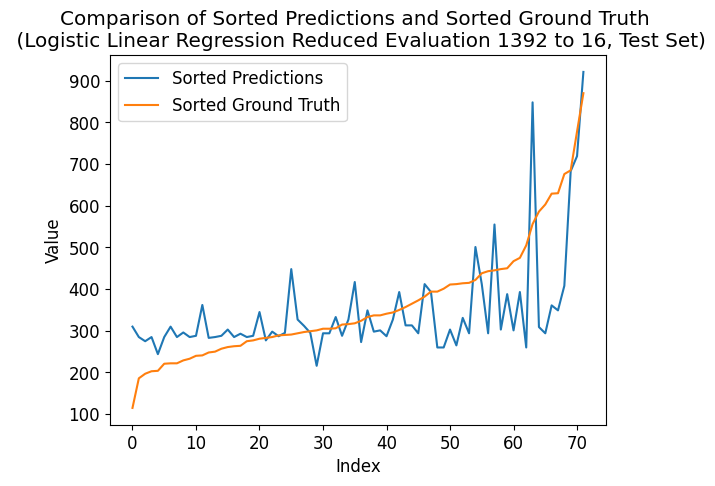

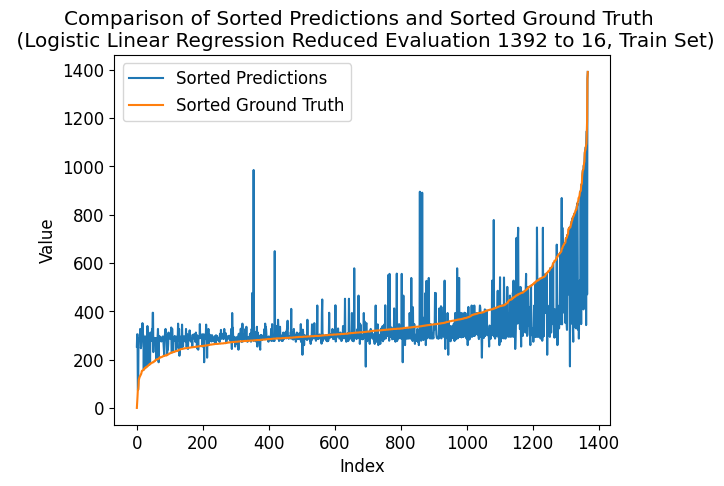

---- ---- ----
class_num = 1408
Number of unique elements: 451
[   0.   88.  176.  264.  352.  440.  528.  616.  704.  792.  880.  968.
 1056. 1144. 1232. 1320. 1408.]
test eval:
Mean squared error: 2.1805555555555554
Correlation coefficient: 0.522437499668249
Coefficient of determination (R-squared score, R2 score): 0.1876976142569704
train eval:
Mean squared error: 1.9276315789473684
Correlation coefficient: 0.6678714220108946
Coefficient of determination (R-squared score, R2 score): 0.4211192180378156


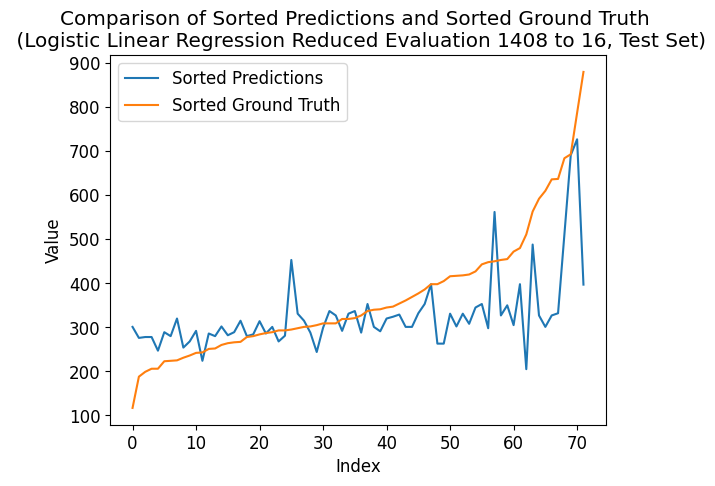

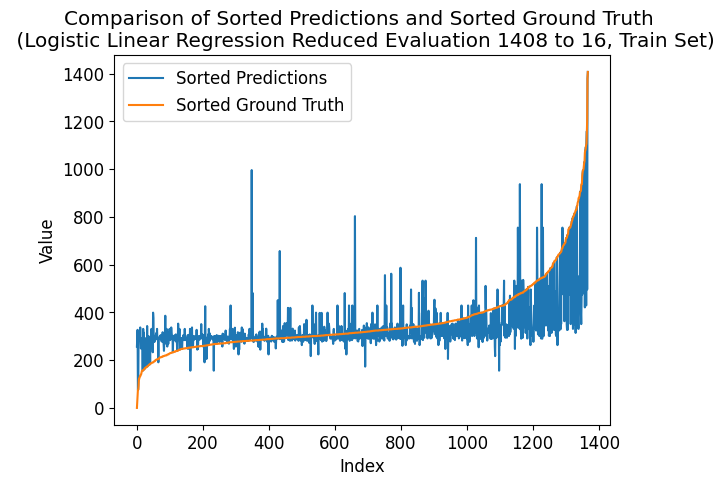

---- ---- ----
class_num = 1424
Number of unique elements: 451
[   0.   89.  178.  267.  356.  445.  534.  623.  712.  801.  890.  979.
 1068. 1157. 1246. 1335. 1424.]
test eval:
Mean squared error: 1.5416666666666667
Correlation coefficient: 0.6815230800490357
Coefficient of determination (R-squared score, R2 score): 0.42569703937913195
train eval:
Mean squared error: 1.827485380116959
Correlation coefficient: 0.6883100893506918
Coefficient of determination (R-squared score, R2 score): 0.4511937979122256


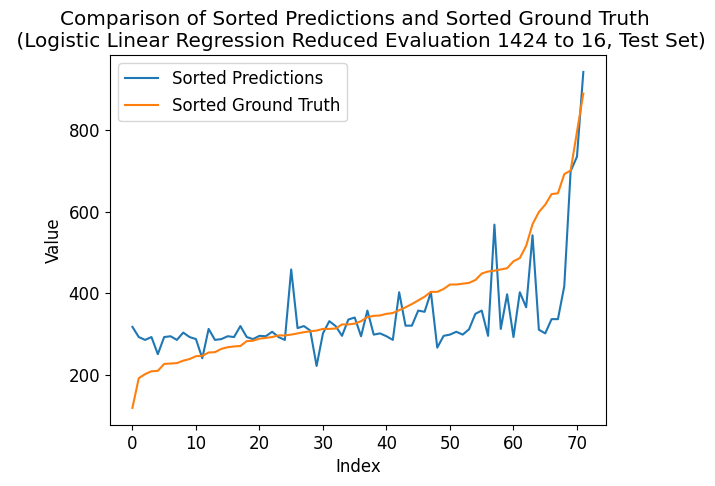

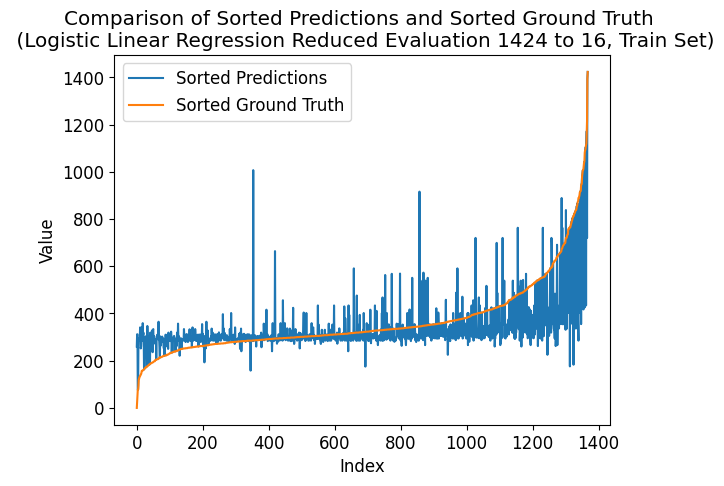

---- ---- ----
class_num = 1440
Number of unique elements: 463
[   0.   90.  180.  270.  360.  450.  540.  630.  720.  810.  900.  990.
 1080. 1170. 1260. 1350. 1440.]
test eval:
Mean squared error: 2.7083333333333335
Correlation coefficient: 0.39510944715836155
Coefficient of determination (R-squared score, R2 score): -0.008910606496119522
train eval:
Mean squared error: 1.9108187134502923
Correlation coefficient: 0.6697597773741575
Coefficient of determination (R-squared score, R2 score): 0.42616823509702306


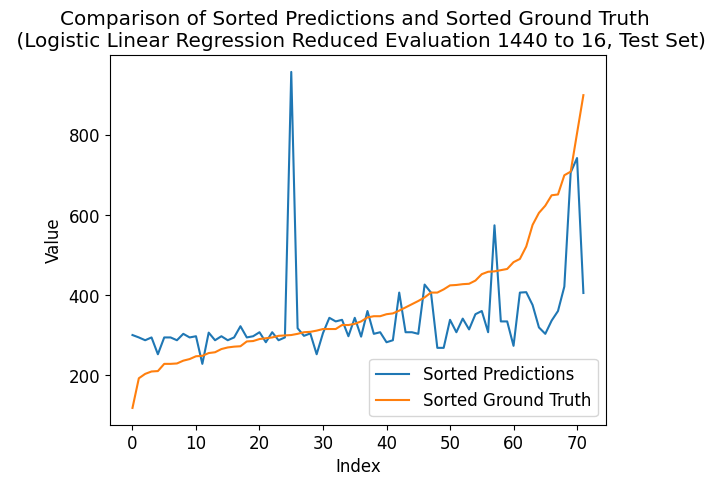

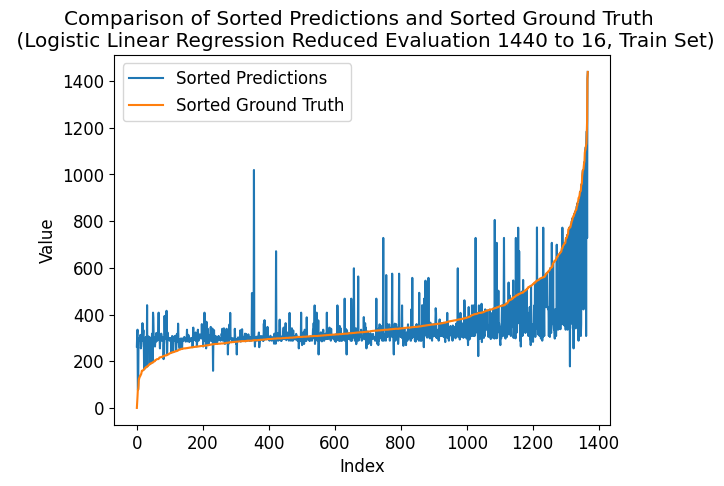

---- ---- ----
class_num = 1456
Number of unique elements: 461
[   0.   91.  182.  273.  364.  455.  546.  637.  728.  819.  910. 1001.
 1092. 1183. 1274. 1365. 1456.]
test eval:
Mean squared error: 2.236111111111111
Correlation coefficient: 0.5540077773787502
Coefficient of determination (R-squared score, R2 score): 0.1670020120724346
train eval:
Mean squared error: 1.8245614035087718
Correlation coefficient: 0.6902113450971668
Coefficient of determination (R-squared score, R2 score): 0.45207188783556607


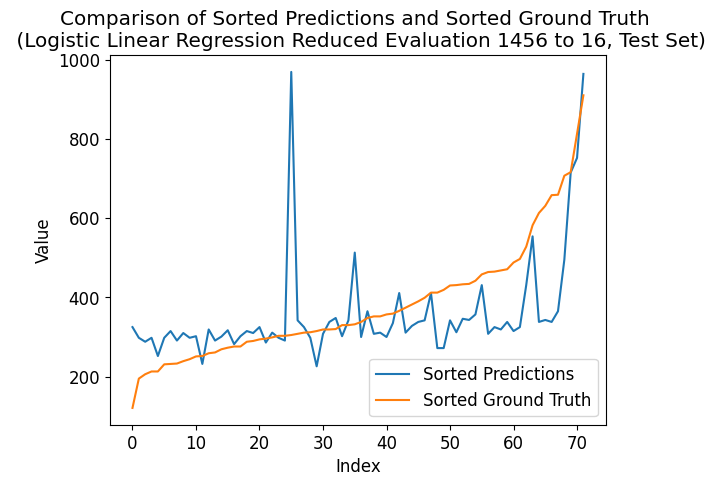

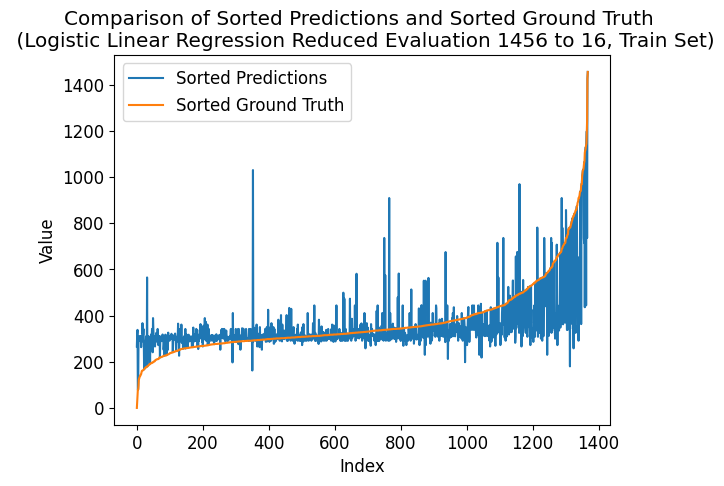

---- ---- ----
class_num = 1472
Number of unique elements: 460
[   0.   92.  184.  276.  368.  460.  552.  644.  736.  828.  920. 1012.
 1104. 1196. 1288. 1380. 1472.]
test eval:
Mean squared error: 2.888888888888889
Correlation coefficient: 0.3703595540351983
Coefficient of determination (R-squared score, R2 score): -0.07617131359586082
train eval:
Mean squared error: 1.777046783625731
Correlation coefficient: 0.6985729178321639
Coefficient of determination (R-squared score, R2 score): 0.4663408490898482


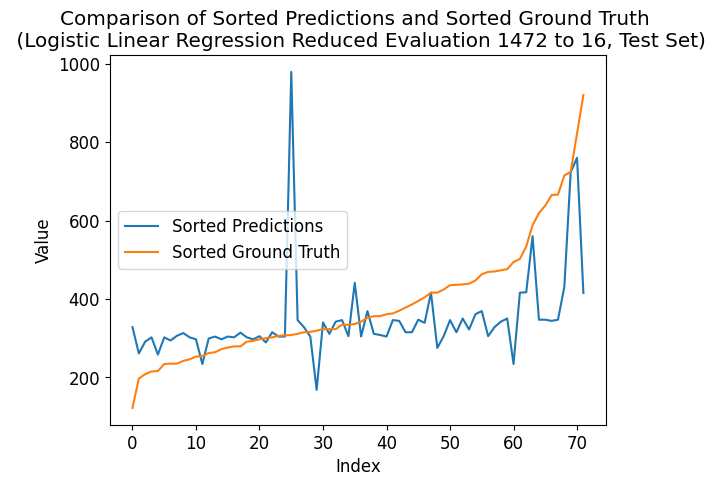

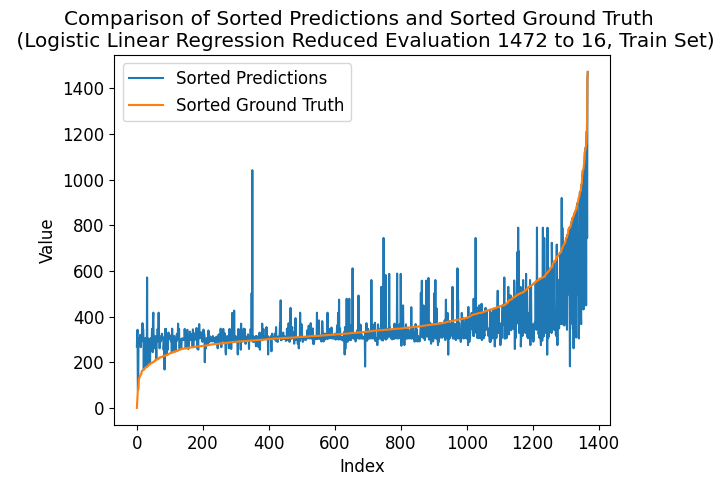

---- ---- ----
class_num = 1488
Number of unique elements: 462
[   0.   93.  186.  279.  372.  465.  558.  651.  744.  837.  930. 1023.
 1116. 1209. 1302. 1395. 1488.]
test eval:
Mean squared error: 2.5
Correlation coefficient: 0.513170155454038
Coefficient of determination (R-squared score, R2 score): 0.06869790169588963
train eval:
Mean squared error: 1.8845029239766082
Correlation coefficient: 0.6775794782805072
Coefficient of determination (R-squared score, R2 score): 0.4340710444070871


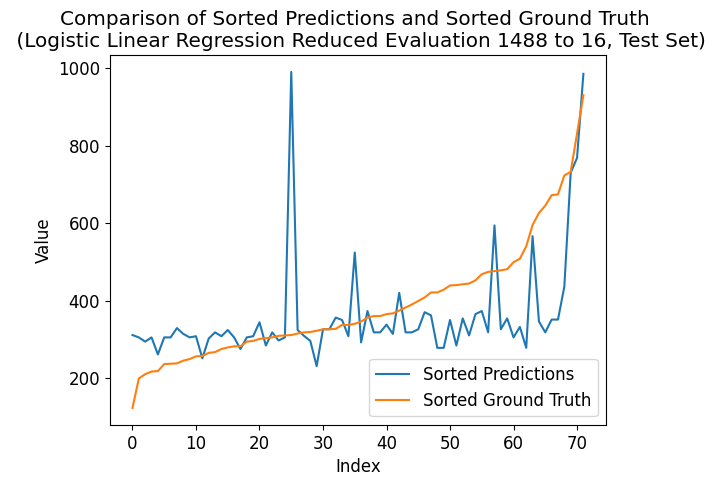

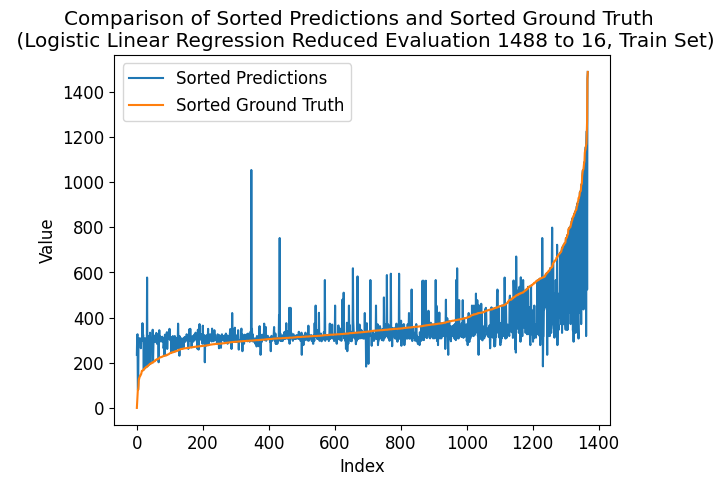

---- ---- ----
class_num = 1504
Number of unique elements: 472
[   0.   94.  188.  282.  376.  470.  564.  658.  752.  846.  940. 1034.
 1128. 1222. 1316. 1410. 1504.]
test eval:
Mean squared error: 2.0416666666666665
Correlation coefficient: 0.5471234904879365
Coefficient of determination (R-squared score, R2 score): 0.23943661971830987
train eval:
Mean squared error: 1.7646198830409356
Correlation coefficient: 0.7003232561069573
Coefficient of determination (R-squared score, R2 score): 0.47007273126404503


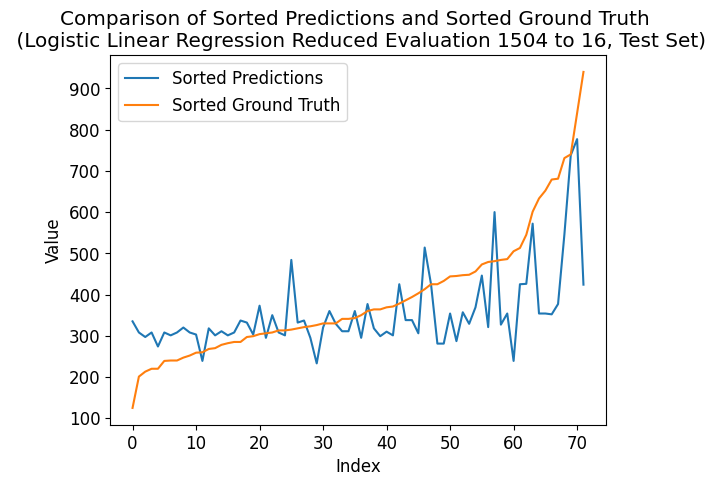

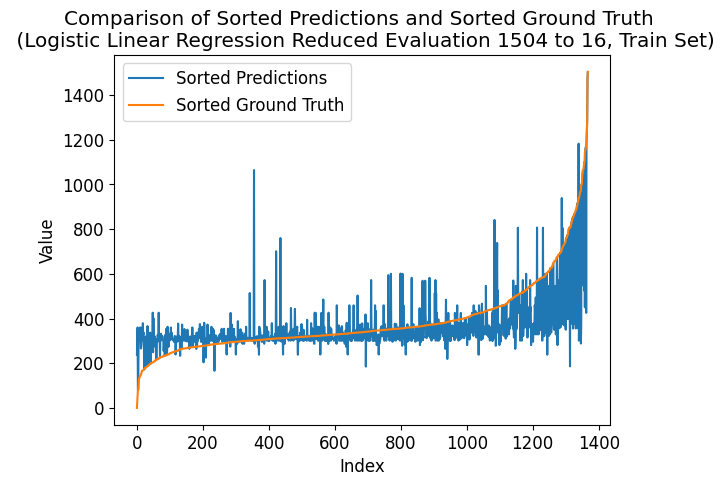

---- ---- ----
class_num = 1520
Number of unique elements: 477
[   0.   95.  190.  285.  380.  475.  570.  665.  760.  855.  950. 1045.
 1140. 1235. 1330. 1425. 1520.]
test eval:
Mean squared error: 1.6666666666666667
Correlation coefficient: 0.6624565122563918
Coefficient of determination (R-squared score, R2 score): 0.37913193446392635
train eval:
Mean squared error: 1.8428362573099415
Correlation coefficient: 0.6853520467251413
Coefficient of determination (R-squared score, R2 score): 0.44658382581468836


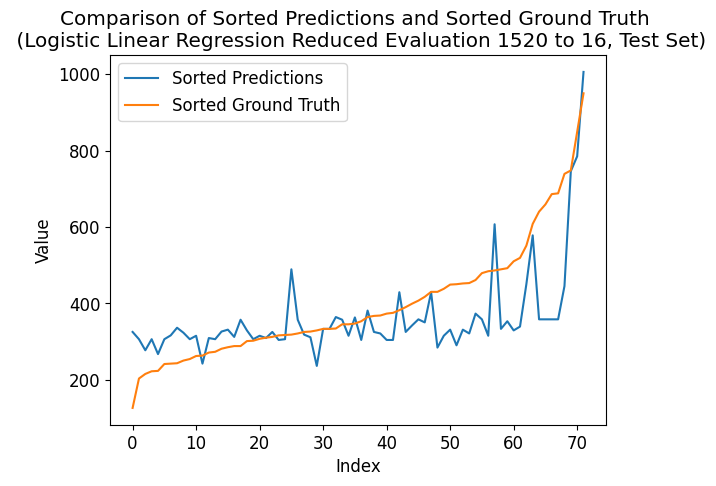

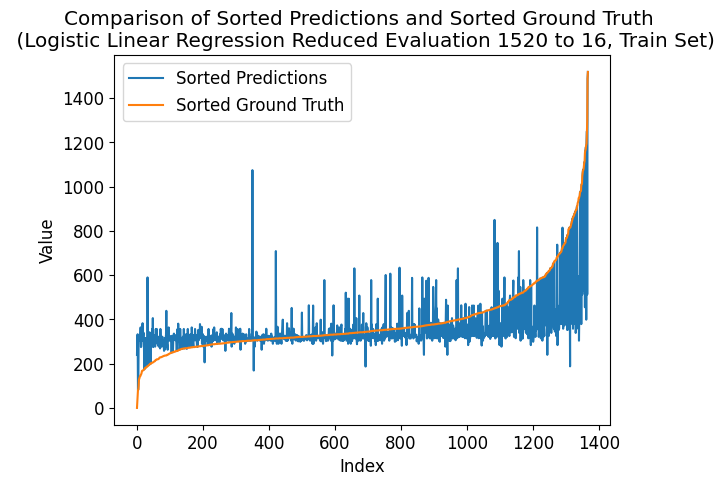

---- ---- ----
class_num = 1536
Number of unique elements: 473
[   0.   96.  192.  288.  384.  480.  576.  672.  768.  864.  960. 1056.
 1152. 1248. 1344. 1440. 1536.]
test eval:
Mean squared error: 2.8055555555555554
Correlation coefficient: 0.3792061584543811
Coefficient of determination (R-squared score, R2 score): -0.04512791031905716
train eval:
Mean squared error: 1.7997076023391814
Correlation coefficient: 0.6945939351703223
Coefficient of determination (R-squared score, R2 score): 0.45953565218395975


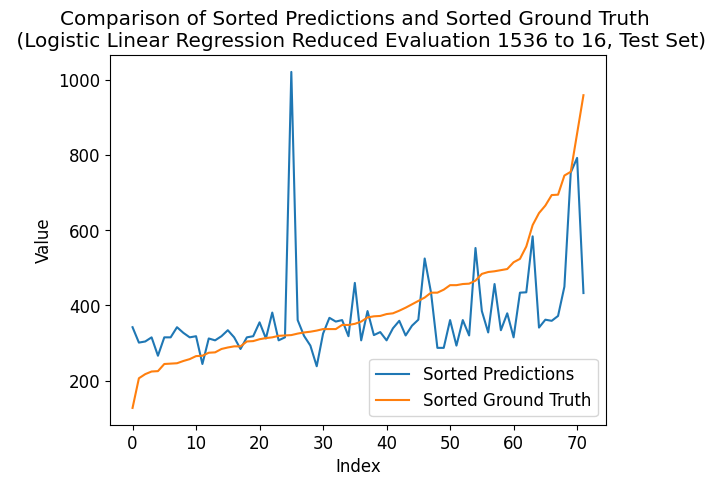

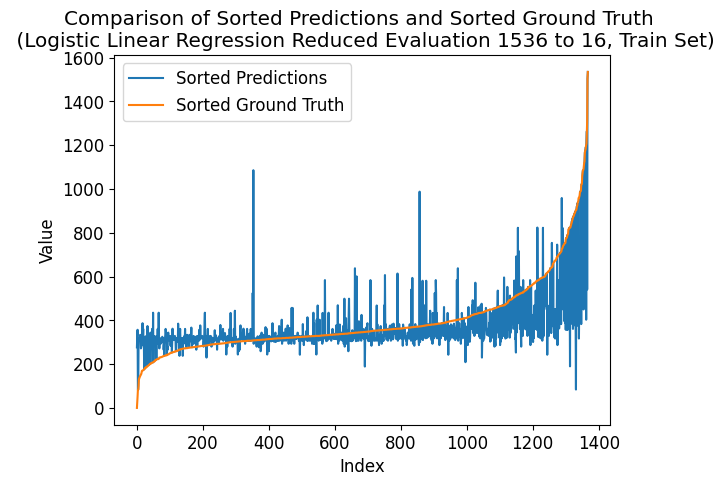

---- ---- ----
class_num = 1552
Number of unique elements: 475
[   0.   97.  194.  291.  388.  485.  582.  679.  776.  873.  970. 1067.
 1164. 1261. 1358. 1455. 1552.]
test eval:
Mean squared error: 2.9166666666666665
Correlation coefficient: 0.48813135853136935
Coefficient of determination (R-squared score, R2 score): -0.08651911468812878
train eval:
Mean squared error: 1.7960526315789473
Correlation coefficient: 0.6966405901760792
Coefficient of determination (R-squared score, R2 score): 0.46063326458813536


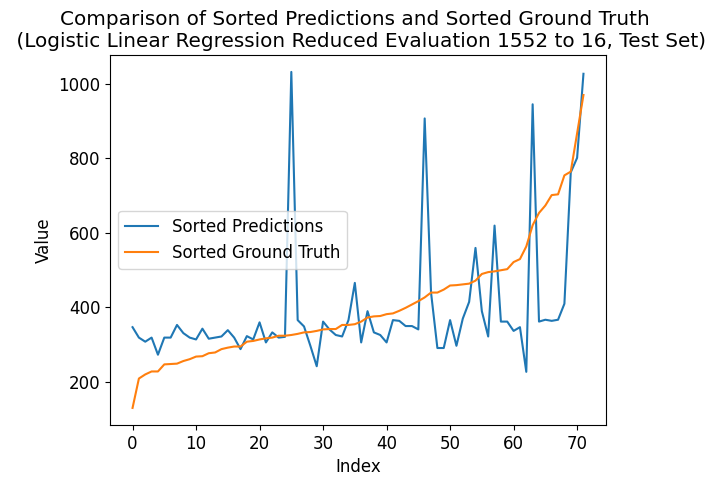

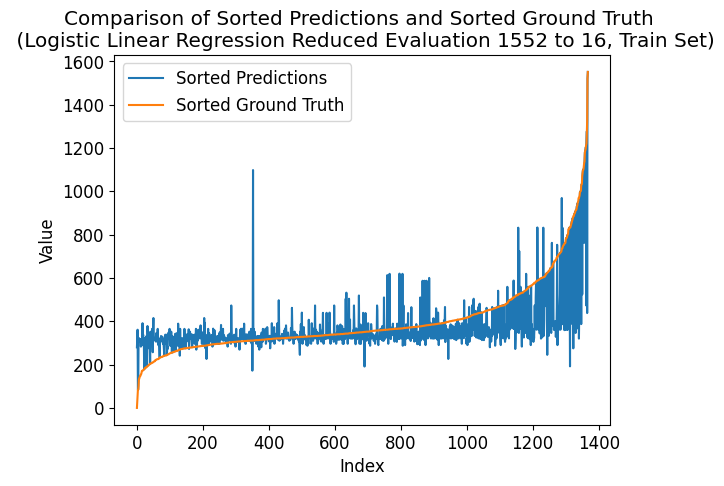

---- ---- ----
class_num = 1568
Number of unique elements: 475
[   0.   98.  196.  294.  392.  490.  588.  686.  784.  882.  980. 1078.
 1176. 1274. 1372. 1470. 1568.]
test eval:
Mean squared error: 2.9305555555555554
Correlation coefficient: 0.3666044986537278
Coefficient of determination (R-squared score, R2 score): -0.09169301523426276
train eval:
Mean squared error: 1.8326023391812865
Correlation coefficient: 0.689273814737865
Coefficient of determination (R-squared score, R2 score): 0.44965714054637984


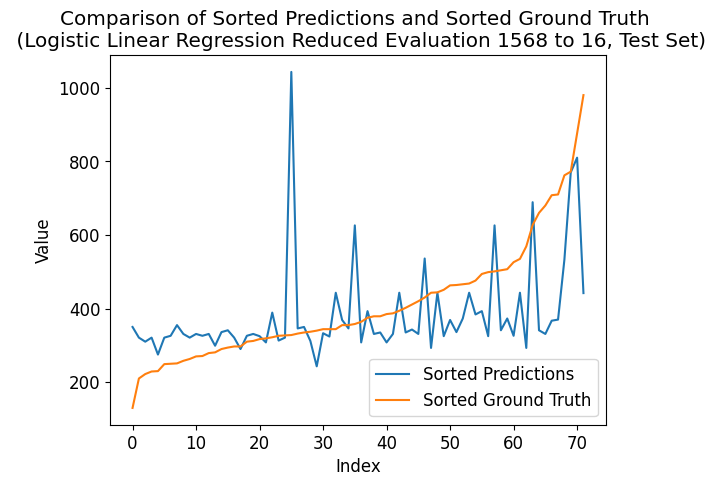

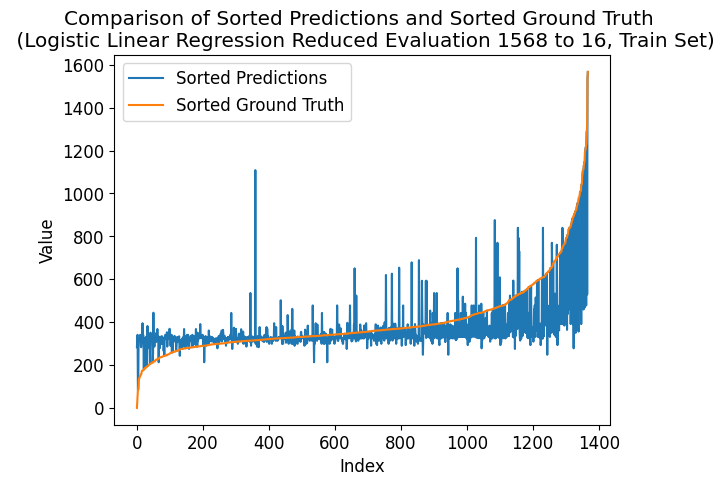

---- ---- ----
class_num = 1584
Number of unique elements: 473
[   0.   99.  198.  297.  396.  495.  594.  693.  792.  891.  990. 1089.
 1188. 1287. 1386. 1485. 1584.]
test eval:
Mean squared error: 2.2777777777777777
Correlation coefficient: 0.5504722394101675
Coefficient of determination (R-squared score, R2 score): 0.15148031043403276
train eval:
Mean squared error: 1.7894736842105263
Correlation coefficient: 0.694607896288759
Coefficient of determination (R-squared score, R2 score): 0.46260896691565134


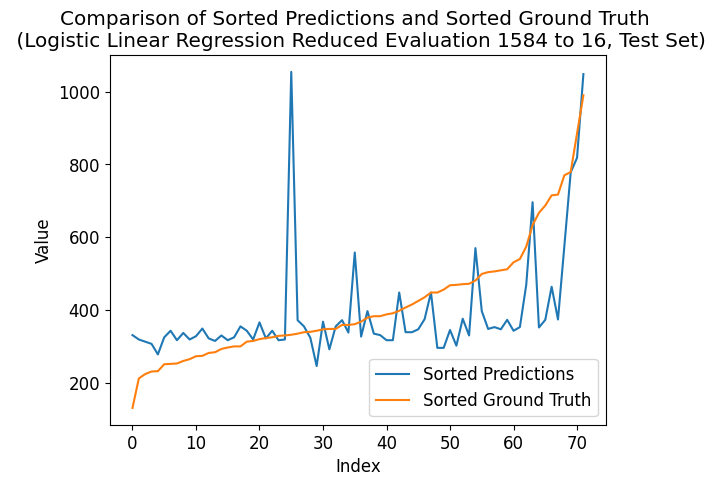

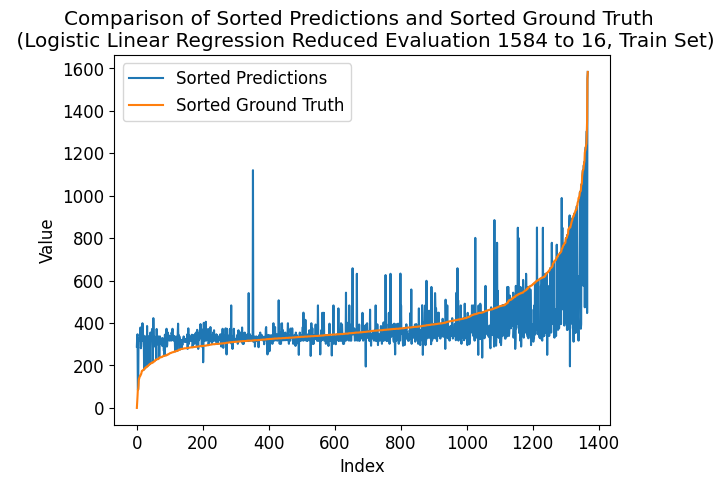

---- ---- ----
class_num = 1600
Number of unique elements: 488
[   0.  100.  200.  300.  400.  500.  600.  700.  800.  900. 1000. 1100.
 1200. 1300. 1400. 1500. 1600.]
test eval:
Mean squared error: 2.1805555555555554
Correlation coefficient: 0.5149689184092667
Coefficient of determination (R-squared score, R2 score): 0.1876976142569704
train eval:
Mean squared error: 1.8179824561403508
Correlation coefficient: 0.6890447414930153
Coefficient of determination (R-squared score, R2 score): 0.45404759016308205


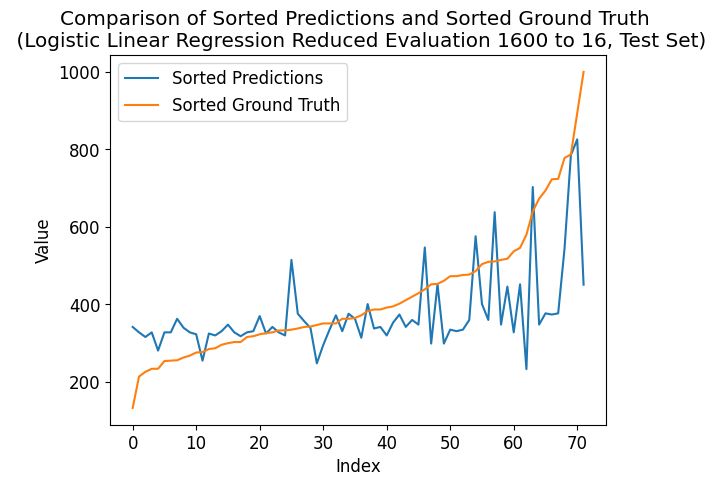

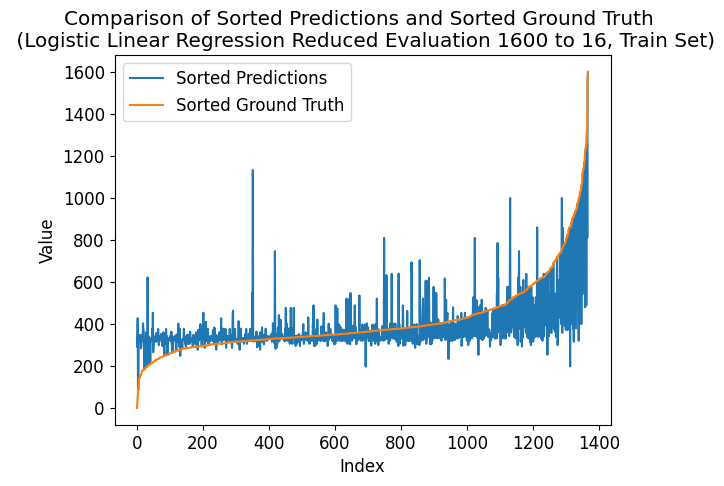

In [ ]:
# independent data
x = group_satcked_green
# dependent data (labels/targets)
y = np.squeeze(stacked_red)

# Split the data into train and test sets
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.05, random_state=42)
# Calculate the minimum and maximum values
infinitesimal = np.finfo(float).eps
min_val = np.min(y) - infinitesimal # to guarantee to include min
max_val = np.max(y) + infinitesimal # to guarantee to include max

print("x_train shape:", x_train.shape)
print("y_train shape:", y_train.shape)
print("x_test shape:", x_test.shape)
print("y_test shape:", y_test.shape)

reduced_class_num = 16
class_num_array = np.arange(reduced_class_num, reduced_class_num * 100 + 1, reduced_class_num)
# class_num_array = np.arange(reduced_class_num * 5, reduced_class_num * 40 + 1, reduced_class_num)
mse_test_list = []
correlation_test_list = []
r_squared_test_list = []
mse_train_list = []
correlation_train_list = []
r_squared_train_list = []

for class_num in class_num_array:
    print('---- ---- ----')
    print(f'class_num = {class_num}')

    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.05, random_state=42)

    # Generate class_num+1 evenly spaced intervals
    intervals = np.linspace(min_val, max_val, num=class_num+1) # num = class num + 1
    # print(intervals)
    # Digitize the array to get the indices of the intervals
    y_train = np.digitize(y_train, intervals) - 1
    y_test = np.digitize(y_test, intervals) - 1

    # to see unique elements (see if we have all 0, 1,..., class_num-1 classes, better close to all)
    unique_elements = np.unique(y_train)
    # print("Unique elements:", unique_elements)
    print("Number of unique elements:", len(unique_elements))

    model = linear_model.LogisticRegression(fit_intercept=True, max_iter=1000, multi_class='multinomial')
    fit_result = model.fit(x_train, y_train)

    y_pred = model.predict(x_test)
    y_pred_ = model.predict(x_train)

    # Define the boundaries for digitization
    intervals = np.arange(0, class_num+1, class_num/16)
    print(intervals)

    y_train_digital = np.digitize(y_train, intervals) - 1
    y_test_digital = np.digitize(y_test, intervals) - 1
    y_pred_train_digital = np.digitize(y_pred_, intervals) - 1
    y_pred_test_digital = np.digitize(y_pred, intervals) - 1
    # print(y_pred)
    # print(y_pred_test_digital)
    print("test eval:")
    mse = mean_squared_error(y_test_digital, y_pred_test_digital)
    print("Mean squared error:", mse)
    correlation = np.corrcoef(y_pred_test_digital, y_test_digital)[0, 1]
    print("Correlation coefficient:", correlation)
    r_squared = r2_score(y_test_digital, y_pred_test_digital)
    print("Coefficient of determination (R-squared score, R2 score):", r_squared)
    mse_test_list.append(mse)
    correlation_test_list.append(correlation)
    r_squared_test_list.append(r_squared)

    print("train eval:")
    mse = mean_squared_error(y_train_digital, y_pred_train_digital)
    print("Mean squared error:", mse)
    correlation = np.corrcoef(y_pred_train_digital, y_train_digital)[0, 1]
    print("Correlation coefficient:", correlation)
    r_squared = r2_score(y_train_digital, y_pred_train_digital)
    print("Coefficient of determination (R-squared score, R2 score):", r_squared)
    mse_train_list.append(mse)
    correlation_train_list.append(correlation)
    r_squared_train_list.append(r_squared)

    plot_comparison(y_test, y_pred, f'Logistic Linear Regression Reduced Evaluation {class_num} to {reduced_class_num}, Test Set')
    plot_comparison(y_train, y_pred_, f'Logistic Linear Regression Reduced Evaluation {class_num} to {reduced_class_num}, Train Set')



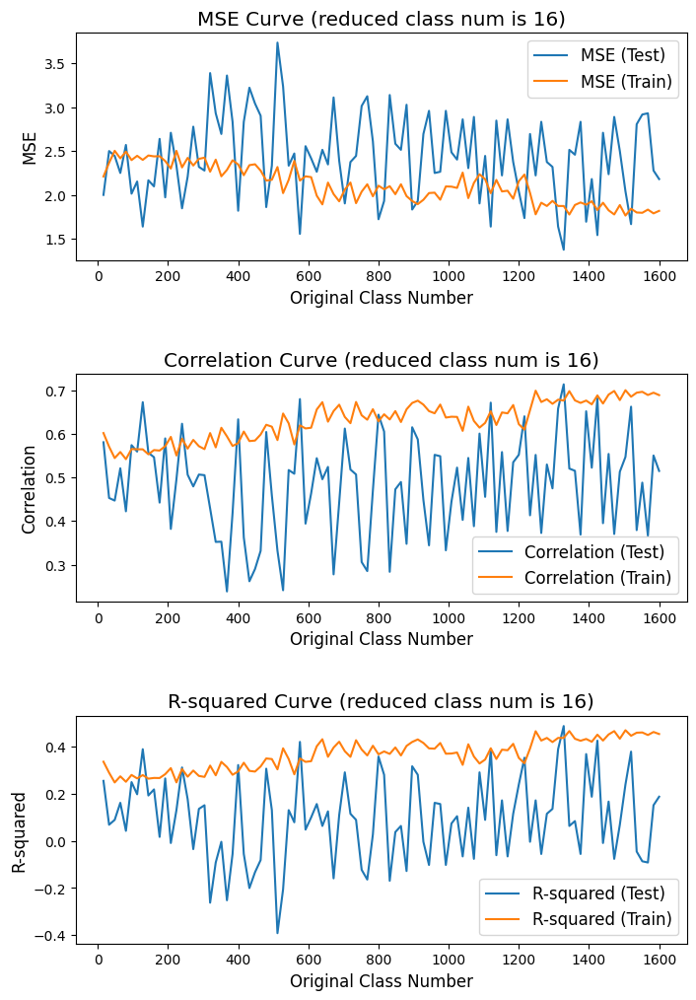

Max Index: 82
Max Original Class Num: 1328


In [ ]:
# plot the trend figures of mse, correlation, and r2

# Create a figure and subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(8, 12))

# Plot MSE
ax1.plot(class_num_array, mse_test_list, label='MSE (Test)')
ax1.plot(class_num_array, mse_train_list, label='MSE (Train)')
ax1.set_ylabel('MSE')
ax1.set_xlabel('Original Class Number')
ax1.set_title(f'MSE Curve (reduced class num is {reduced_class_num})')
ax1.legend()

# Plot Correlation
ax2.plot(class_num_array, correlation_test_list, label='Correlation (Test)')
ax2.plot(class_num_array, correlation_train_list, label='Correlation (Train)')
ax2.set_ylabel('Correlation')
ax2.set_xlabel('Original Class Number')
ax2.set_title(f'Correlation Curve (reduced class num is {reduced_class_num})')
ax2.legend()

# Plot R-squared
ax3.plot(class_num_array, r_squared_test_list, label='R-squared (Test)')
ax3.plot(class_num_array, r_squared_train_list, label='R-squared (Train)')
ax3.set_ylabel('R-squared')
ax3.set_xlabel('Original Class Number')
ax3.set_title(f'R-squared Curve (reduced class num is {reduced_class_num})')
ax3.legend()

# Increase the vertical spacing between subplots
plt.subplots_adjust(hspace=0.5)

# Adjust tick, label, title, and legend font sizes
plt.rcParams.update({'font.size': 12})
ax1.tick_params(labelsize=10)
ax2.tick_params(labelsize=10)
ax3.tick_params(labelsize=10)

# Save the figure
plt.savefig(f'mse_correlation_r2_trend_curve_reduced_eval_reduced_class_num_{reduced_class_num}.png', bbox_inches='tight')

# Show the figure
plt.show()

# Convert r_squared_test_list to a NumPy array
r_squared_test_array = np.array(r_squared_test_list)
# Find the index of the maximum value
max_index = np.argmax(r_squared_test_array)
# Get the corresponding class_num value
max_class_num = class_num_array[max_index]

# Print the index and corresponding class_num
print("Max Index:", max_index)
print("Max Original Class Num:", max_class_num)

In [ ]:
# calculate the mean value for the metrics in all situations
mse_test_array = np.array(mse_test_list)
r_squared_test_array = np.array(r_squared_test_list)
mse_train_array = np.array(mse_train_list)
r_squared_train_array = np.array(r_squared_train_list)
mse_test_mean = np.mean(mse_test_array)
r_squared_test_mean = np.mean(r_squared_test_array)
mse_train_mean = np.mean(mse_train_array)
r_squared_train_mean = np.mean(r_squared_train_array)

# Print the index and corresponding class_num
print("mean of mse test:", mse_test_mean)
print("mean of r2 score test:", r_squared_test_mean)
print("mean of mse train:", mse_train_mean)
print("mean of r2 score train:", r_squared_train_mean)


mean of mse test: 2.431944444444444
mean of r2 score test: 0.09405001437194593
mean of mse train: 2.1110526315789477
mean of r2 score train: 0.3660366371466698
